# MRP: Hopfield_v2.py
This is the complete HN create by the MRP


In [2]:
# Hopfield v2 -> all even modules
############################### DEPENDENCIES ##################################
import json
import os
import sys
import contextlib
import io
import numpy as np
import inspect
import os.path
import matplotlib.pyplot as plt
from math import pi, atan, sin, sqrt, tanh, cosh, exp, ceil
import seaborn as sns
from numpy.core.fromnumeric import shape
import random
import time
import math
from pathlib import Path


In [3]:
########################## LOCAL DEPENDENCIES #################################

#filename = inspect.getframeinfo(inspect.currentframe()).filename
#file_path = os.path.dirname(os.path.abspath(filename))
#project_root = os.path.dirname(file_path)

#if project_root not in sys.path:
#    sys.path.append(project_root)

#print(project_root)


In [4]:
module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)

print(module_path)

project_root = module_path

c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub


In [5]:


#project_root = os.path.dirname(r"C:\Users\aurel\Documents\Maastricht University\Thesis\Last code MRP")

if project_root not in sys.path:
    sys.path.append(project_root)
from event_model import event_model as em
from validator import validator_lite as vl
import data_analysis.event_generator as eg
from visual.color_map import Colormap



In [6]:
########################### GLOBAL VARIABLES ##################################


########################### CONTEXTS ##################################
@contextlib.contextmanager
def nostdout():
    save_stdout = sys.stdout
    sys.stdout = io.BytesIO()
    yield
    sys.stdout = save_stdout


In [7]:
########################### HELPER FUNCTIONS ##################################
def get_polar_coordinates(x, y):
    r = math.sqrt(x ** 2 + y ** 2)
    phi = math.atan2(x, y)
    if phi < 0:
        phi = math.pi - phi
    return r, phi


In [8]:
############################### BODY ##########################################
class Hopfield:
    def __init__(self, modules: list, parameters: dict, tracks: list = None):
        # set self variables, such as the maximum size
        self.p = parameters
        self.m = modules
        self.start_T = self.p["T"]
        self.start_B = self.p["B"]
        self.N = None
        self.N_info = None
        self.modules_count = len(modules)
        self.hit_counts = [len(module.hits()) for module in self.m]
        self.neuron_count = [
            self.hit_counts[i] * self.hit_counts[i + 1]
            for i in range(self.modules_count - 1)
        ]
        self.flips = 0
        self.max_neurons = max(self.neuron_count)
        self.init_neurons(tracks=tracks)
        self.init_weights()
        self.extracted_hits = set()
        self.extracted_tracks = []
        self.extracted_track_states = []
        self.energies = []

    def init_neurons(self, tracks: list = None):
        # consider hits in 2 modules as one neuron layer
        # the neurons in N are ordered h(1,1)-h(2,1); h(1,1)-h(2,2); h(1,1)-h(2,3) etc
        if self.p["random_neuron_init"]:
            self.N = np.random.uniform(size=(self.modules_count - 1, self.max_neurons))
        else:
            self.N = np.ones(shape=(self.modules_count - 1, self.max_neurons))
        if tracks:
            self.N = np.zeros(shape=(self.modules_count - 1, self.max_neurons))
        for idx, nc in enumerate(self.neuron_count):
            self.N[idx, nc:] = 0
        self.N_info = np.zeros(shape=(self.modules_count - 1, self.max_neurons, 4))
        for idx in range(self.modules_count - 1):
            m1 = self.m[idx]
            m2 = self.m[idx + 1]

            for i, hit1 in enumerate(m1.hits()):
                for j, hit2 in enumerate(m2.hits()):
                    n_idx = i * self.hit_counts[idx + 1] + j
                    if tracks:
                        for t in tracks:
                            if hit1 in t and hit2 in t:
                                self.N[idx, n_idx] = 1
                    # maybe we can check these angles again
                    angle_xz = atan((hit2.x - hit1.x) / (hit2.z - hit1.z))
                    angle_yz = atan((hit2.y - hit1.y) / (hit2.z - hit1.z))
                    norm_dist = sqrt(
                        (hit2.y - hit1.y) ** 2 + (hit2.x - hit1.x) ** 2
                    ) / sqrt(
                        (hit2.z - hit1.z) ** 2
                    )  # does not work!!!

                    _, r_hit1 = get_polar_coordinates(hit1.x, hit1.y)
                    _, r_hit2 = get_polar_coordinates(hit2.x, hit2.y)
                    monotone_dist = (r_hit2 - r_hit1) / (hit2.z - hit1.z)

                    self.N_info[idx, n_idx, 0] = abs(angle_xz)
                    self.N_info[idx, n_idx, 1] = abs(angle_yz)
                    self.N_info[idx, n_idx, 2] = norm_dist  # not robust!!!!
                    self.N_info[idx, n_idx, 3] = monotone_dist

    def init_weights(self, neg_weights=False):
        #### get params from the dict #######
        alpha = self.p["ALPHA"]
        beta = self.p["BETA"]
        gamma = self.p["GAMMA"]
        #####################################
        self.W = np.zeros(
            shape=(self.modules_count - 2, self.max_neurons, self.max_neurons,)
        )

        # loops neuron_layer - neuron_layer weight matrices
        for w_idx in range(self.modules_count - 2):
            # loops hits of the module connecting the neuron layers
            for con_idx in range(self.hit_counts[w_idx + 1]):  # m2
                for i in range(self.hit_counts[w_idx]):  # m1
                    ln_idx = i * self.hit_counts[w_idx + 1] + con_idx  # left_neuron_idx
                    for j in range(self.hit_counts[w_idx + 2]):  # m3
                        rn_idx = (
                            con_idx * self.hit_counts[w_idx + 2] + j
                        )  # right_neuron_idx

                        # Constant term from the other group
                        constant = (
                            self.N_info[w_idx, ln_idx, 2]
                            - self.N_info[w_idx + 1, rn_idx, 2]
                        )
                        constant = tanh(constant) * (
                            self.p["narrowness"] + 1
                        )  # tanh to force between -1 and 1
                        constant = (
                            -2 * constant ** 2
                        ) + 1  # this should be high if both terms are similar and low/penalizing if both are not similar
                        constant = constant * self.p["constant_factor"]
                        constant = min(
                            max(constant, -self.p["constant_factor"]),
                            self.p["constant_factor"],
                        )

                        # monotone constant
                        monotone_constant = (
                            self.N_info[w_idx, ln_idx, 3]
                            - self.N_info[w_idx + 1, rn_idx, 3]
                        )
                        monotone_constant = tanh(monotone_constant) * (
                            self.p["narrowness"] + 1
                        )  # tanh to force between -1 and 1

                        monotone_constant = (
                            -2 * monotone_constant ** 2
                        ) + 1  # this should be high if both terms are similar and low/penalizing if both are not similar

                        monotone_constant = (
                            monotone_constant * self.p["monotone_constant_factor"]
                        )
                        monotone_constant = min(
                            max(monotone_constant, -self.p["monotone_constant_factor"]),
                            self.p["monotone_constant_factor"],
                        )

                        theta = abs(
                            self.N_info[w_idx, ln_idx, 0]
                            - self.N_info[w_idx + 1, rn_idx, 0]
                        )
                        phi = abs(
                            self.N_info[w_idx, ln_idx, 1]
                            - self.N_info[w_idx + 1, rn_idx, 1]
                        )

                        self.W[w_idx, ln_idx, rn_idx] = (
                            alpha
                            * ((1 - sin(theta)) ** beta)
                            * ((1 - sin(phi)) ** gamma)
                            + monotone_constant
                            + constant
                        )
                        #    + constant # this does not work properly

                        if not neg_weights:
                            self.W[w_idx, ln_idx, rn_idx] = max(
                                0, self.W[w_idx, ln_idx, rn_idx]
                            )

                        # maybe we can play a bit around with this

    def update(self):
        # I think here we need to look at the first neurons,
        # then all the neurons in between as they are dependent on two other layers of neurons
        # then the last layer of the neurons as they only dep on one side
        update_list = []
        for idx in range(self.modules_count - 1):
            c1 = self.hit_counts[idx]
            c2 = self.hit_counts[idx + 1]
            for i in range(c1 * c2):
                update_list.append((idx, i))

        if self.p["randomized_updates"]:
            random.shuffle(update_list)

        if self.p["fully_randomized_updates"]:
            for c in range(len(update_list)):
                idx, i = random.sample(update_list, 1)[0]
                self.update_neuron(idx, i)

        else:
            for idx, i in update_list:
                self.update_neuron(idx, i)

    def update_neuron(self, idx, i):
        b = self.p["B"]
        t = self.p["T"]
        c1 = self.hit_counts[idx]
        c2 = self.hit_counts[idx + 1]
        update = 0
        if idx > 0:
            update += self.N[idx - 1, :].T @ self.W[idx - 1, :, i]
        if idx < self.modules_count - 2:
            update += self.W[idx, i, :] @ self.N[idx + 1, :]
        if 0 < idx < self.modules_count - 1:
            update /= 2
        # left module and right module hit id -> current neuron connects hit lm_id with hit rn_id
        lm_id = i // c2
        rm_id = i % c2
        # there can be a lot improved runtime wise with storing the sums and adj
        # but too complicated for now
        # all segments mapping to the hit in m1 -> the left module
        m1h = np.sum(self.N[idx, lm_id * c2 : (lm_id + 1) * c2])
        # all segments mapping to the hit in m2 - the right module
        m2h = np.sum(
            self.N[idx, : c1 * c2].reshape(c2, c1)[rm_id, :]
        )  # correct as well...
        # we need to subtract the neuron of the segment 2 times because we add it 2 times
        pen = m1h + m2h - 2 * self.N[idx, i]
        _update = 0.5 * (1 + tanh(update / t - b * pen / t))

        if self.p["binary_states"]:
            # XXX some threshold... -> we dont use bina
            if random.random() < _update:
                self.N[idx, i] = 1
            else:
                self.N[idx, i] = 0
        else:
            self.N[idx, i] = _update

    def energy(self):
        b = self.p["B"]

        E = 0
        bifurc_pen = 0
        for idx in range(self.modules_count - 2):
            c1 = self.hit_counts[idx]
            c2 = self.hit_counts[idx + 1]
            c3 = self.hit_counts[idx + 2]

            # XXX: just realised we are counting most penalties too often!! -> fixed
            f1 = 0.5
            f2 = 0.5
            if idx == 0:
                f1 = 1
            if idx == self.modules_count - 3:
                f2 = 1
            N1_pen = self.N[idx, : c1 * c2].reshape(c2, c1)
            N2_pen = self.N[idx + 1, : c2 * c3].reshape(c2, c3)
            bifurc_pen = (
                np.sum(np.trace(N1_pen @ N1_pen.T)) * f1
                + np.sum(np.trace(N2_pen @ N2_pen.T)) * f2
                - np.sum(self.N[idx, :] * self.N[idx, :]) * f1
                - np.sum(self.N[idx + 1, :] * self.N[idx + 1, :]) * f2
            )

            E += (
                -0.5 * (self.N[idx, :].T @ self.W[idx, :, :] @ self.N[idx + 1, :])
                + b * bifurc_pen
            )
        return E

    def converge(self):
        # Basically keep updating until the difference in Energy between timesteps is lower than 0.0005 (Based on Stimfple-Abele)
        # Passaleva uses a different kind of convergence i think (4)
        self.energies = [
            self.energy()
        ]  # store all energies (not fastest but maybe nice for visualisations)
        t = 0  # timesteps
        self.p["T"] = self.start_T
        # self.p["B"] = self.start_B
        # print(f"N at iteration{t}:", np.round(my_instance.N, 1))
        self.update()
        t += 1
        self.energies.append(self.energy())
        while (
            abs(abs(self.energies[-2]) - abs(self.energies[-1]))
            >= self.p["convergence_threshold"]
        ):
            self.update()
            self.energies.append(self.energy())
            # print(f"N at iteration{t}:", np.round(my_instance.N, 1))
            t += 1
            if not self.p["decay_off"]:
                self.p["T"] = self.p["T_decay"](self.p["T"])
                self.p["B"] = self.p["B_decay"](t)
            else:
                pass  # keep T and B fixed

        # print("Network Converged after " + str(t) + " steps")
        # print("Energy = " + str(self.energies[-1]))
        return self.N, self.energies[-1], t

    def bootstrap_converge(self, bootstraps=50, method="mean"):
        start_time = time.time()
        states_list = []
        energy_list = []
        iter_list = []
        for i in range(bootstraps):

            if self.p["random_neuron_init"]:
                # We only need to reinitialize if we randomly initialize
                self.init_neurons()

            states, energy, iters = self.converge()
            print("energy: " + str(energy))

            states_list.append(states)
            energy_list.append(energy)
            iter_list.append(iters)
            # print(f"Finished {i+1}/{bootstraps} iterations")

        if method == "minimum":
            # XXX: eventually we could take the lowest 20% or so
            self.N = states_list[np.argmax(energy_list)]
            energy_list = [np.amax(energy_list)]
        elif method == "below_median":
            median = np.median(energy_list)
            _tmp_states = []
            for states, e in zip(states_list, energy_list):
                if e <= median:
                    _tmp_states.append(states)
            _tmp_states = np.stack(_tmp_states, axis=2)
            self.N = np.mean(_tmp_states, axis=2)
        elif method == "below_mean":
            mean = np.mean(energy_list)
            _tmp_states = []
            for states, e in zip(states_list, energy_list):
                if e <= mean:
                    _tmp_states.append(states)
            _tmp_states = np.stack(_tmp_states, axis=2)
            self.N = np.mean(_tmp_states, axis=2)
        else:
            stacked_states = np.stack(states_list, axis=2)
            self.N = np.mean(stacked_states, axis=2)

        end_time = time.time() - start_time
        print(
            "[HOPFIELD] converged network by %s after %i mins %.2f seconds; (energy: %.2f)"
            % (method, end_time // 60, end_time % 60, np.mean(energy_list))
        )
        return sum(iter_list) / len(iter_list)

    def tracks(self):
        # What the papers say:  The answer is given by the final set of active Neurons
        #                       All sets of Neurons connected together are considered as track candidates
        #
        # IDEA: All neurons that share a hit and are both connected are track candidates
        global_candidates = []
        global_candidate_states = []

        for idx in range(self.modules_count - 2):
            candidates = []
            candidate_states = []
            l1 = self.hit_counts[idx]  # number of hits in module 1
            l2 = self.hit_counts[idx + 1]
            l3 = self.hit_counts[idx + 2]

            if self.p["maxActivation"]:
                candidates = []
                thresh = self.p["THRESHOLD"]

                n1_transform = self.N[idx, : l2 * l1].reshape(l1, l2).T.copy()
                n2_transform = self.N[idx + 1, : l3 * l2].reshape(l2, l3).T.copy()

                for con in range(l2):  # loop over the connection hits in module 2
                    # XXX i try swapping these....
                    h1_idx = np.argmax(n1_transform[con, :])
                    h3_idx = np.argmax(n2_transform[:, con])

                    if (
                        n1_transform[con, h1_idx] < thresh
                        or n2_transform[h3_idx, con] < thresh
                    ):
                        continue

                    hit1 = self.m[idx].hits()[h1_idx]
                    hit2 = self.m[idx + 1].hits()[con]
                    hit3 = self.m[idx + 2].hits()[h3_idx]
                    candidates.append(em.track([hit1, hit2, hit3]))
                    self.extracted_hits.add(hit1)
                    self.extracted_hits.add(hit2)
                    self.extracted_hits.add(hit3)
                    # if we get the same state
                    candidate_states.append(n1_transform[con, h1_idx])
                    candidate_states.append(n2_transform[h3_idx, con])

                    # XXX
                    # this prevents the display of bifurcation?!
                    # n1_transform[
                    #    :, h1_idx
                    # ] = 0  # set this hit to 0 so it's not chosen again
                    # n2_transform[h3_idx, :] = 0

            global_candidates += candidates
            global_candidate_states += candidate_states

        self.extracted_tracks = global_candidates
        self.extracted_track_states = global_candidate_states

        return global_candidates

    def full_tracks(self):
        # this will deal with stange angles!!!
        # under the assumption that we removed bifuration completely
        # init this active tracks with all active neurons in layer 1! -> key is the right hit
        global_candidates = []
        global_candidate_states = []
        global_candidate_info = []
        tracks = {}

        for idx in range(self.modules_count - 1):
            tracks_2 = {}
            l1 = self.hit_counts[idx]  # number of hits in module 1 / L
            l2 = self.hit_counts[idx + 1]  # number of hits in module 2 / R

            tr = self.p["THRESHOLD"]
            for segment in range(l1 * l2):
                if self.N[idx, segment] < tr:
                    continue

                r_hit = self.m[idx + 1].hits()[segment % l2]
                l_hit = self.m[idx].hits()[segment // l2]

                if l_hit in tracks.keys():
                    (track, states, angle) = tracks[l_hit]

                    track = track + [r_hit]
                    states = states + [self.N[idx, segment]]
                    info = angle + [self.N_info[idx, segment, :]]
                    del tracks[l_hit]

                    self.extracted_hits.add(r_hit)
                    tracks_2[r_hit] = (track, states, info)

                else:
                    track = [l_hit, r_hit]
                    states = [self.N[idx, segment]]
                    info = [self.N_info[idx, segment, :]]

                    tracks_2[r_hit] = (track, states, info)
                    self.extracted_hits.add(r_hit)
                    self.extracted_hits.add(l_hit)

            for _, value in tracks.items():
                (track, states, info) = value
                global_candidates = global_candidates + [track]
                global_candidate_states = global_candidate_states + [states]
                global_candidate_info = global_candidate_info + [info]
            tracks = tracks_2

        for _, value in tracks.items():
            (track, states, info) = value
            global_candidates = global_candidates + [track]
            global_candidate_states = global_candidate_states + [states]
            global_candidate_info = global_candidate_info + [info]

        # here comes the function of 'pruning...' maybe i need to store more info for doing that!!!
        global_candidates = self.prune_tracks(global_candidates, global_candidate_info)

        global_candidates = [em.track(hits) for hits in global_candidates]
        self.extracted_tracks = global_candidates
        self.extracted_track_states = global_candidate_states

        return global_candidates

    # tr 0.1 seems decent for sum of info differences...
    # we could look more carully into a criterion for this on big instances but here is fine...
    # XXX: need to check that method properly again
    def prune_tracks(self, tracks, track_infos):
        tr = self.p["pruning_tr"]
        out_tracks = []
        for track, info in zip(tracks, track_infos):
            num_hits = len(track)
            if num_hits < 3:  # sorting out the tracks that are not relevant
                continue
            # only if len> 6 need to think about splitting!!!
            cand = [track[0], track[1]]
            cand_info = info[0]
            for idx in range(1, num_hits - 1):
                # if abs(cand_info[3] - info[idx][3]) < tr:
                if sum(abs(cand_info - info[idx])) < tr:
                    cand = cand + [track[idx + 1]]
                else:
                    if len(cand) > 2:
                        out_tracks = out_tracks + [cand]
                    cand = [track[idx], track[idx + 1]]
                cand_info = info[idx]

            if len(cand) > 2:
                out_tracks = out_tracks + [cand]
        return out_tracks

    def mark_bifurcation(self):
        zero = True
        max_activation = self.p["max_activation"]
        smart = self.p["smart"]
        if max_activation:
            zero = False
        if smart:
            zero = False
            max_activation = False

        tr = self.p["THRESHOLD"]
        self.N[self.N <= tr] = 0

        # search for bifurcation neurons
        for idx in range(self.modules_count - 1):
            # so basically we visit all neurons in one layer and check for neurons where the activation is bigger than tr
            # then we check all adjacent neurons for activation and check how many are higher than the treshold
            # for each segment we look wether there is bifurcation on the left or right hit
            c1 = self.hit_counts[idx]
            c2 = self.hit_counts[idx + 1]

            for segment in range(c1 * c2):
                if self.N[idx, segment] < tr:
                    continue
                r_hit = segment % c2
                l_hit = segment // c2

                # left-right bifurction
                activation_mask = self.N[idx, : c1 * c2].reshape(c1, c2)[:, r_hit] > tr
                if sum(activation_mask) > 1:  # we have bifuct into the right hit
                    affected_neurons = []
                    for i in range(c1):  # loop over all nerons affected by bifurc
                        if activation_mask[i]:
                            # well here are the bifurcation things detected. here we would need to come up with a smart way to resolve it
                            if zero:
                                self.N[idx, (i * c2) + r_hit] = 0
                            else:
                                affected_neurons = affected_neurons + [(i * c2) + r_hit]
                    if smart:
                        # simple rule -> when bifurc is detected on right side -> we look next active neurons going out
                        # and promote the ones where the weight is high... (angle diff is low)
                        # if next neuron layer exist!!!
                        if idx < self.modules_count - 2:  # can check to the right
                            c3 = self.hit_counts[idx + 2]
                            activation_mask_2 = (
                                self.N[idx + 1, : c2 * c3].reshape(c2, c3)[r_hit, :]
                                > tr
                            )
                            affected_neurons_2 = []
                            for i in range(
                                c3
                            ):  # loop over all nerons affected by bifurc
                                if activation_mask_2[i]:
                                    affected_neurons_2 = affected_neurons_2 + [
                                        c3 * r_hit + i
                                    ]
                            if len(affected_neurons_2) > 0:
                                max_val = 0
                                max_l = None
                                max_r = None
                                for e in affected_neurons:
                                    for j in affected_neurons_2:
                                        c = (
                                            self.N[idx, e]
                                            * self.W[idx, e, j]
                                            * self.N[idx + 1, j]
                                        )
                                        if self.p["only_weight"]:
                                            c = self.W[idx, e, j]
                                        if c > max_val:
                                            max_l = e
                                            max_r = j
                                            max_val = c
                                    self.N[idx, e] = 0
                                for j in affected_neurons_2:
                                    self.N[idx + 1, j] = 0
                                if max_r is not None and max_l is not None:
                                    self.N[idx, max_l] = 1
                                    self.N[idx + 1, max_r] = 1
                            else:
                                max_activation = True
                        else:
                            max_activation = True

                    if max_activation:
                        max_activation = self.N[idx, affected_neurons[0]]
                        max_id = affected_neurons[0]
                        for e in affected_neurons:
                            if self.N[idx, e] >= max_activation:
                                max_id = e
                                max_activation = self.N[idx, e]

                            self.N[idx, e] = 0

                        self.N[idx, max_id] = 1
                    if smart:
                        max_activation = False

                # right-left bifurcation
                activation_mask = self.N[idx, : c1 * c2].reshape(c1, c2)[l_hit, :] > tr
                if sum(activation_mask) > 1:
                    affected_neurons = []
                    affected_neurons_2 = []
                    for i in range(c2):
                        if activation_mask[i]:
                            if zero:
                                self.N[idx, (l_hit * c2) + i] = 0
                            else:
                                affected_neurons = affected_neurons + [(l_hit * c2) + i]
                    if smart:  # i know there can be only one neuron on the right.
                        if idx > 0:
                            # can check here only for the first active neuron, because we removed
                            # the other bifurcation in the previous iteration
                            c0 = self.hit_counts[idx - 1]
                            activation_mask_2 = (
                                self.N[idx - 1, : c0 * c1].reshape(c0, c1)[:, l_hit]
                                > tr
                            )
                            if sum(activation_mask_2) > 0:
                                for i in range(
                                    c0  # this was c0...
                                ):  # loop over all nerons affected by bifurc
                                    if activation_mask_2[i]:
                                        affected_neurons_2 = affected_neurons_2 + [
                                            c1 * i + l_hit
                                        ]

                                if len(affected_neurons_2) > 0:
                                    max_val = 0
                                    max_l = None
                                    max_r = None
                                    for e in affected_neurons_2:
                                        for j in affected_neurons:
                                            c = (
                                                self.N[idx - 1, e]
                                                * self.W[idx - 1, e, j]
                                                * self.N[idx, j]
                                            )
                                            if self.p["only_weight"]:
                                                c = self.W[idx - 1, e, j]
                                            if c > max_val:
                                                max_l = e
                                                max_r = j
                                                max_val = c
                                        self.N[idx - 1, e] = 0
                                for e in affected_neurons:
                                    self.N[idx, j] = 0
                                if max_r is not None and max_l is not None:
                                    self.N[idx - 1, max_l] = 1
                                    self.N[idx, max_r] = 1
                            else:
                                max_activation = True
                        else:
                            max_activation = True
                        pass

                    if max_activation:
                        # check to the left or max score
                        max_activation = self.N[idx, affected_neurons[0]]
                        max_id = affected_neurons[0]
                        for e in affected_neurons:
                            if self.N[idx, e] >= max_activation:
                                max_id = e
                                max_activation = self.N[idx, e]
                            self.N[idx, e] = 0
                        self.N[idx, max_id] = 1

        # converged, averaged neuron state
        # what do we want to do -> search all neurons wether there is bifurcation
        # how to search this, by the indices... and then we store it as a combination of hit id_s, and which side of this element the bifurcation occurs
        # bifiurcation is stored as a list of hit ids, with

    def show_all_tracks(self, threshold=None, show_states=False):
        # Creates a colormap from blue to red for small to large values respectively
        c_map = Colormap(0, 1, 2 / 3.0, 0)
        c = []
        tracks = []
        for idx in range(self.modules_count - 1):
            m1 = self.m[idx]
            m2 = self.m[idx + 1]

            for i, hit1 in enumerate(m1.hits()):
                for j, hit2 in enumerate(m2.hits()):
                    n_idx = i * self.hit_counts[idx + 1] + j
                    if threshold:
                        if self.N[idx, n_idx] >= threshold:
                            tracks.append(em.track([hit1, hit2]))
                            if show_states:
                                c.append(c_map.get_color_rgb(self.N[idx, n_idx]))
                        continue
                    if show_states:
                        c.append(c_map.get_color_rgb(self.N[idx, n_idx]))
                    tracks.append(em.track([hit1, hit2]))
        eg.plot_tracks_and_modules(tracks, self.m, colors=c)

    def tracks_with_hit(self, hit):
        return [track for track in self.extracted_tracks if hit in track.hits]

    def print_neurons(self):
        n = len(self.N)
        for i in range(n):
            m = int(sqrt(len(self.N[i])))
            for j in range(m):
                print(f"m{i+1}h{j+1}: {self.N[i, (j*m):((j+1)*m)]}")

    def plot_network_results(self, show_states=False):
        if show_states:
            # Creates a colormap from blue to red for small to large values respectively
            c_map = Colormap(0, 1, 2 / 3.0, 0)
            colors = []
            [colors.append(c_map.get_color_rgb(v)) for v in self.extracted_track_states]
            eg.plot_tracks_and_modules(
                self.extracted_tracks,
                self.m,
                colors=colors,
                title="Hopfield Output with states",
            )
        else:
            eg.plot_tracks_and_modules(
                self.extracted_tracks, self.m, title="Hopfield Output"
            )


In [9]:
def prepare_instance(
    even=True, num_modules=10, plot_events=False, num_tracks=3, save_to_file: str = None
):
    if num_modules > 26:
        num_modules = 26
    elif num_modules < 3 or type(num_modules) != int:
        num_modules = 3

    # Generating a test event to work with
    tracks = eg.generate_test_tracks(
        allowed_modules=[i * 2 for i in range(num_modules)],
        num_test_events=1,
        num_tracks=num_tracks,
        reconstructable_tracks=True,
    )[0]

    if save_to_file:
        eg.write_tracks(tracks, save_to_file)

    modules = eg.tracks_to_modules(tracks)
    if plot_events:
        eg.plot_tracks_and_modules(tracks, modules, title="Generated Instance")
    return modules, tracks


In [10]:
def load_instance(file_name, plot_events=False):
    tracks = eg.read_tracks(file_name)
    modules = eg.tracks_to_modules(tracks)
    if plot_events:
        eg.plot_tracks_and_modules(tracks, modules, title="Generated Instance")
    return modules, tracks

In [11]:
def load_event(file_name, plot_event=False):
    f = open(file_name)
    json_data_event = json.loads(f.read())

    ev = em.event(json_data_event, read_tracks=True)

    modules = ev.modules
    tracks = ev.real_tracks

    if plot_event:
        eg.plot_tracks_and_modules(tracks, modules, title="Loaded Event")

    modules_even = []
    modules_odd = []

    for i in range(len(modules)):
        if i % 2 == 0:
            modules_even.append(modules[i])
        else:
            modules_odd.append(modules[i])

    return json_data_event, (modules_even, modules_odd)


In [12]:
def evaluate_events(file_name, parameters, nr_events=1, plot_event=False, output_file=None):

    json_data_all_events = []
    all_tracks = []
    iter_even = 1
    iter_odd = 1

    all_events = [i for i in range(995)]
    random.seed(40)
    random.shuffle(all_events)
    count = 0
    j = 0
    
    while count < nr_events:
        i = all_events[j]
        j += 1
        print("[INFO] Evaluate Event: %s" % file_name + str(i))
        size = os.path.getsize(file_name + str(i) + ".json")
        json_data_event, modules = load_event(
            file_name + str(i) + ".json", plot_event=False
        )
        max_neurons = 0
        last = 0
        for m in modules[0]:
            n_hits = len(m.hits())
            if last * n_hits > max_neurons:
                max_neurons = last * n_hits
            last = n_hits
        last = 0
        for m in modules[1]:
            n_hits = len(m.hits())
            if last * n_hits > max_neurons:
                max_neurons = last * n_hits
            last = n_hits
        if max_neurons > 2200:
            continue

        print(f"\nstarting instance {count} out of {nr_events}\n")
        start_time = time.time()
        even_hopfield = Hopfield(modules=modules[0], parameters=parameters)
        odd_hopfield = Hopfield(modules=modules[1], parameters=parameters)
        end_time = time.time() - start_time
        print(
            "[INFO] Hopfield Networks initialized in %i mins %.2f seconds"
            % (end_time // 60, end_time % 60)
        )

        try:
            iter_even = even_hopfield.bootstrap_converge(
                bootstraps=parameters["bootstrap_iters"],
                method=parameters["bootstrap_method"],
            )
            iter_odd = odd_hopfield.bootstrap_converge(
                bootstraps=parameters["bootstrap_iters"],
                method=parameters["bootstrap_method"],
            )

            start_time = time.time()
            even_hopfield.mark_bifurcation()
            odd_hopfield.mark_bifurcation()
            even_tracks = even_hopfield.full_tracks()
            odd_tracks = odd_hopfield.full_tracks()
            event_tracks = even_tracks + odd_tracks
            end_time = time.time() - start_time
            print(
                "[INFO] tracks extracted in %i mins %.2f seconds"
                % (end_time // 60, end_time % 60)
            )

            json_data_all_events.append(json_data_event)
            all_tracks.append(event_tracks)

            if plot_event:
                even_hopfield.plot_network_results()
                odd_hopfield.plot_network_results()

            count = count + 1
        except:
            continue

    start_time = time.time()
    if output_file:
        print(output_file)
        sys.stdout = open(output_file, "a")
        print(f"Average number of iterations per convergence: {(iter_even+iter_odd)/2}")
        vl.validate_print(json_data_all_events, all_tracks, return_data=True)
        print("____________________")
        sys.stdout.close()
        sys.stdout = sys.__stdout__
    end_time = time.time() - start_time

    # we could check how many tracks acutally cross the detector sides i guess to identify where some clones come from...
    print(
        "[INFO] validation excecuted in %i mins %.2f seconds"
        % (end_time // 60, end_time % 60)
    )



In [13]:
def mse(network, tracks):
    true_network = Hopfield(modules=network.m, parameters=network.p, tracks=tracks)
    return ((network.N - true_network.N) ** 2).mean(axis=None)

In [14]:
def save_experiment(exp_name, exp_num, desc, p, event_file_name, nr_events):
    f = open(project_root + "/algorithms/experiments/" + exp_name + ".txt", "a")
    f.write(
        f"\n Experiment {exp_num}\n\n{desc}\nNumber of events: {nr_events}\nParameters: {p}\n"
    )
    f.close()
    
    evaluate_events(
        project_root + event_file_name,
        p,
        nr_events,
        True,
        project_root + "/algorithms/experiments/" + exp_name + ".txt",
    )

    f = open(project_root + "/algorithms/experiments/" + exp_name + ".txt", "a")


In [15]:
if __name__ == "__main__":
    
    #################### PARAMETERS #######################
    parameters = {
        ### NEURONS ###
        "random_neuron_init": True,
        "binary_states": False,  # try it out once maybe but scrap it
        ### WEIGHTS ###
        "ALPHA": 1,
        "BETA": 10,
        "GAMMA": 10,
        "narrowness": 200,
        "constant_factor": 0.9,
        "monotone_constant_factor": 0.9,
        #### UPDATE ###
        "T": 1e-8,  # try to experiment with these rather
        "B": 1e-6,  # try to experiment with these rather
        "T_decay": lambda t: max(1e-8, t * 0.01),  # try to remove these
        "B_decay": lambda t: max(1e-4, t * 0.04),  # try to remove these
        "decay_off": False,  # using this
        "randomized_updates": True,
        "fully_randomized_updates": False,
        #### THRESHOLD ###
        "maxActivation": True,
        "THRESHOLD": 0.2,
        ##### CONVERGENCE ###
        "convergence_threshold": 0.00000005,
        "bootstrap_iters": 10,
        "bootstrap_method": "below_mean",
        ###### BIFURC REMOVAL #####
        "smart": True,
        "only_weight": False,
        "max_activation": False,
        ###### Track prunning #######
        # here we could set the threshold
        "pruning_tr": 0.05,
    }
  


[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_839

starting instance 0 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.70 seconds
energy: -329.3112586403127
energy: -234.9874670939477
energy: -293.81425309424856
energy: -207.24538411060357
energy: -260.1221884417173
energy: -302.37885538499756
energy: -278.950494545221
energy: -271.22036026214204
energy: -289.9727641337554
energy: -261.1961038642217
[HOPFIELD] converged network by below_mean after 0 mins 43.58 seconds; (energy: -272.92)
energy: -259.592656966386
energy: -223.9013580063027
energy: -255.32910739809125
energy: -241.68962896846782
energy: -240.0116847149514
energy: -243.06983446782579
energy: -215.88742112747624
energy: -227.40103176822134
energy: -247.15203822580338
energy: -236.79330128149286
[HOPFIELD] converged network by below_mean after 0 mins 16.78 seconds; (energy: -239.08)
[INFO] tracks extracted in 0 mins 0.04 seconds


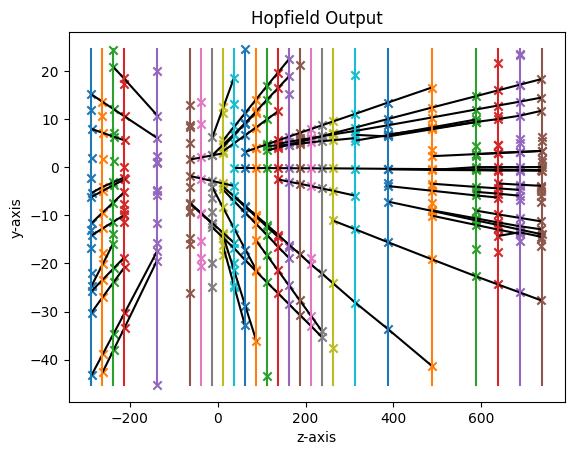

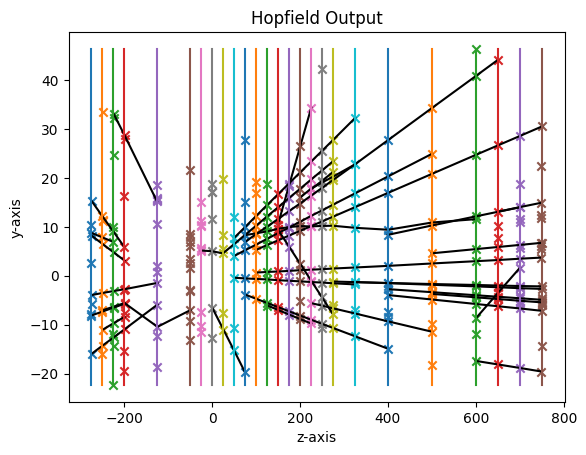

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_502

starting instance 1 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.71 seconds
energy: -274.94898192850707
energy: -268.60313017898426
energy: -269.70901333329857
energy: -245.66000373291865
energy: -242.4796568262941
energy: -253.56017856174606
energy: -314.52711309807944
energy: -241.74643019442152
energy: -269.7038304597624
energy: -261.0243249379273
[HOPFIELD] converged network by below_mean after 0 mins 26.23 seconds; (energy: -264.20)
energy: -170.36307129192045
energy: -184.95750123601795
energy: -173.9648311517684
energy: -177.26196893296168
energy: -186.50293692283233
energy: -181.2393493445763
energy: -171.63651753223863
energy: -173.3899231242471
energy: -183.2742129473028
energy: -182.15184065165158
[HOPFIELD] converged network by below_mean after 0 mins 15.12 seconds; (energy: -178.47)
[INFO] tracks extracted in 0 mins 0.03 seconds


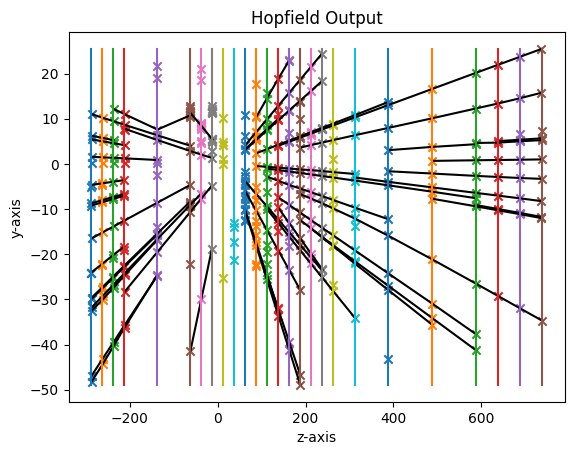

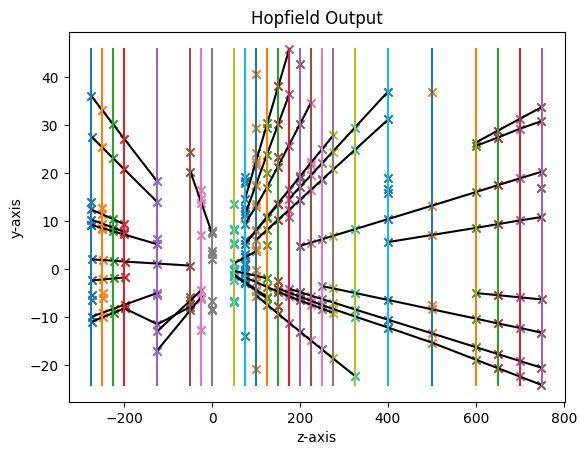

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_501

starting instance 2 out of 100

[INFO] Hopfield Networks initialized in 0 mins 3.47 seconds
energy: -370.8692723462161
energy: -351.2735593013384
energy: -378.92203014681604
energy: -312.7132547813573
energy: -406.8668047689957
energy: -289.1615044164224
energy: -372.31987125605224
energy: -309.36488818647683
energy: -425.30656491496535
energy: -329.43467738651987
[HOPFIELD] converged network by below_mean after 2 mins 42.16 seconds; (energy: -354.62)
energy: -390.3258831762488
energy: -406.97467104146847
energy: -409.44231390661344
energy: -371.5906164002892
energy: -395.397434905878
energy: -372.420730347028
energy: -411.2750428418736
energy: -428.4100273006931
energy: -398.44410942603645
energy: -433.4051235827877
[HOPFIELD] converged network by below_mean after 3 mins 17.16 seconds; (energy: -401.77)
[INFO] tracks extracted in 0 mins 0.10 seconds


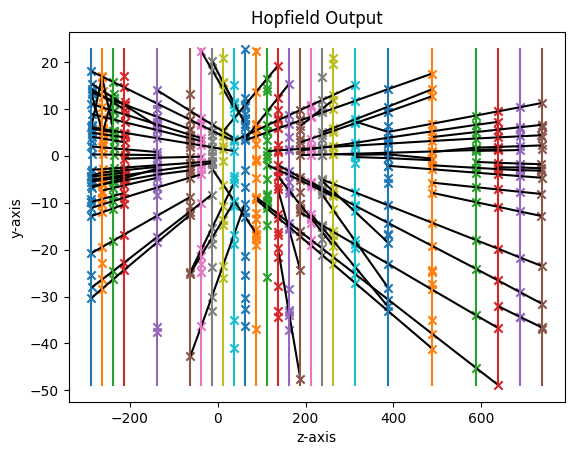

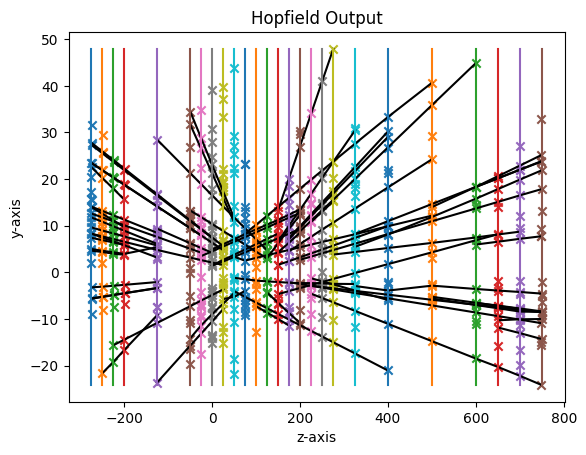

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_55

starting instance 3 out of 100

[INFO] Hopfield Networks initialized in 0 mins 6.46 seconds
energy: -516.4078878704172
energy: -467.86247345228384
energy: -516.6835832877637
energy: -517.9964732021595
energy: -554.128160407464
energy: -513.6957773392271
energy: -515.811279692161
energy: -493.7487106573487
energy: -507.1095644717479
energy: -519.4003509011094
[HOPFIELD] converged network by below_mean after 7 mins 54.68 seconds; (energy: -512.28)
energy: -324.72083369076046
energy: -446.57732975059537
energy: -391.5500830258848
energy: -343.8752939935156
energy: -423.49996274221525
energy: -446.7504914402259
energy: -424.3649752707798
energy: -339.46664339839845
energy: -386.7290141104667
energy: -410.7725606383388
[HOPFIELD] converged network by below_mean after 4 mins 35.99 seconds; (energy: -393.83)
[INFO] tracks extracted in 0 mins 0.16 seconds


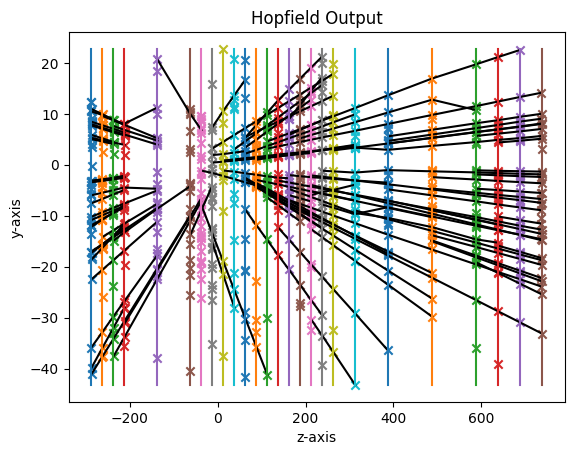

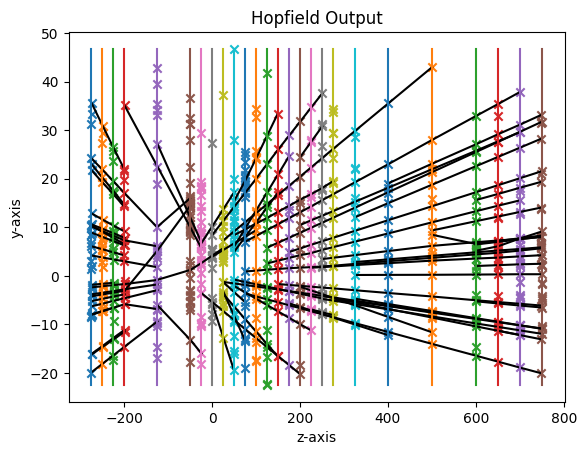

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_863

starting instance 4 out of 100

[INFO] Hopfield Networks initialized in 0 mins 4.46 seconds
energy: -443.37159268815117
energy: -422.8837616839632
energy: -437.94148249372086
energy: -408.5468834138869
energy: -378.2373808683371
energy: -361.1829597401182
energy: -355.83380377495837
energy: -393.40508836090595
energy: -402.8181711748058
energy: -429.69106446800924
[HOPFIELD] converged network by below_mean after 4 mins 11.41 seconds; (energy: -403.39)
energy: -397.03132909325524
energy: -455.1161634418806
energy: -390.04535312017157
energy: -430.1402705302261
energy: -412.2342530898119
energy: -468.14358622466943
energy: -499.1429157487496
energy: -410.51784108458384
energy: -418.91113011521077
energy: -393.54186535517766
[HOPFIELD] converged network by below_mean after 3 mins 13.50 seconds; (energy: -427.48)
[INFO] tracks extracted in 0 mins 0.12 seconds


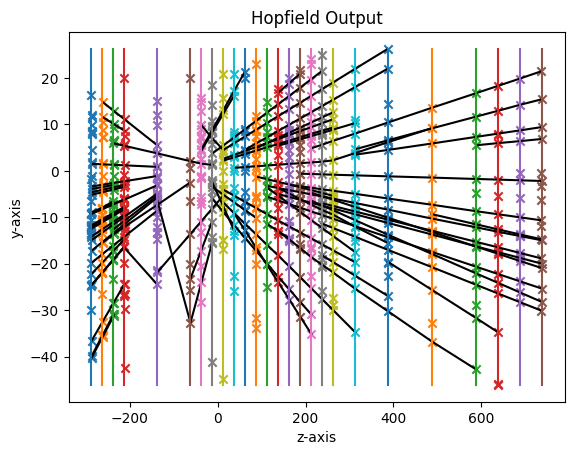

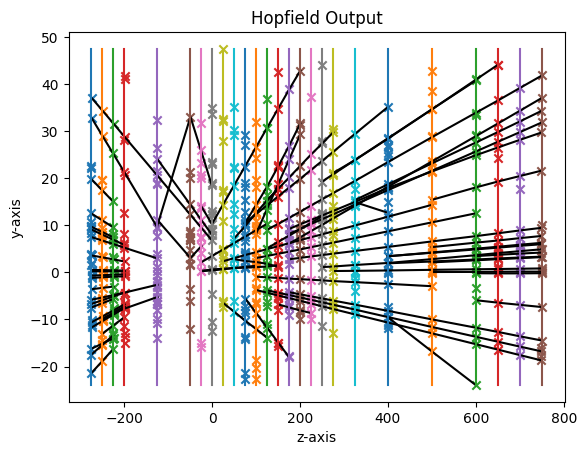

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_398

starting instance 5 out of 100

[INFO] Hopfield Networks initialized in 0 mins 6.85 seconds
energy: -521.6048766616522
energy: -489.6668817812623
energy: -489.14783414743476
energy: -433.32106567701584
energy: -416.9443631146084
energy: -450.7645481172037
energy: -494.7009749119996
energy: -538.5119710975117
energy: -468.8272760675217
energy: -446.94690272151354
[HOPFIELD] converged network by below_mean after 22 mins 39.17 seconds; (energy: -475.04)
energy: -412.84554785142416
energy: -392.0136018564673
energy: -390.5560838033505
energy: -363.8566318565234
energy: -373.8855280683397
energy: -512.2090280593682
energy: -394.9228680822908
energy: -430.5109049250503
energy: -393.0694266234835
energy: -491.5962015897578
[HOPFIELD] converged network by below_mean after 20 mins 18.59 seconds; (energy: -415.55)
[INFO] tracks extracted in 0 mins 0.48 seconds


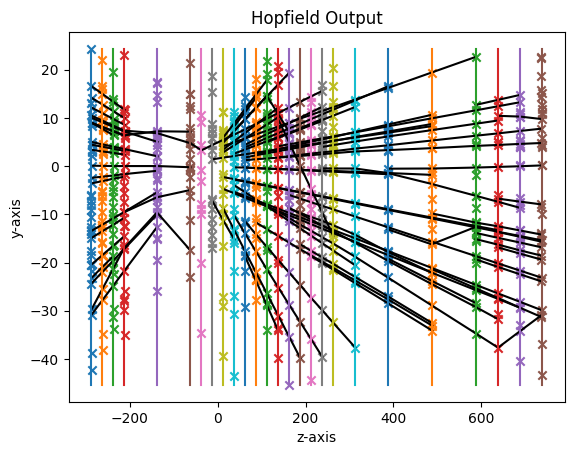

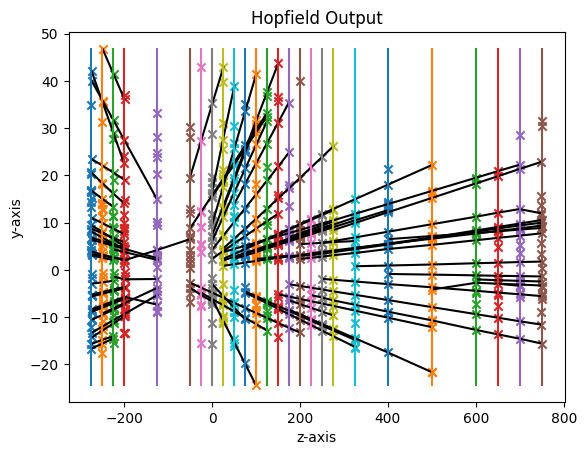

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_392
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_353
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_818
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_707
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_781
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_17

starting instance 6 out of 100

[INFO] Hopfield Networks initialized in 0 mins 14.12 seconds
energy: -486.7348644359556
energy: -476.7596384119725
energy: -478.89365410949307
energy: -520.43619388597
energy: -495.84868758690914
energy: -597.043

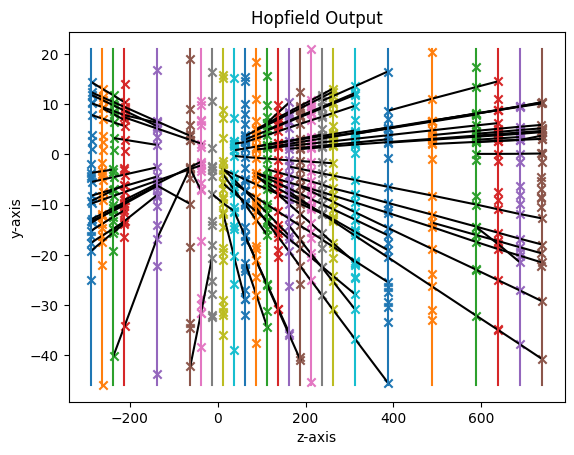

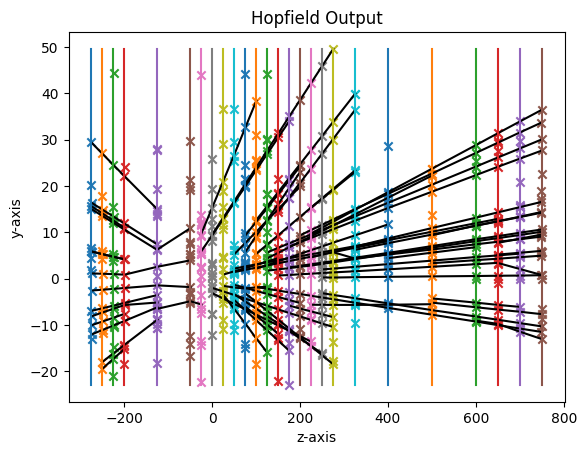

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_39

starting instance 7 out of 100

[INFO] Hopfield Networks initialized in 0 mins 1.26 seconds
energy: -144.2632153732626
energy: -160.74698856653734
energy: -147.72621371696957
energy: -164.39625645068884
energy: -149.93481396632384
energy: -166.85424927564668
energy: -145.82680294559844
energy: -157.24150495637397
energy: -169.6139381524197
energy: -134.49353984714165
[HOPFIELD] converged network by below_mean after 0 mins 33.34 seconds; (energy: -154.11)
energy: -157.62144964740068
energy: -152.51643353461424
energy: -162.61943194882923
energy: -158.06115459714138
energy: -133.73848950673965
energy: -155.77744387445688
energy: -159.80557854033714
energy: -147.91655898444307
energy: -132.3426367576593
energy: -161.37131020857373
[HOPFIELD] converged network by below_mean after 0 mins 18.37 seconds; (energy: -152.18)
[INFO] tracks extracted in 0 mins 0.14 seconds


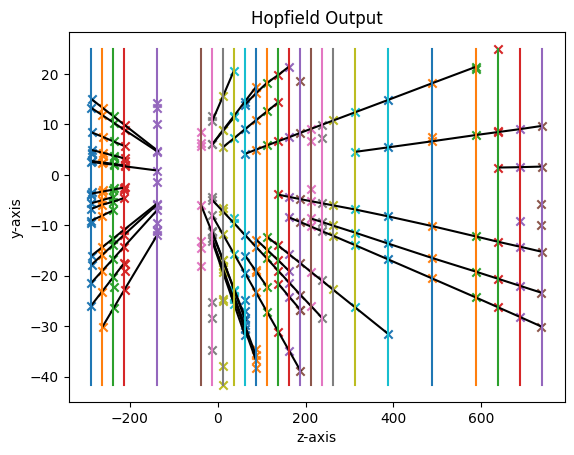

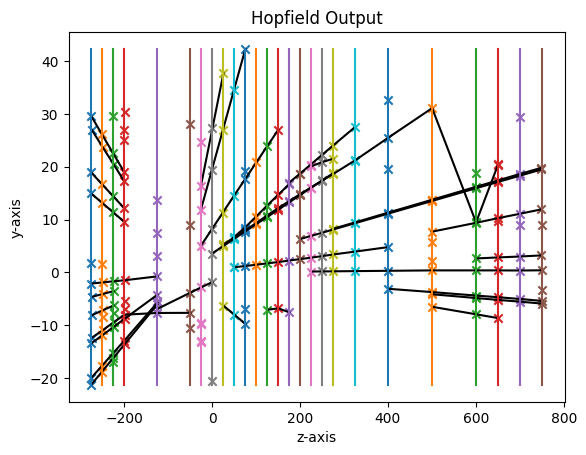

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_98

starting instance 8 out of 100

[INFO] Hopfield Networks initialized in 0 mins 2.47 seconds
energy: -244.0645563921393
energy: -233.49546575591495
energy: -250.7079279723005
energy: -230.45587731781893
energy: -253.19439232759237
energy: -256.6339195459654
energy: -258.5014336143416
energy: -248.79949541355046
energy: -234.83546448055088
energy: -248.63101805723556
[HOPFIELD] converged network by below_mean after 1 mins 17.18 seconds; (energy: -245.93)
energy: -314.7724891702181
energy: -315.14886045102185
energy: -341.01573325054807
energy: -344.72378485501804
energy: -327.86725642665573
energy: -298.24675841527255
energy: -293.4442837748836
energy: -249.7061261912385
energy: -327.678939552477
energy: -307.1688965518578
[HOPFIELD] converged network by below_mean after 2 mins 3.46 seconds; (energy: -311.98)
[INFO] tracks extracted in 0 mins 0.14 seconds


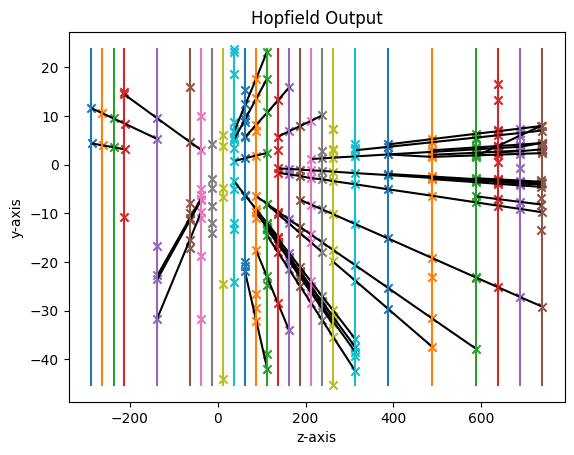

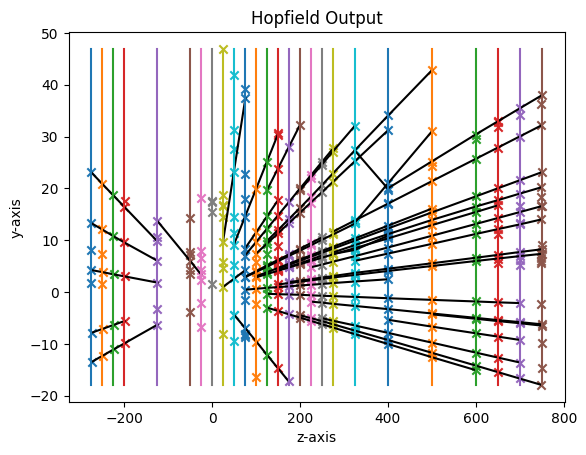

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_105
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_594
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_229
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_939
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_76
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_609

starting instance 9 out of 100

[INFO] Hopfield Networks initialized in 0 mins 21.11 seconds
energy: -439.61695982774665
energy: -473.37241401254414
energy: -508.38243346444506
energy: -468.5901188358807
energy: -486.9325341200285
energy: -452.

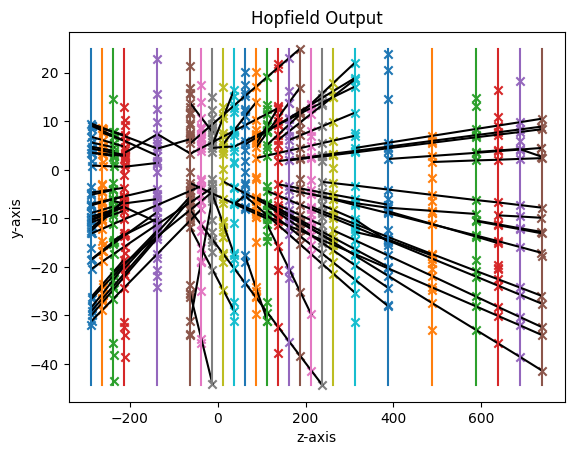

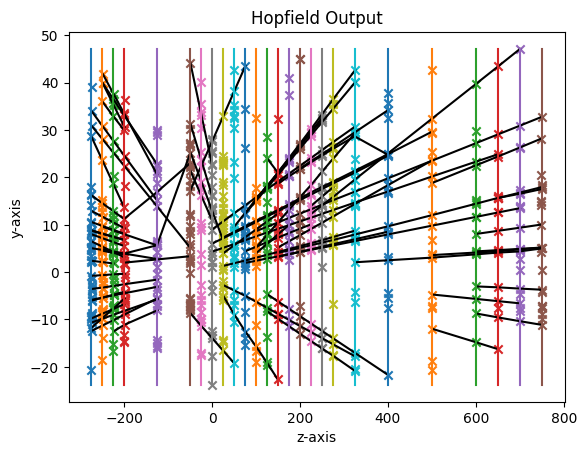

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_361
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_620

starting instance 10 out of 100

[INFO] Hopfield Networks initialized in 0 mins 3.15 seconds
energy: -280.5488139237346
energy: -267.8879552228541
energy: -259.9815228838668
energy: -267.41599833380883
energy: -261.92575263416506
energy: -270.4868489667075
energy: -273.2451766272044
energy: -250.11861510021782
energy: -295.36799021390715
energy: -285.4753759478692
[HOPFIELD] converged network by below_mean after 1 mins 4.97 seconds; (energy: -271.25)
energy: -390.88466257385375
energy: -401.574645187533
energy: -386.482794253404
energy: -447.85094333150835
energy: -404.80276311576046
energy: -425.14603888139123
energy: -322.00181449076734
energy: -423.7590345641272
energy: -387.68235923696176
energy: -367.9565007674869
[HOPFIELD] converg

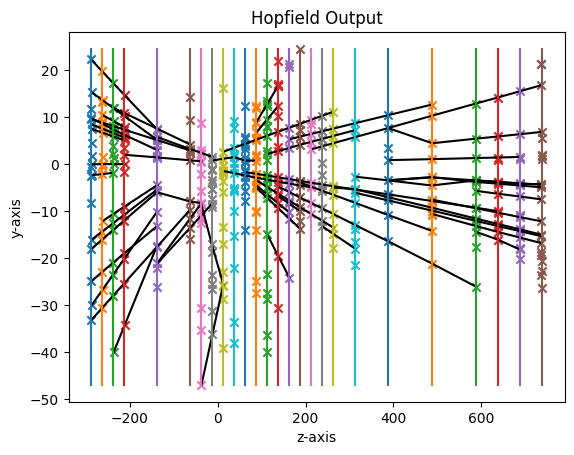

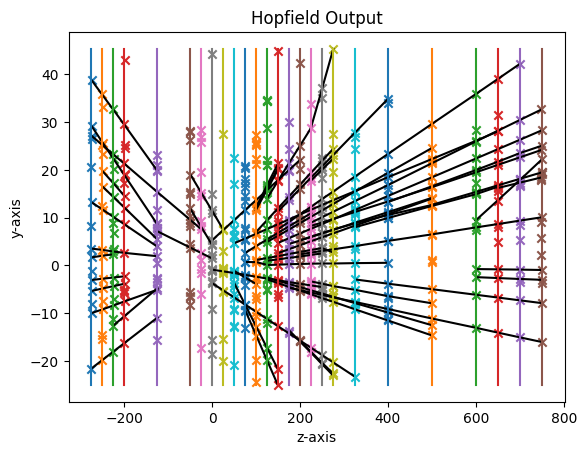

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_414

starting instance 11 out of 100

[INFO] Hopfield Networks initialized in 0 mins 6.24 seconds
energy: -362.6962484699358
energy: -443.1347488015791
energy: -342.50274172809384
energy: -378.6741709800328
energy: -342.1833305137241
energy: -377.17450611361926
energy: -385.28623433442885
energy: -387.8852964405957
energy: -422.10130932475704
energy: -370.1962604874617
[HOPFIELD] converged network by below_mean after 10 mins 31.67 seconds; (energy: -381.18)
energy: -366.0475597973887
energy: -377.2656922752315
energy: -424.1811571634526
energy: -351.28269184487436
energy: -362.9689463358964
energy: -394.63460369799316
energy: -345.41691809834487
energy: -397.69048110567735
energy: -401.0547355643404
energy: -417.2498081615786
[HOPFIELD] converged network by below_mean after 4 mins 31.02 seconds; (energy: -383.78)
[INFO] tracks extracted in 0 mins 0.17 seconds


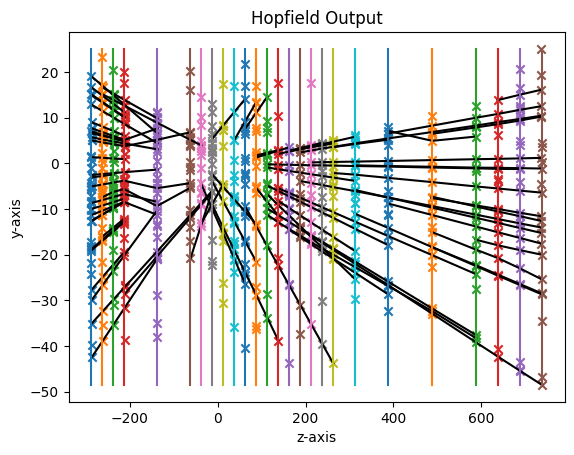

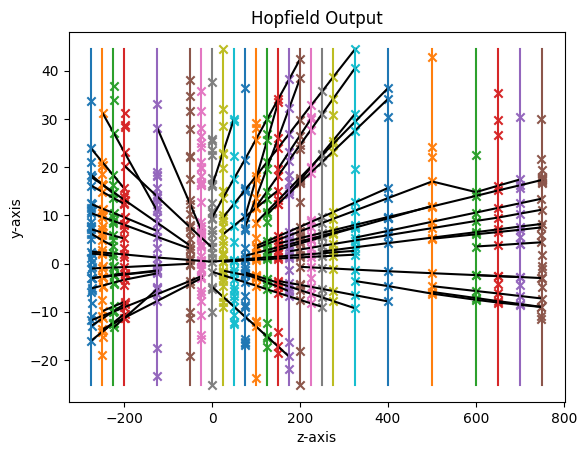

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_411

starting instance 12 out of 100

[INFO] Hopfield Networks initialized in 0 mins 10.06 seconds
energy: -471.495865122056
energy: -478.75404077280035
energy: -448.454659725051
energy: -388.7780081461445
energy: -470.69537279907667
energy: -430.3217204154994
energy: -441.9340726097745
energy: -451.25386421383934
energy: -433.452579699632
energy: -510.95611051119806
[HOPFIELD] converged network by below_mean after 9 mins 10.33 seconds; (energy: -452.61)
energy: -515.4641801104767
energy: -498.64513773874273
energy: -446.05187704522524
energy: -448.49658991557715
energy: -432.8584199833345
energy: -471.14906048340174
energy: -505.8981003458829
energy: -512.2074860853752
energy: -515.1908324612142
energy: -487.48044669584687
[HOPFIELD] converged network by below_mean after 12 mins 36.06 seconds; (energy: -483.34)
[INFO] tracks extracted in 0 mins 0.27 seconds


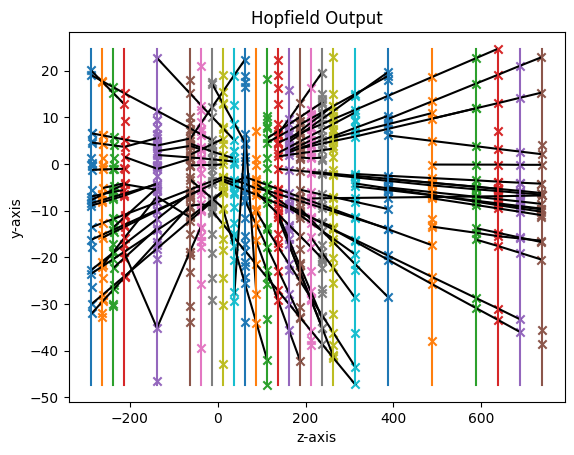

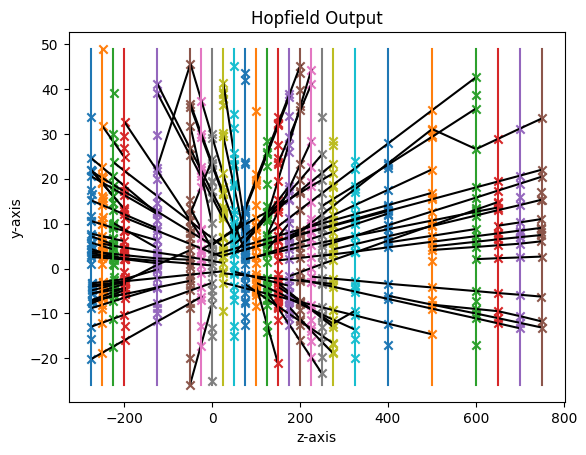

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_717
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_544

starting instance 13 out of 100

[INFO] Hopfield Networks initialized in 0 mins 3.20 seconds
energy: -344.4570855061008
energy: -360.3265218344796
energy: -405.80966607201174
energy: -331.84651347858943
energy: -391.7492805742561
energy: -380.4038488162544
energy: -323.293000881059
energy: -385.88532112436076
energy: -383.69664388459086
energy: -400.88892845284994
[HOPFIELD] converged network by below_mean after 2 mins 47.70 seconds; (energy: -370.84)
energy: -304.0705328635437
energy: -348.0756467635684
energy: -352.67973681738084
energy: -348.4501715373505
energy: -362.57746241778847
energy: -342.4408970157457
energy: -368.4809273306095
energy: -297.1424490715645
energy: -283.1802706292251
energy: -367.88969178176393
[HOPFIELD] converg

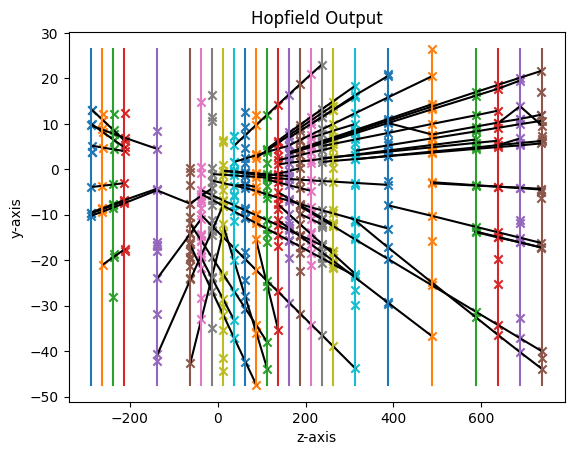

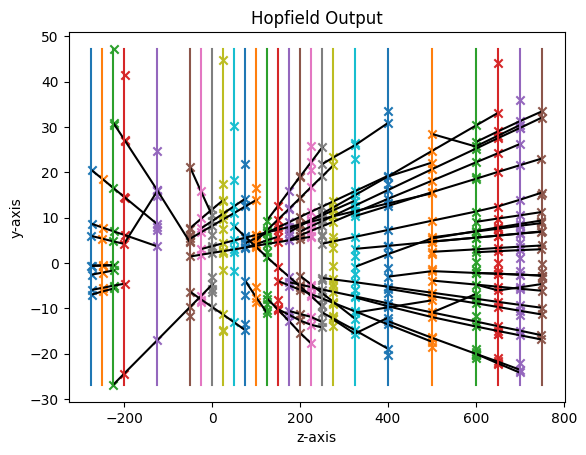

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_358
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_158
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_581

starting instance 14 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.91 seconds
energy: -324.40725789353235
energy: -350.85368515875774
energy: -330.3023904256139
energy: -339.4799219523286
energy: -338.98422682233183
energy: -335.3836222086837
energy: -325.1169540479667
energy: -338.0323628352673
energy: -336.4598701539059
energy: -351.4771864087504
[HOPFIELD] converged network by below_mean after 0 mins 25.61 seconds; (energy: -337.05)
energy: -202.3919414609946
energy: -204.19430094933278
energy: -197.30932618095352
energy: -191.85655311192747
energy: -235.99713578196702
energy: -224.85415339334796

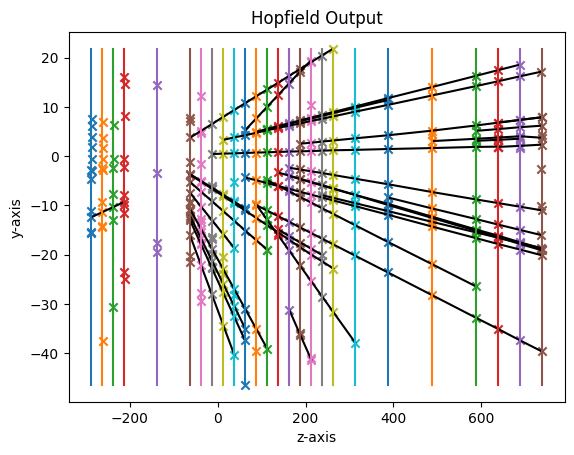

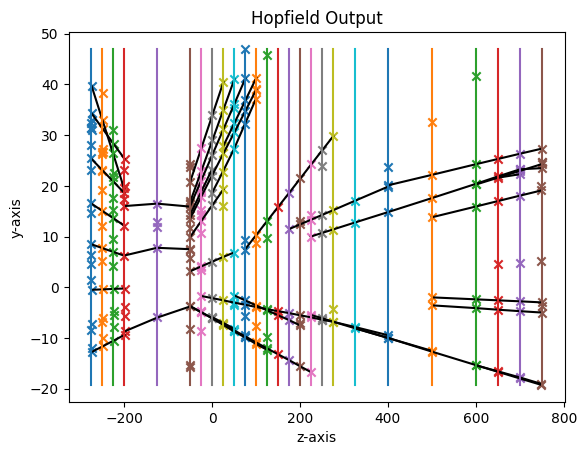

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_970

starting instance 15 out of 100

[INFO] Hopfield Networks initialized in 0 mins 8.10 seconds
energy: -425.85505706519194
energy: -357.1954189977356
energy: -437.0874874254773
energy: -401.2821934081771
energy: -433.0126892878027
energy: -385.4364107753754
energy: -396.4937206433592
energy: -392.3758538938238
energy: -368.7224435676855
energy: -429.0888249311897
[HOPFIELD] converged network by below_mean after 7 mins 32.17 seconds; (energy: -402.66)
energy: -485.53885887138057
energy: -469.3543029108914
energy: -483.7454635958143
energy: -524.8117383688059
energy: -436.0206943156525
energy: -412.5399923771638
energy: -498.3564522765848
energy: -444.7345091588579
energy: -464.13466372204795
energy: -478.3179456881986
[HOPFIELD] converged network by below_mean after 12 mins 11.81 seconds; (energy: -469.76)
[INFO] tracks extracted in 0 mins 0.25 seconds


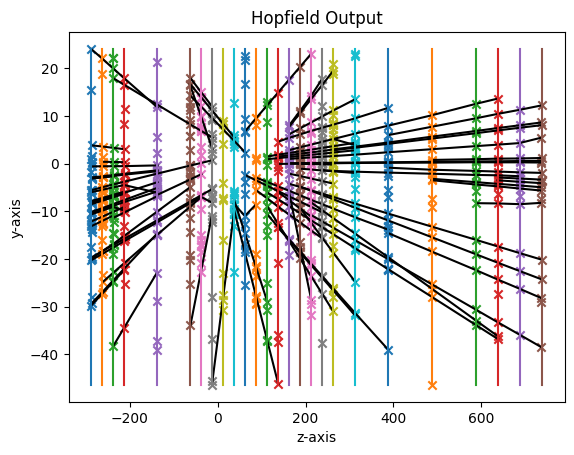

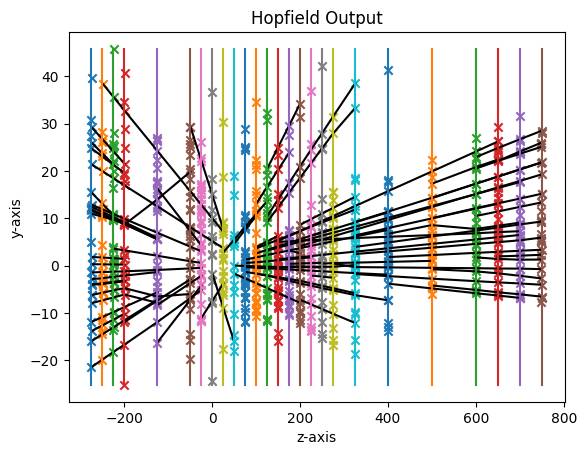

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_376

starting instance 16 out of 100

[INFO] Hopfield Networks initialized in 0 mins 3.26 seconds
energy: -347.4435729994823
energy: -389.3783799589147
energy: -412.9055902590213
energy: -462.2605874116255
energy: -340.7074289134316
energy: -446.4861779969344
energy: -345.94126374104405
energy: -422.66201611712506
energy: -369.70064240868396
energy: -379.52894302212064
[HOPFIELD] converged network by below_mean after 3 mins 43.14 seconds; (energy: -391.70)
energy: -377.96802165516146
energy: -326.07605939550723
energy: -349.4174605287735
energy: -306.51782892621424
energy: -303.2387531269753
energy: -333.6073322008922
energy: -341.1648635145733
energy: -309.27009160958534
energy: -339.9660452676269
energy: -361.575622036829
[HOPFIELD] converged network by below_mean after 2 mins 44.48 seconds; (energy: -334.88)
[INFO] tracks extracted in 0 mins 0.16 seconds


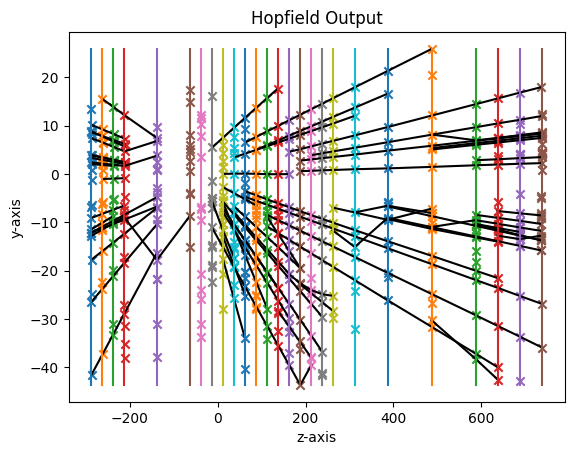

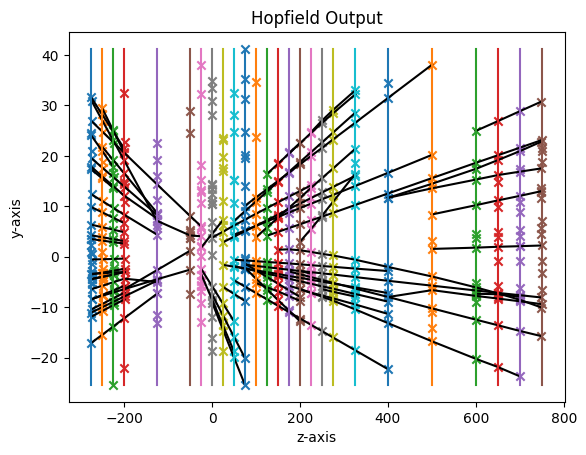

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_78
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_778

starting instance 17 out of 100

[INFO] Hopfield Networks initialized in 0 mins 3.44 seconds
energy: -338.4595520070957
energy: -353.9712119658898
energy: -319.8506615148434
energy: -339.1654569367067
energy: -339.4242026056995
energy: -309.41136083166634
energy: -358.3582292690188
energy: -354.01967901121145
energy: -365.8147987894433
energy: -329.904553895687
[HOPFIELD] converged network by below_mean after 1 mins 34.52 seconds; (energy: -340.84)
energy: -418.7665433013997
energy: -436.0282593950264
energy: -437.2351836309497
energy: -469.47254766568506
energy: -431.8511313012066
energy: -438.2301239829635
energy: -441.87457656143613
energy: -393.4842787388103
energy: -428.1194138673947
energy: -367.4202031308812
[HOPFIELD] converged ne

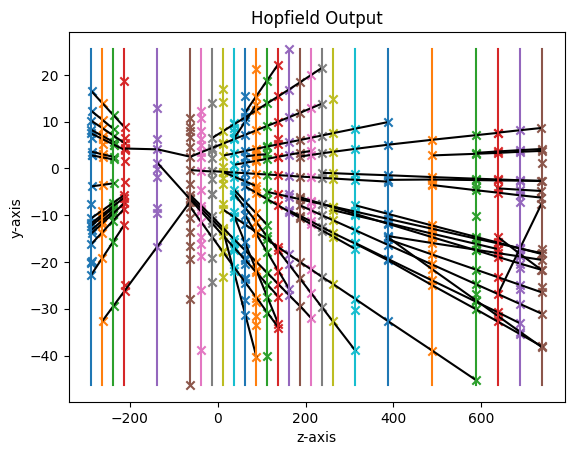

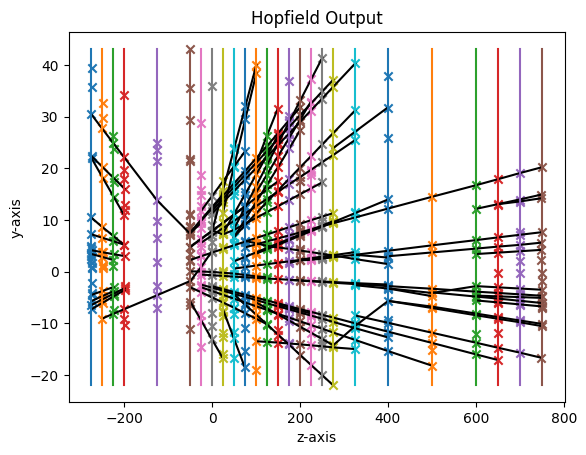

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_79

starting instance 18 out of 100

[INFO] Hopfield Networks initialized in 0 mins 7.58 seconds
energy: -392.84296093693314
energy: -455.13472242906863
energy: -451.70930177190706
energy: -427.54945774233374
energy: -291.2956602731956
energy: -416.83683069761963
energy: -368.9025408745246
energy: -397.2500933541693
energy: -360.3529128326064
energy: -321.32916036321006
[HOPFIELD] converged network by below_mean after 10 mins 16.46 seconds; (energy: -388.32)
energy: -366.41400203318
energy: -423.3875224034046
energy: -384.03612210301895
energy: -378.6870146333025
energy: -325.0525166194185
energy: -396.8033209210813
energy: -443.5424334436919
energy: -409.7461505727685
energy: -471.0340178065918
energy: -410.4252689786841
[HOPFIELD] converged network by below_mean after 9 mins 0.43 seconds; (energy: -400.91)
[INFO] tracks extracted in 0 mins 0.19 seconds


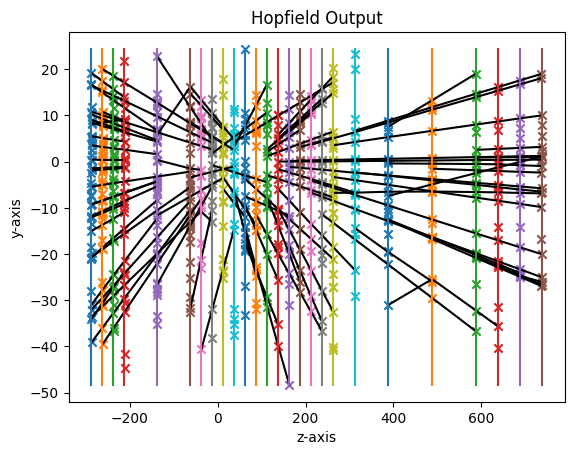

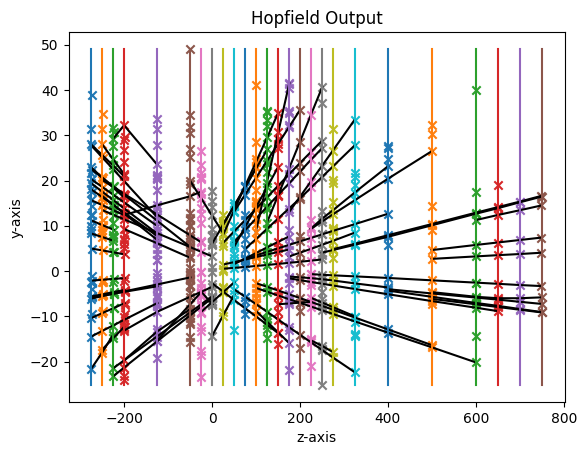

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_476
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_70

starting instance 19 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.32 seconds
energy: -150.0171991194094
energy: -161.27893417514963
energy: -157.56702788986289
energy: -151.94355798635655
energy: -158.86224960832732
energy: -158.6656795977852
energy: -168.299235824603
energy: -148.94482219136682
energy: -166.40489608942582
energy: -149.95949650242613
[HOPFIELD] converged network by below_mean after 0 mins 12.89 seconds; (energy: -157.19)
energy: -67.72021456915726
energy: -68.00226913905067
energy: -69.57527846663399
energy: -70.32091172610957
energy: -64.26287808656937
energy: -72.67906179839613
energy: -59.16165972055715
energy: -61.13796758501783
energy: -68.00982659328895
energy: -70.1473613588503
[HOPFIELD] converged 

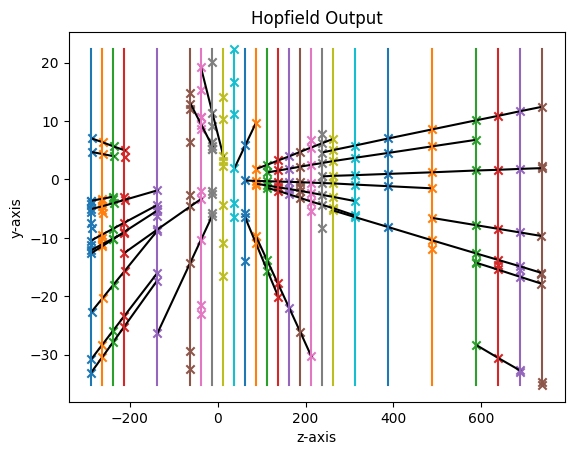

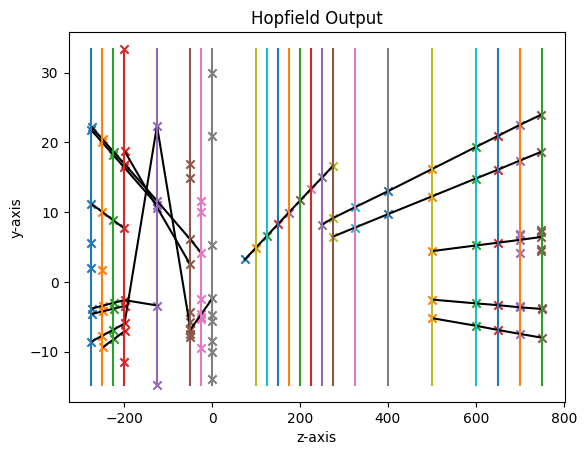

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_59

starting instance 20 out of 100

[INFO] Hopfield Networks initialized in 0 mins 13.40 seconds
energy: -678.0705004309737
energy: -683.9281345186827
energy: -700.9691836020127
energy: -702.9514382891288
energy: -691.1444109007322
energy: -664.6646171303818
energy: -674.2117787381487
energy: -667.668727175654
energy: -655.0271587892013
energy: -677.8653565452911
[HOPFIELD] converged network by below_mean after 27 mins 2.40 seconds; (energy: -679.65)
energy: -538.0296135756582
energy: -563.3227084828651
energy: -434.8876385751246
energy: -536.4342031349387
energy: -504.69540150801663
energy: -539.8866569835089
energy: -578.4442386890547
energy: -487.95989474071644
energy: -535.3026123785212
energy: -512.5510094479912
[HOPFIELD] converged network by below_mean after 14 mins 19.51 seconds; (energy: -523.15)
[INFO] tracks extracted in 0 mins 0.41 seconds


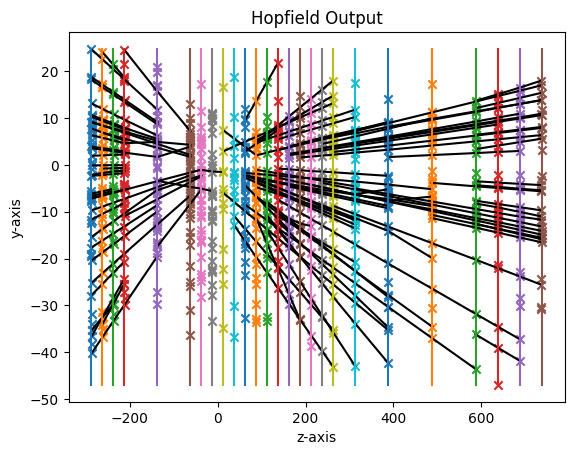

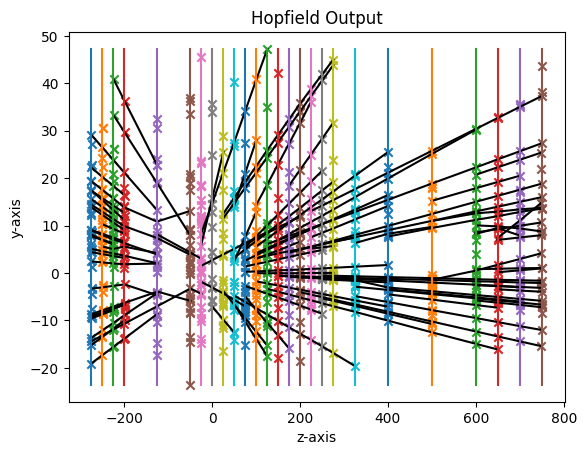

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_341

starting instance 21 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.41 seconds
energy: -166.8565827106085
energy: -151.6840714446693
energy: -194.60163169162436
energy: -187.54203108069404
energy: -159.1318808075172
energy: -179.86141104811801
energy: -162.74797735108385
energy: -159.17830836576567
energy: -168.20366006760148
energy: -160.17818534141352
[HOPFIELD] converged network by below_mean after 0 mins 11.94 seconds; (energy: -169.00)
energy: -133.9652725551096
energy: -139.43629930701104
energy: -134.05908912249717
energy: -126.97338278265383
energy: -131.14039001073792
energy: -146.81461950837905
energy: -138.39754838944177
energy: -137.81696222053094
energy: -136.68532910801406
energy: -136.7566482045982
[HOPFIELD] converged network by below_mean after 0 mins 4.11 seconds; (energy: -136.20)
[INFO] tracks extracted in 0 mins 0.02 seconds


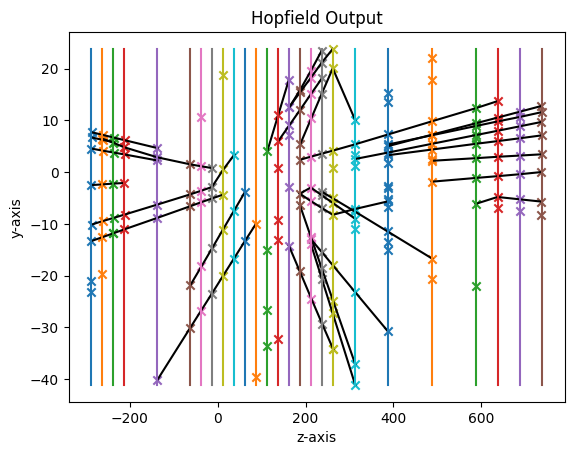

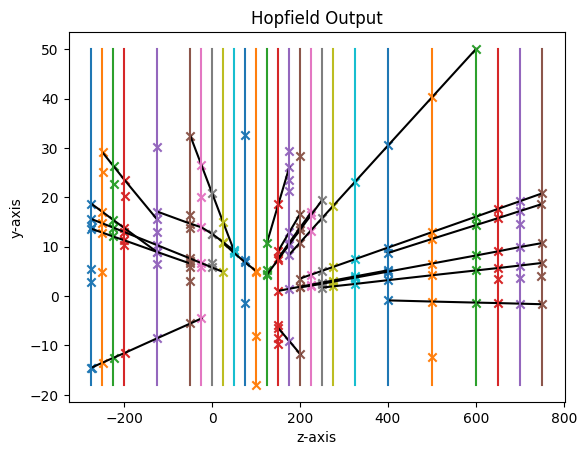

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_10
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_430
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_169

starting instance 22 out of 100

[INFO] Hopfield Networks initialized in 0 mins 10.92 seconds
energy: -560.936108836401
energy: -419.36847124061984
energy: -447.41230984875847
energy: -547.292623106853
energy: -472.8292931054774
energy: -564.4508717568034
energy: -424.25894859311177
energy: -452.8357787296875
energy: -507.61964810349735
energy: -578.0214225671987
[HOPFIELD] converged network by below_mean after 12 mins 37.74 seconds; (energy: -497.50)
energy: -503.9259699780479
energy: -512.1959574201405
energy: -535.7327506206359
energy: -556.941249883186
energy: -485.47802015846787
energy: -508.54245930974844
ene

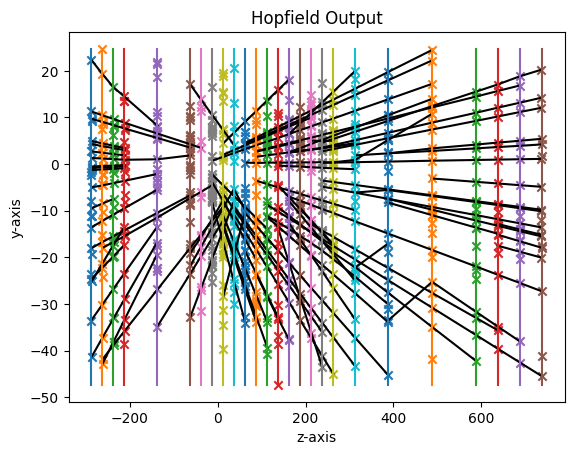

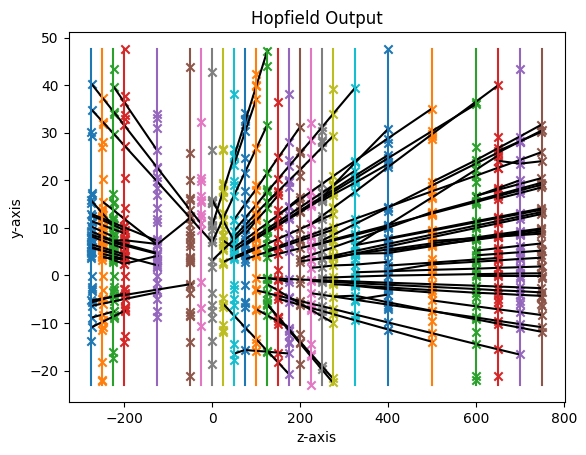

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_350

starting instance 23 out of 100

[INFO] Hopfield Networks initialized in 0 mins 2.70 seconds
energy: -266.96035748638656
energy: -271.5800343836836
energy: -250.849016241836
energy: -275.8040659567646
energy: -263.1683049705723
energy: -273.19903452997846
energy: -261.0332089724893
energy: -273.6230044180221
energy: -294.03235145767394
energy: -274.91908116178195
[HOPFIELD] converged network by below_mean after 1 mins 9.90 seconds; (energy: -270.52)
energy: -372.42453048970276
energy: -315.27865211612743
energy: -400.97992979635023
energy: -379.9904304475806
energy: -434.50663709310817
energy: -435.5556741589386
energy: -399.28574875406815
energy: -376.17408341174394
energy: -416.5383250712438
energy: -375.8614921041852
[HOPFIELD] converged network by below_mean after 2 mins 39.93 seconds; (energy: -390.66)
[INFO] tracks extracted in 0 mins 0.11 seconds


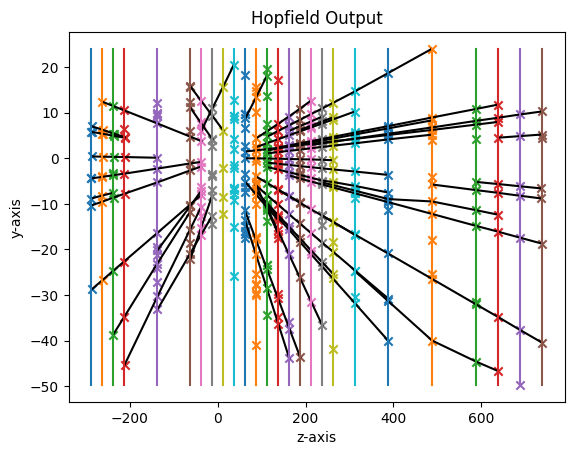

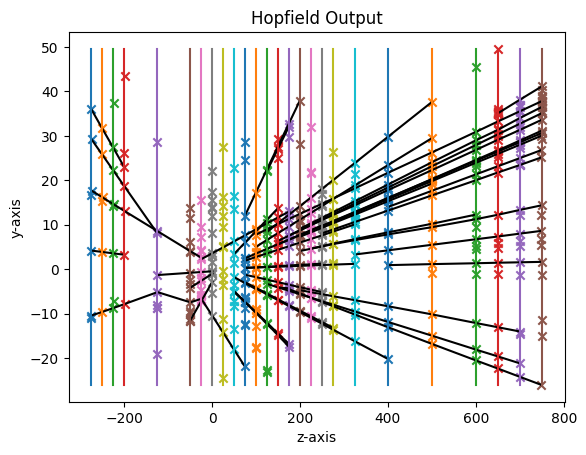

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_155

starting instance 24 out of 100

[INFO] Hopfield Networks initialized in 0 mins 10.98 seconds
energy: -518.6288114133707
energy: -475.19372882561413
energy: -559.5623492917699
energy: -510.77353330643393
energy: -480.1168823704132
energy: -501.94662562431006
energy: -523.6495856487239
energy: -554.3321982492657
energy: -499.2469582455628
energy: -499.4493206722268
[HOPFIELD] converged network by below_mean after 16 mins 46.27 seconds; (energy: -512.29)
energy: -350.3156032098854
energy: -412.76052982959453
energy: -411.7778166845228
energy: -378.62591338566654
energy: -428.7000331491587
energy: -437.1937709654664
energy: -418.11152039714773
energy: -447.76629146445407
energy: -556.7754872576745
energy: -414.0286991085657
[HOPFIELD] converged network by below_mean after 15 mins 41.53 seconds; (energy: -425.61)
[INFO] tracks extracted in 0 mins 0.33 seconds


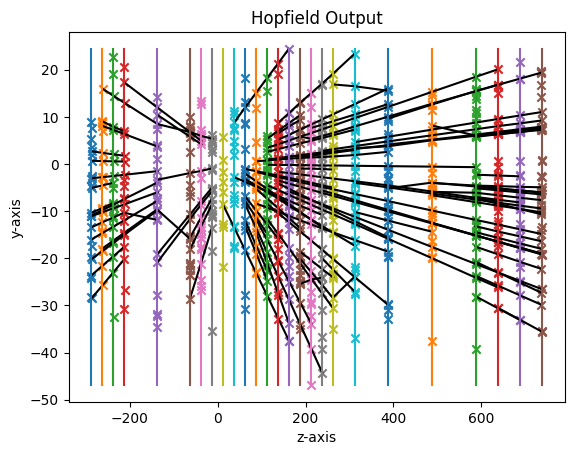

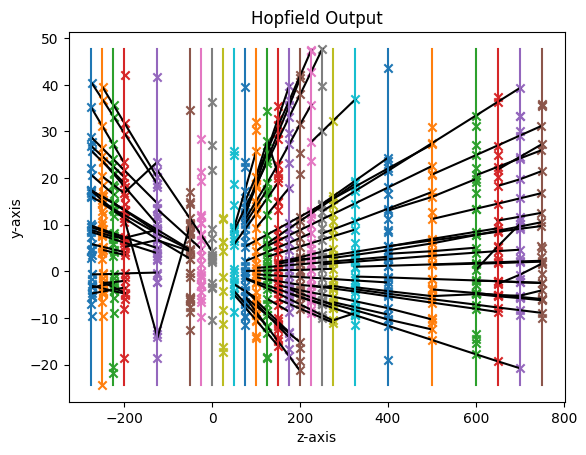

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_500
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_584

starting instance 25 out of 100

[INFO] Hopfield Networks initialized in 0 mins 3.05 seconds
energy: -328.4105766941466
energy: -279.30584508625026
energy: -256.9075612161474
energy: -334.8671876613551
energy: -300.50436314418704
energy: -283.6427666650636
energy: -275.02636955094505
energy: -284.48577919165143
energy: -292.86347461612564
energy: -342.9138610246075
[HOPFIELD] converged network by below_mean after 1 mins 30.58 seconds; (energy: -297.89)
energy: -602.766291221447
energy: -456.8507883489018
energy: -464.15514799461005
energy: -464.201241683717
energy: -465.08002689678966
energy: -447.3399558922528
energy: -484.515849118442
energy: -561.6766200818606
energy: -436.727787857066
energy: -469.97866024724965
[HOPFIELD] converged 

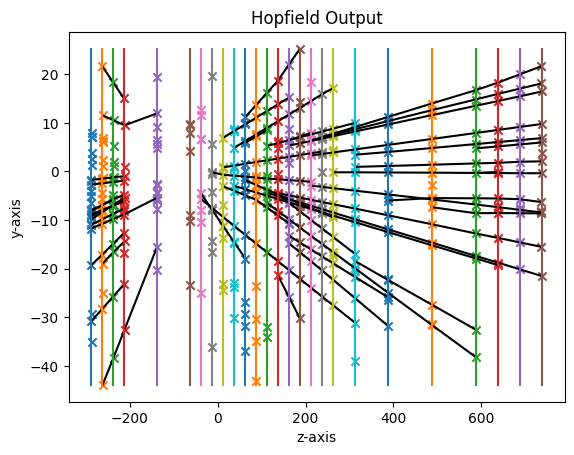

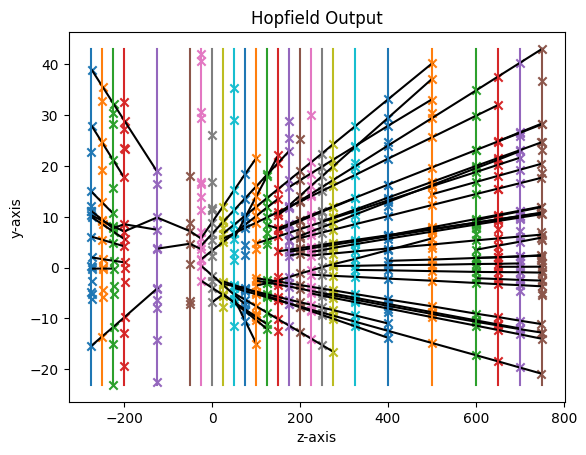

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_186
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_445
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_313
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_949
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_757
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_538

starting instance 26 out of 100

[INFO] Hopfield Networks initialized in 0 mins 8.51 seconds
energy: -517.6179677157767
energy: -516.7681896746807
energy: -545.2047793688916
energy: -495.6393999208028
energy: -564.0885672415744
energy: -527.69

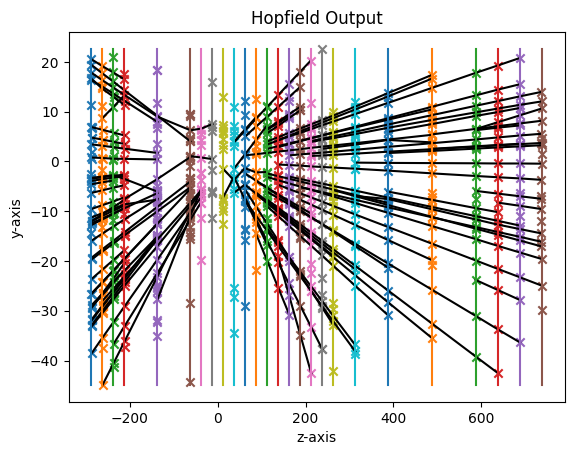

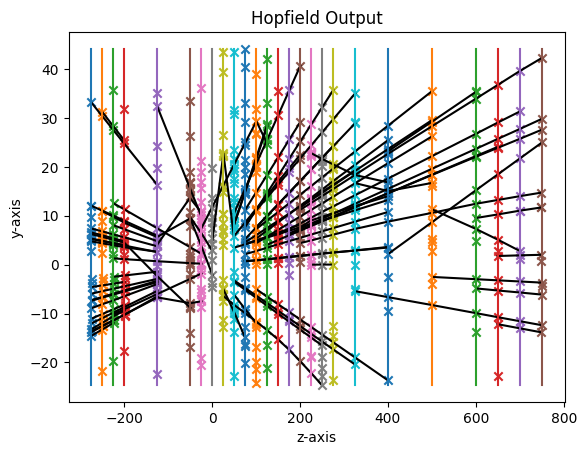

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_519
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_511
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_928
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_906
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_342

starting instance 27 out of 100

[INFO] Hopfield Networks initialized in 0 mins 2.58 seconds
energy: -325.9682860646899
energy: -323.924957765832
energy: -306.0345211758001
energy: -340.1697650754288
energy: -340.24840336032383
energy: -307.37160444293477
energy: -309.8043029010681
energy: -314.03844390211896
energy: -324.67624506920373
energy: -313.50395459405667
[H

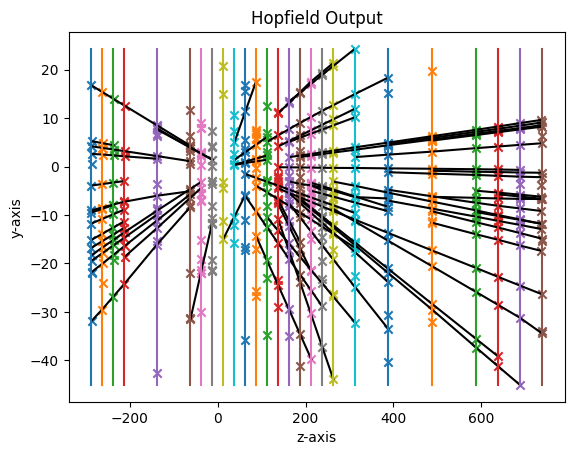

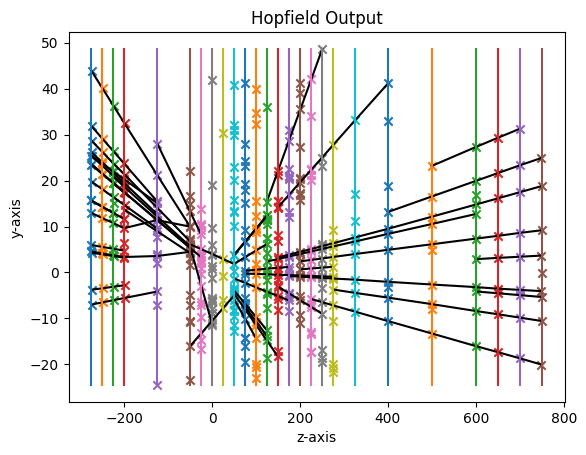

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_701
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_448

starting instance 28 out of 100

[INFO] Hopfield Networks initialized in 0 mins 5.41 seconds
energy: -442.3850410748546
energy: -418.50877631068846
energy: -414.48922696162117
energy: -404.6768905949589
energy: -425.74682742
energy: -443.2751803863607
energy: -558.9617045660963
energy: -437.19891698603516
energy: -398.03438565845715
energy: -464.9986344635511
[HOPFIELD] converged network by below_mean after 8 mins 15.05 seconds; (energy: -440.83)
energy: -377.2794429859181
energy: -356.0194708809571
energy: -377.32298955059093
energy: -380.6742523755421
energy: -429.430840382305
energy: -361.85343733561973
energy: -369.03768052548287
energy: -342.60003640488344
energy: -428.42557582883137
energy: -378.45902513681074
[HOPFIELD] converged 

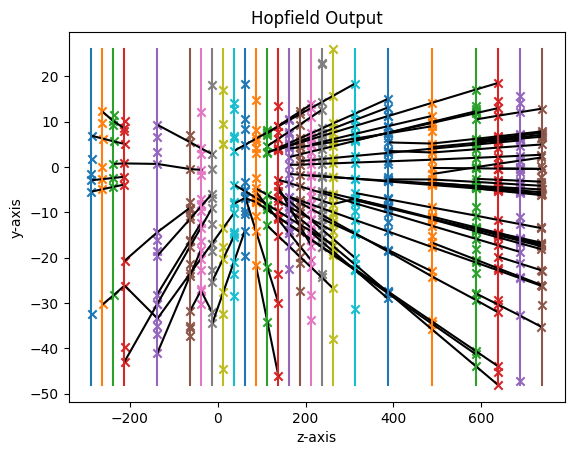

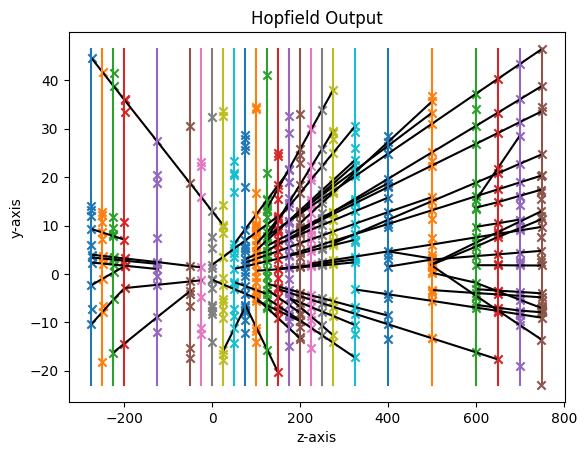

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_183

starting instance 29 out of 100

[INFO] Hopfield Networks initialized in 0 mins 2.16 seconds
energy: -290.56518806454915
energy: -290.7689393613319
energy: -290.4153750651862
energy: -297.8006535192268
energy: -314.9586173821441
energy: -325.3348505939784
energy: -274.37310552240734
energy: -299.4322899476594
energy: -294.16560577214665
energy: -290.3169566491157
[HOPFIELD] converged network by below_mean after 1 mins 25.80 seconds; (energy: -296.81)
energy: -281.9594604351298
energy: -317.79873238556377
energy: -323.698849327476
energy: -346.9096473437846
energy: -274.7799634532008
energy: -297.8648105419669
energy: -329.67240762074107
energy: -289.7070404721533
energy: -346.43137404794976
energy: -324.4863020723437
[HOPFIELD] converged network by below_mean after 1 mins 16.82 seconds; (energy: -313.33)
[INFO] tracks extracted in 0 mins 0.12 seconds


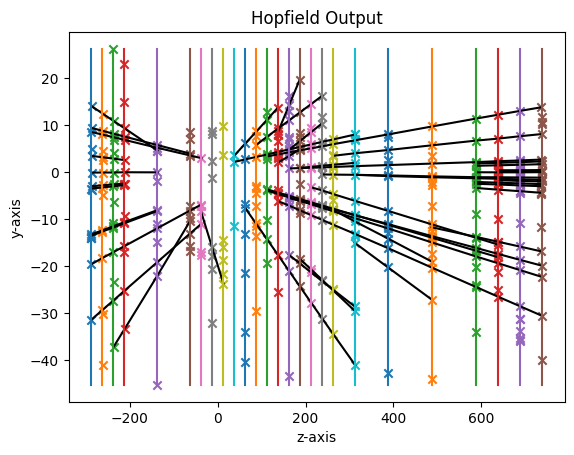

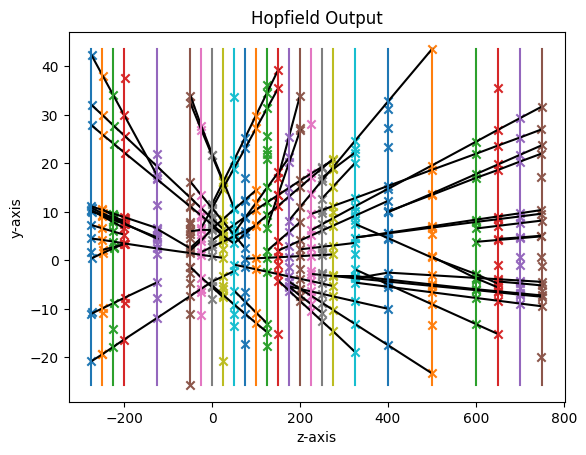

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_28

starting instance 30 out of 100

[INFO] Hopfield Networks initialized in 0 mins 6.10 seconds
energy: -389.44669406536104
energy: -371.50019943759173
energy: -442.61803583267135
energy: -392.41161185170944
energy: -414.33101923797676
energy: -393.83661941455233
energy: -379.68067453585684
energy: -383.0648115392906
energy: -422.98291186077086
energy: -400.6664431268488
[HOPFIELD] converged network by below_mean after 4 mins 10.33 seconds; (energy: -399.05)
energy: -525.2016724268332
energy: -612.3755857824759
energy: -582.9011832566807
energy: -628.9712857127369
energy: -560.2135192902409
energy: -505.7779478854661
energy: -519.2905545984348
energy: -567.0678638282128
energy: -493.2386827949504
energy: -574.3253881440444
[HOPFIELD] converged network by below_mean after 8 mins 9.78 seconds; (energy: -556.94)
[INFO] tracks extracted in 0 mins 0.21 seconds


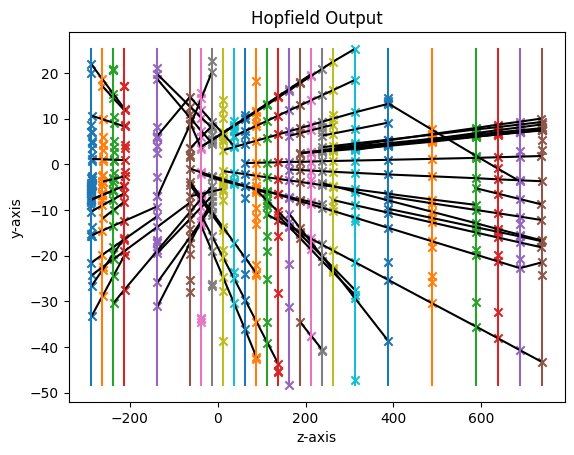

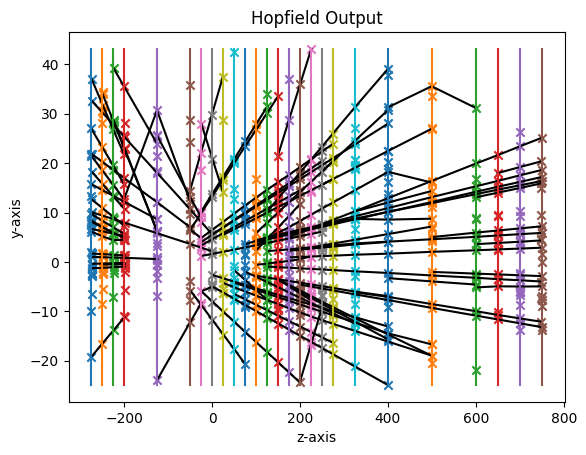

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_156
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_95
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_172
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_889

starting instance 31 out of 100

[INFO] Hopfield Networks initialized in 0 mins 1.35 seconds
energy: -260.6113404126885
energy: -258.4336196406281
energy: -266.5616534968038
energy: -287.427131690272
energy: -263.81694381363036
energy: -241.82346784765272
energy: -234.8259123954898
energy: -245.30763724207793
energy: -251.68478313996468
energy: -279.05720476388063
[HOPFIELD] converged network by below_mean after 1 mins 8.79 seconds; (energy: -258.95)
energy: -233.69063030322062
energy: -193.

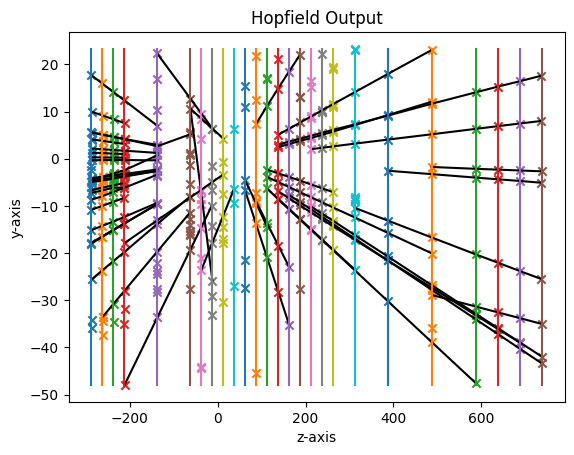

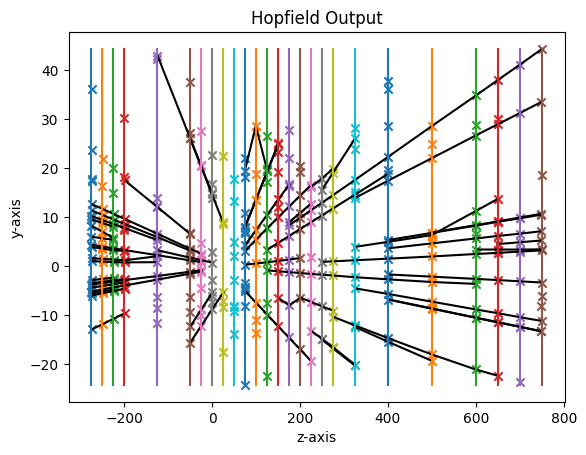

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_397
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_523
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_767

starting instance 32 out of 100

[INFO] Hopfield Networks initialized in 0 mins 11.93 seconds
energy: -511.41763676725213
energy: -531.1752852834134
energy: -496.7223192227317
energy: -501.82649375231296
energy: -505.0669240598992
energy: -487.43929022540493
energy: -474.56017379217866
energy: -558.0139010047902
energy: -544.4675489156183
energy: -499.39111917343257
[HOPFIELD] converged network by below_mean after 14 mins 41.00 seconds; (energy: -511.01)
energy: -526.6897972825636
energy: -527.6057595241598
energy: -483.8731275883021
energy: -512.3864821461749
energy: -530.9120897640737
energy: -491.30190059447335

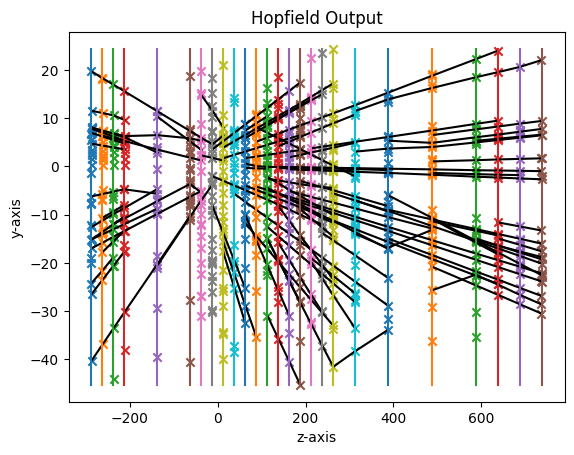

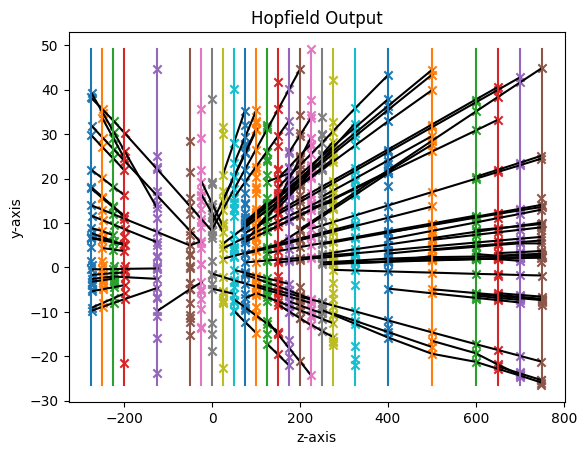

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_314

starting instance 33 out of 100

[INFO] Hopfield Networks initialized in 0 mins 1.03 seconds
energy: -185.90731393897968
energy: -200.200966535496
energy: -177.29749358374184
energy: -179.17022369810576
energy: -205.48203541519825
energy: -201.53807310096718
energy: -188.99095103732478
energy: -192.58870980618235
energy: -192.22078598408092
energy: -189.87787609033734
[HOPFIELD] converged network by below_mean after 0 mins 17.97 seconds; (energy: -191.33)
energy: -184.50071472920698
energy: -191.44239552479664
energy: -176.82771589452358
energy: -169.20268409783426
energy: -178.04001840846894
energy: -187.8458130022213
energy: -173.7169038802129
energy: -171.6013554078816
energy: -184.41796401113217
energy: -192.20757214553575
[HOPFIELD] converged network by below_mean after 0 mins 23.47 seconds; (energy: -180.98)
[INFO] tracks extracted in 0 mins 0.02 seconds


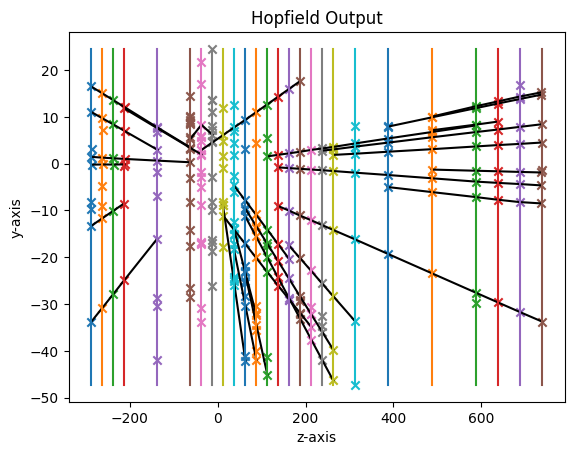

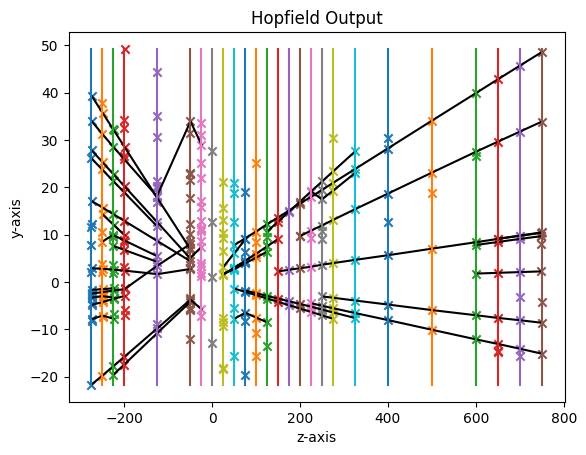

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_752
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_895

starting instance 34 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.75 seconds
energy: -212.01157326747708
energy: -191.9162232139533
energy: -213.92093766896758
energy: -213.9399187428097
energy: -219.70574426830112
energy: -232.22054842221877
energy: -208.0984337625538
energy: -215.1495848957096
energy: -203.683098610738
energy: -201.16042182150704
[HOPFIELD] converged network by below_mean after 0 mins 16.61 seconds; (energy: -211.18)
energy: -265.9025496724993
energy: -275.63542438306104
energy: -280.5167661892501
energy: -296.2418112683292
energy: -294.1054570047037
energy: -285.01437330401336
energy: -266.54276449161745
energy: -254.3023589909863
energy: -256.96736775514427
energy: -279.5636190900317
[HOPFIELD] conver

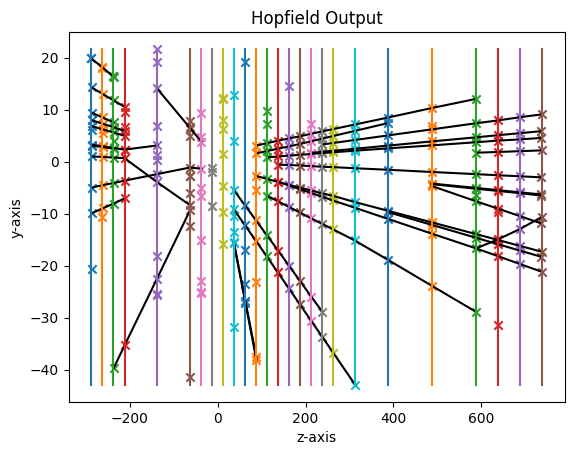

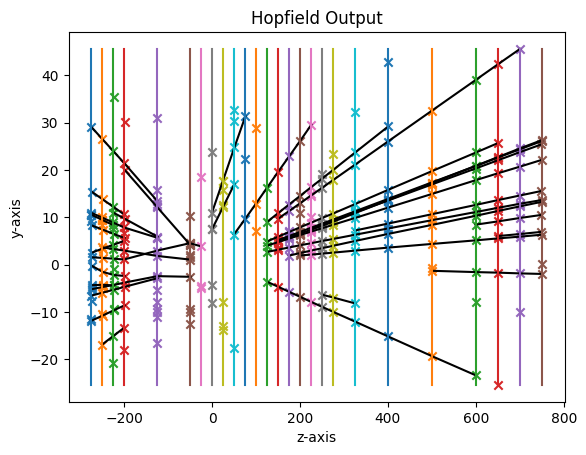

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_390
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_266
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_935

starting instance 35 out of 100

[INFO] Hopfield Networks initialized in 0 mins 5.92 seconds
energy: -437.54762119449356
energy: -403.22939052854815
energy: -343.6198732799655
energy: -417.0136109204188
energy: -459.0615256954363
energy: -344.8432672934037
energy: -360.18844709377015
energy: -341.73710539661914
energy: -477.5224007717584
energy: -370.1727281117776
[HOPFIELD] converged network by below_mean after 6 mins 7.20 seconds; (energy: -395.49)
energy: -400.5270316540027
energy: -476.2162484306864
energy: -420.8590598925437
energy: -441.0518296395878
energy: -382.77017783833145
energy: -426.71770374781477
en

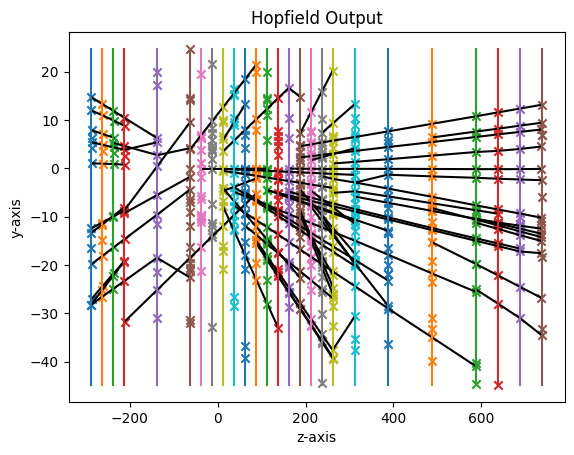

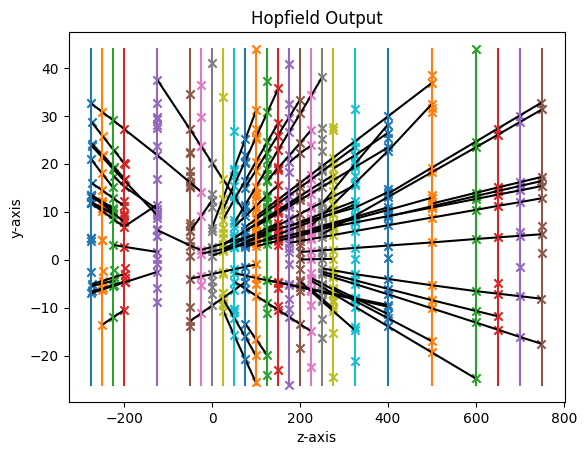

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_43

starting instance 36 out of 100

[INFO] Hopfield Networks initialized in 0 mins 6.32 seconds
energy: -448.1152448181487
energy: -452.9989936118365
energy: -488.5402499924718
energy: -531.114275207725
energy: -469.3133047689526
energy: -503.65582201853056
energy: -536.9562807675379
energy: -407.3639569036379
energy: -471.3463902478681
energy: -478.2393856277381
[HOPFIELD] converged network by below_mean after 9 mins 31.59 seconds; (energy: -478.76)
energy: -398.6223600685188
energy: -377.74268060878205
energy: -396.2693471970651
energy: -374.71934251282346
energy: -410.56209386036164
energy: -412.85578611781557
energy: -400.5245988733707
energy: -353.67022777694024
energy: -445.19275331180637
energy: -360.15218838102214
[HOPFIELD] converged network by below_mean after 3 mins 17.80 seconds; (energy: -393.03)
[INFO] tracks extracted in 0 mins 0.21 seconds


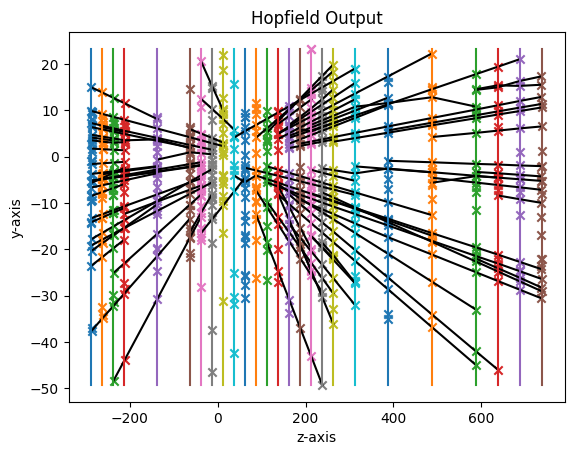

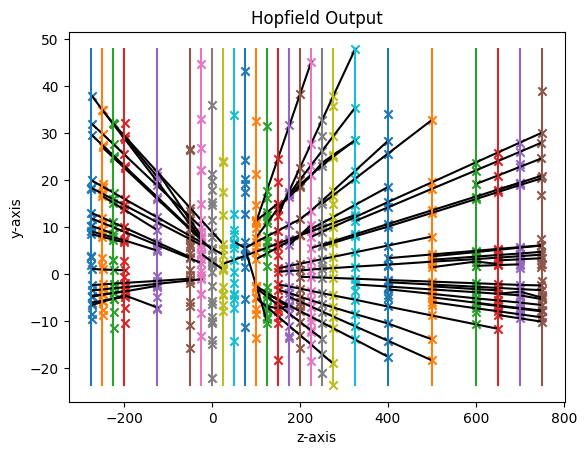

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_340
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_130
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_1
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_373
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_550
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_988
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_452

starting instance 37 out of 100

[INFO] Hopfield Networks initialized in 0 mins 6.09 seconds
energy: -426.9480193002495

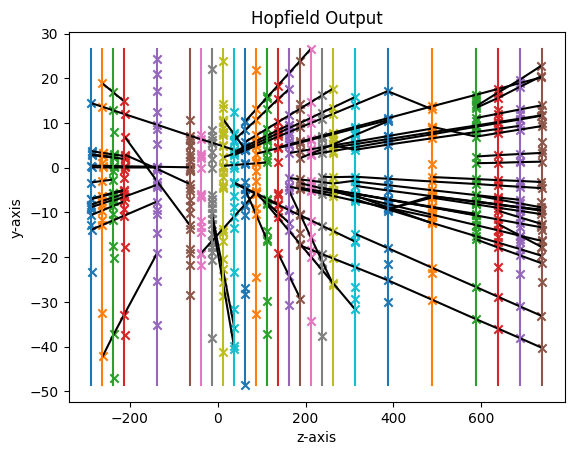

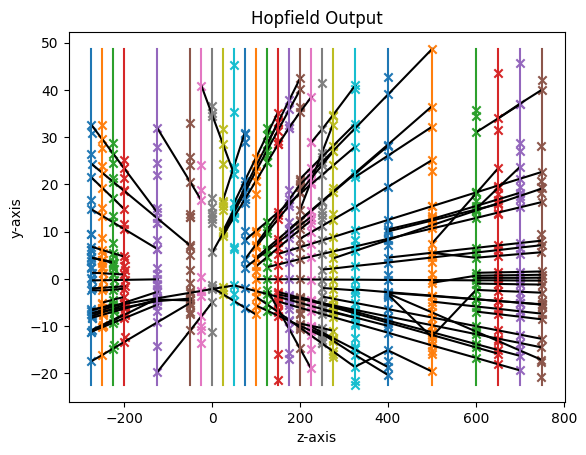

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_285
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_983

starting instance 38 out of 100

[INFO] Hopfield Networks initialized in 0 mins 10.75 seconds
energy: -513.506574095599
energy: -493.5449772922841
energy: -551.5159367963416
energy: -448.3973418895395
energy: -455.80665240421774
energy: -499.88063669687017
energy: -489.4272322805665
energy: -440.11258573806936
energy: -500.20883116742226
energy: -531.9145440295044
[HOPFIELD] converged network by below_mean after 21 mins 56.26 seconds; (energy: -492.43)
energy: -439.63166955195715
energy: -466.1873550654095
energy: -393.18560440987227
energy: -476.47373078566625
energy: -406.38812272982204
energy: -360.58786834841203
energy: -403.94530230858453
energy: -441.5752710885867
energy: -343.61298461555634
energy: -380.7966468518339
[HOPFIELD] co

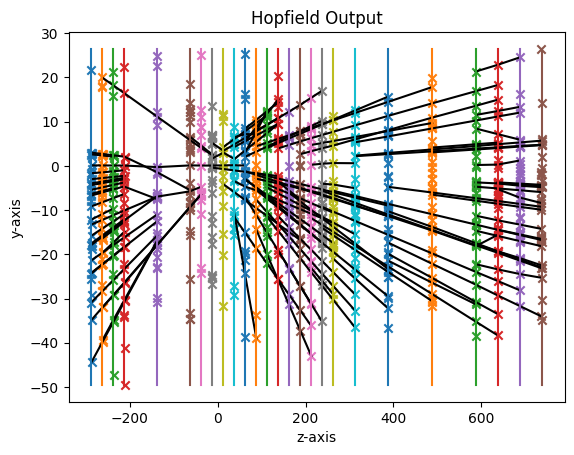

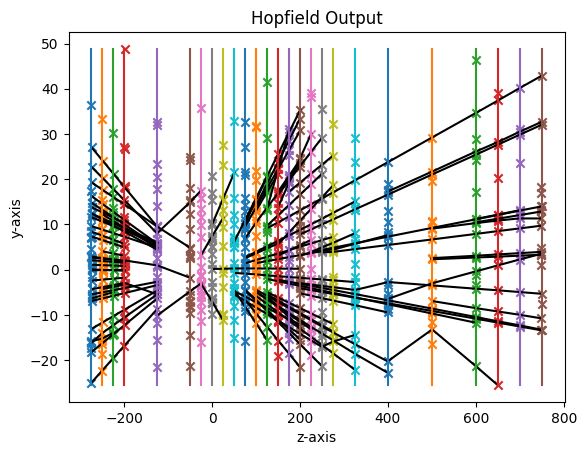

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_682
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_936
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_797
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_44
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_492

starting instance 39 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.21 seconds
energy: -131.58768759830843
energy: -139.76120186251268
energy: -119.57365043487485
energy: -139.76120186251268
energy: -139.76120186251268
energy: -131.58768759830843
energy: -134.80142093460015
energy: -139.76120186251268
energy: -139.83576311257843
energy: -135.132584660784

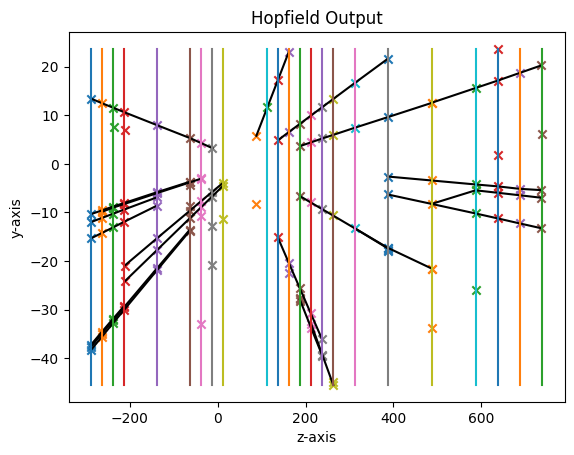

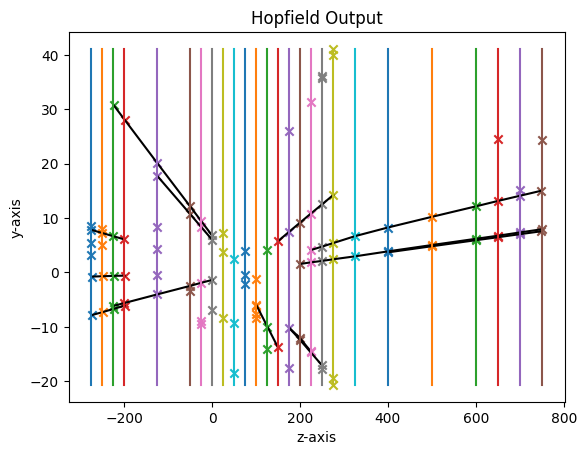

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_302

starting instance 40 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.87 seconds
energy: -226.28080808329952
energy: -216.24485108423454
energy: -219.9912102223165
energy: -249.84414463492806
energy: -233.64518199982666
energy: -244.76751204205246
energy: -234.49409962029313
energy: -223.5827287114828
energy: -259.4333065331534
energy: -238.89589298104994
[HOPFIELD] converged network by below_mean after 0 mins 22.25 seconds; (energy: -234.72)
energy: -320.69584611199963
energy: -343.08323111668017
energy: -336.5198289732637
energy: -340.6882618525571
energy: -336.58658309336215
energy: -324.28422751234575
energy: -327.3479063504994
energy: -327.29974031129876
energy: -331.82394715553124
energy: -351.77483369250905
[HOPFIELD] converged network by below_mean after 0 mins 28.86 seconds; (energy: -334.01)
[INFO] tracks extracted in 0 mins 0.05 seconds


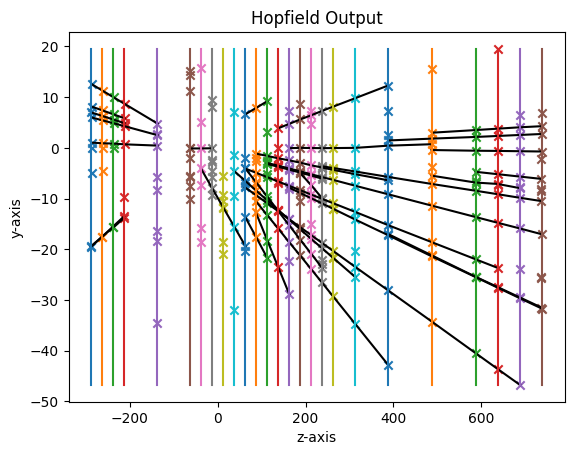

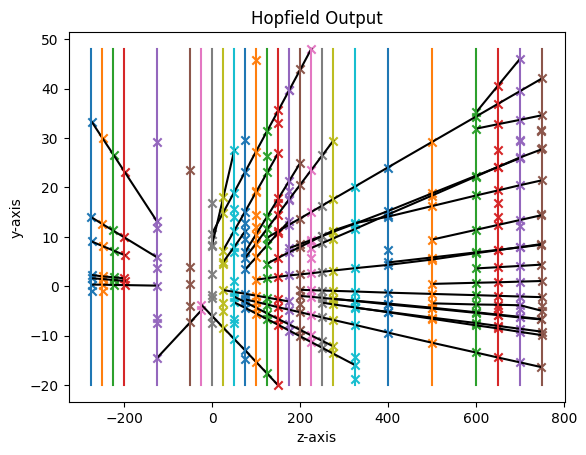

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_792
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_681
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_706

starting instance 41 out of 100

[INFO] Hopfield Networks initialized in 0 mins 2.02 seconds
energy: -322.647985142647
energy: -283.4517508380311
energy: -283.82163528675227
energy: -316.59507608132344
energy: -317.74015761805185
energy: -275.5004993612334
energy: -324.0340388099049
energy: -302.1422852555088
energy: -311.2707178444399
energy: -336.5233842314919
[HOPFIELD] converged network by below_mean after 1 mins 19.28 seconds; (energy: -307.37)
energy: -307.3103997055471
energy: -277.97382578602384
energy: -329.53397556224036
energy: -292.9274350341883
energy: -311.346211922523
energy: -297.4946290049107
ener

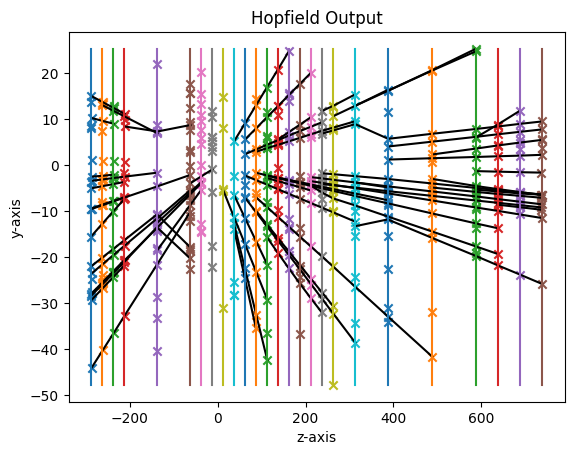

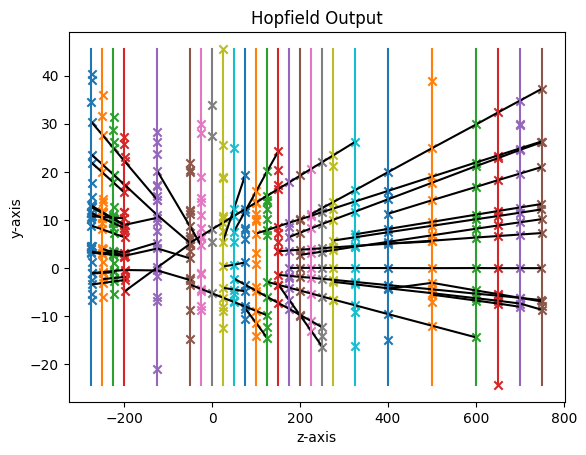

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_237

starting instance 42 out of 100

[INFO] Hopfield Networks initialized in 0 mins 4.78 seconds
energy: -300.8190674853438
energy: -342.03116974997056
energy: -383.71065340899844
energy: -375.6982918413538
energy: -372.2563299942315
energy: -397.5055358797213
energy: -334.98666649607105
energy: -307.68387445703087
energy: -377.9096877723739
energy: -380.9456145999788
[HOPFIELD] converged network by below_mean after 4 mins 9.88 seconds; (energy: -357.35)
energy: -352.87043458642586
energy: -347.0340971467164
energy: -369.4265059065642
energy: -340.87999295388886
energy: -310.8073644238876
energy: -325.004450626933
energy: -334.7110715215686
energy: -370.6388591482156
energy: -359.5001328199663
energy: -290.61050552791966
[HOPFIELD] converged network by below_mean after 3 mins 19.01 seconds; (energy: -340.15)
[INFO] tracks extracted in 0 mins 0.16 seconds


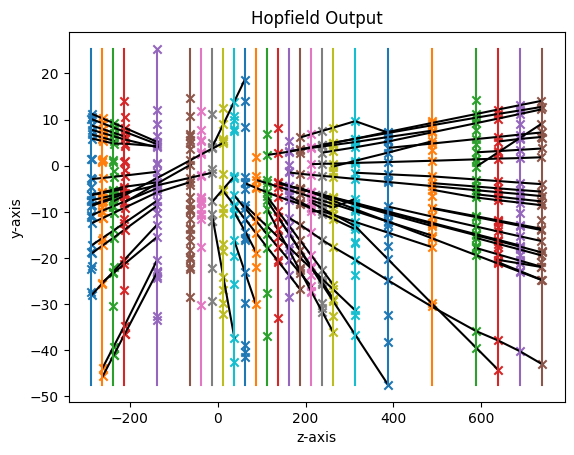

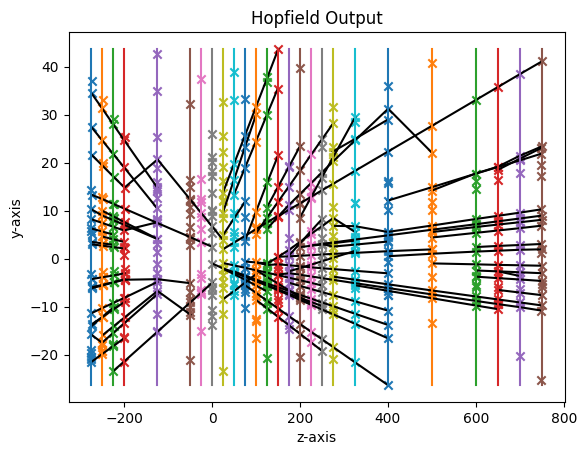

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_787
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_844

starting instance 43 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.29 seconds
energy: -122.97524604429638
energy: -126.25981038646894
energy: -114.55823235423165
energy: -124.32080520385034
energy: -134.14245817725768
energy: -123.999771405384
energy: -116.81914211825676
energy: -131.81086551138281
energy: -119.18719948837477
energy: -126.13247779114812
[HOPFIELD] converged network by below_mean after 0 mins 6.60 seconds; (energy: -124.02)
energy: -181.96593543786133
energy: -189.53221184526356
energy: -189.76999720051066
energy: -168.95601387295966
energy: -190.15058512403365
energy: -191.32347415549714
energy: -211.20186404701178
energy: -210.75930432048153
energy: -211.35886930277024
energy: -214.60996049740262
[HOPFIEL

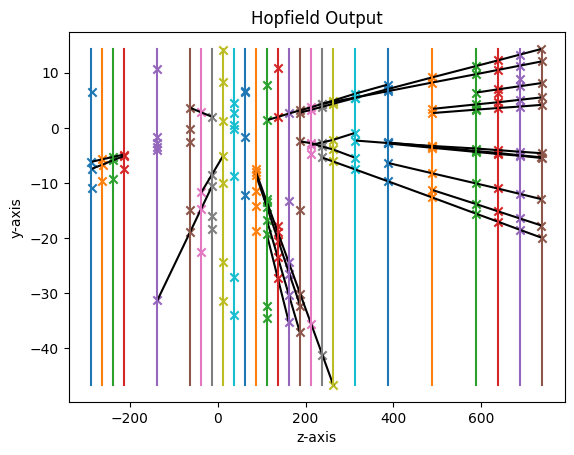

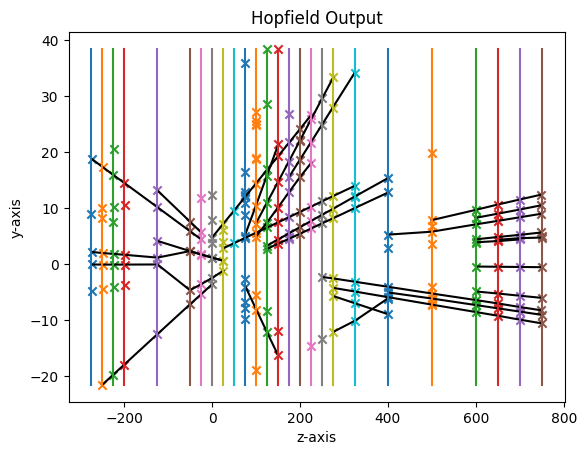

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_887
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_330
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_880

starting instance 44 out of 100

[INFO] Hopfield Networks initialized in 0 mins 7.00 seconds
energy: -454.8800077429298
energy: -361.2643262919489
energy: -441.9151587601441
energy: -446.04343985007995
energy: -425.0655545620315
energy: -390.2399187207831
energy: -403.702136410872
energy: -478.32233155037085
energy: -399.2668227786293
energy: -380.5428212473271
[HOPFIELD] converged network by below_mean after 3 mins 52.76 seconds; (energy: -418.12)
energy: -567.6253815928926
energy: -617.8446053091656
energy: -556.7341646407165
energy: -602.9530681204138
energy: -641.4243739423135
energy: -553.6531270913603
energy

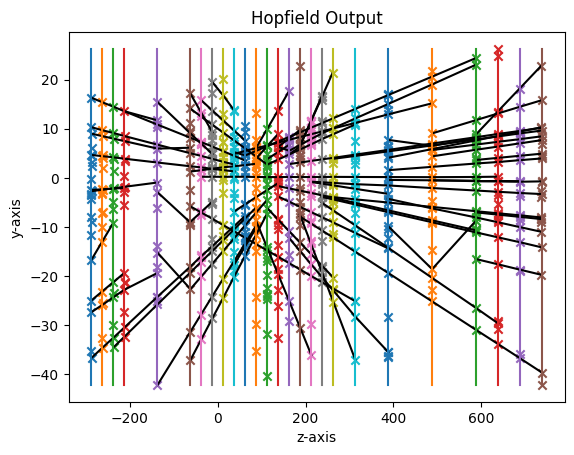

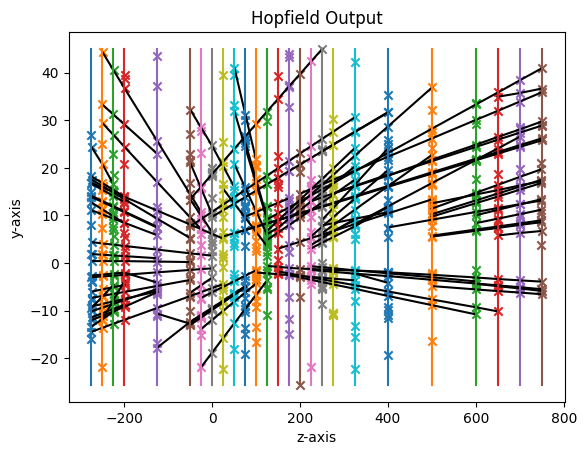

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_831
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_515

starting instance 45 out of 100

[INFO] Hopfield Networks initialized in 0 mins 1.84 seconds
energy: -344.9235514613915
energy: -300.1342100980309
energy: -307.3070777226569
energy: -308.8813554846245
energy: -281.12530327918387
energy: -300.6755044222613
energy: -265.8110411590623
energy: -302.53595223762875
energy: -290.4004237525691
energy: -308.12680463411766
[HOPFIELD] converged network by below_mean after 0 mins 58.87 seconds; (energy: -300.99)
energy: -361.63088444383214
energy: -375.63497967951236
energy: -358.3420893472397
energy: -357.5142788282025
energy: -399.9765074275379
energy: -335.7314154141767
energy: -382.49181494654607
energy: -299.4930138005219
energy: -349.5913067200834
energy: -364.4506422587799
[HOPFIELD] converge

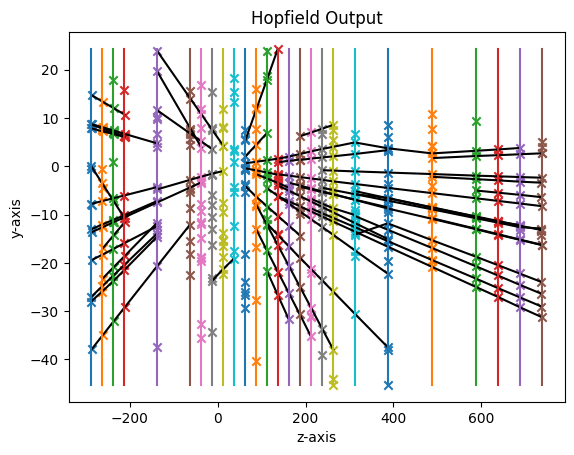

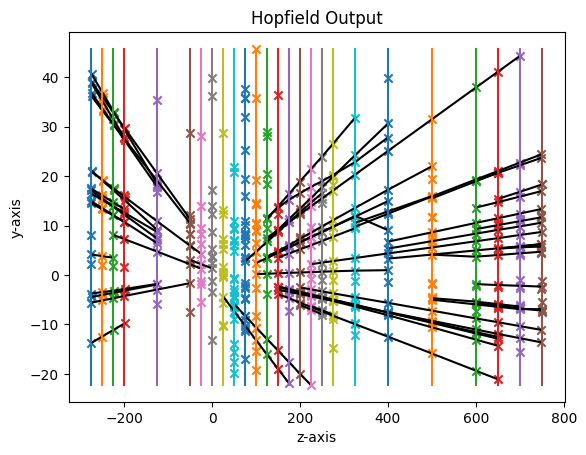

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_684

starting instance 46 out of 100

[INFO] Hopfield Networks initialized in 0 mins 2.68 seconds
energy: -368.74978944356474
energy: -350.3988420356618
energy: -371.3583831832619
energy: -385.34138571652596
energy: -368.8043163766023
energy: -316.21269724366357
energy: -349.062057794159
energy: -372.90680851317506
energy: -372.89595747691186
energy: -376.67028179113913
[HOPFIELD] converged network by below_mean after 1 mins 44.76 seconds; (energy: -363.24)
energy: -297.3385702656995
energy: -291.2984896442716
energy: -318.96105496248276
energy: -304.7984907437328
energy: -266.2031497395932
energy: -292.49610359720305
energy: -308.14866589995415
energy: -289.2166379317458
energy: -298.4771754268741
energy: -270.865151470961
[HOPFIELD] converged network by below_mean after 0 mins 41.14 seconds; (energy: -293.78)
[INFO] tracks extracted in 0 mins 0.08 seconds


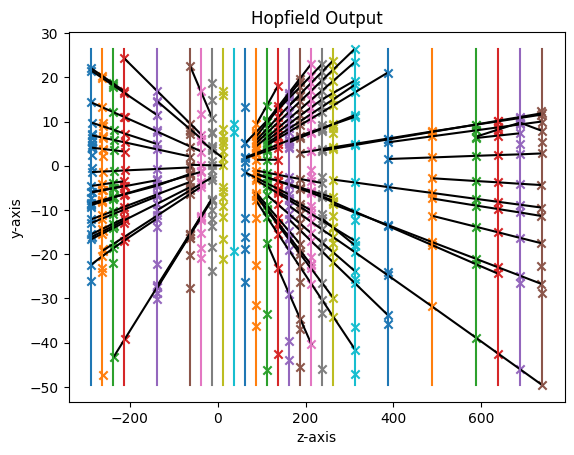

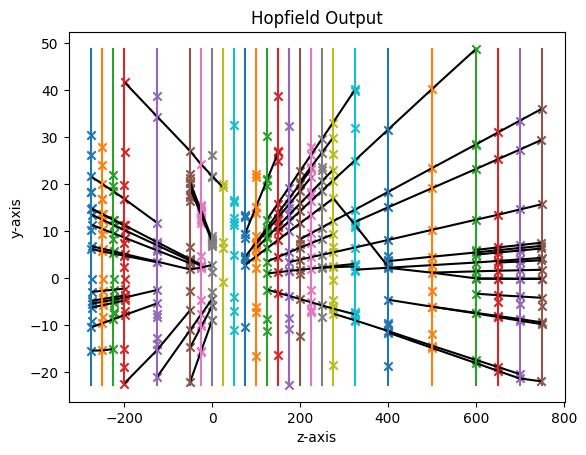

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_354

starting instance 47 out of 100

[INFO] Hopfield Networks initialized in 0 mins 2.13 seconds
energy: -299.9344482533078
energy: -308.38964089974445
energy: -256.7172429619254
energy: -313.82423729982673
energy: -302.20337828406525
energy: -250.50726897961965
energy: -293.05747166609643
energy: -304.6196149258067
energy: -266.73546288241454
energy: -284.8521569517452
[HOPFIELD] converged network by below_mean after 0 mins 59.56 seconds; (energy: -288.08)
energy: -299.20870573113586
energy: -286.0892293512105
energy: -254.55325074108077
energy: -278.4023595487452
energy: -294.84008738430936
energy: -321.29974330359516
energy: -219.07937839157708
energy: -267.13250089011996
energy: -275.1959630738458
energy: -301.8894868751856
[HOPFIELD] converged network by below_mean after 1 mins 11.96 seconds; (energy: -279.77)
[INFO] tracks extracted in 0 mins 0.06 seconds


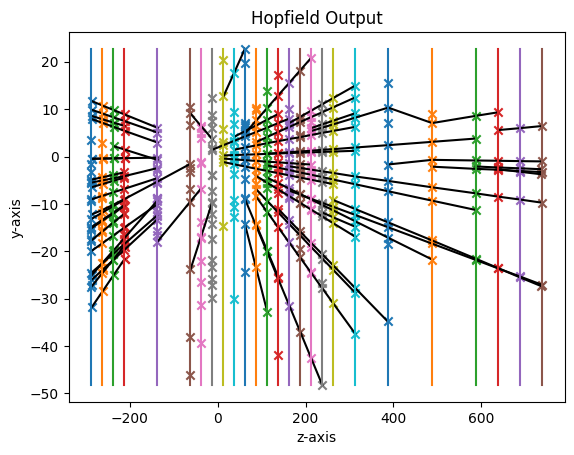

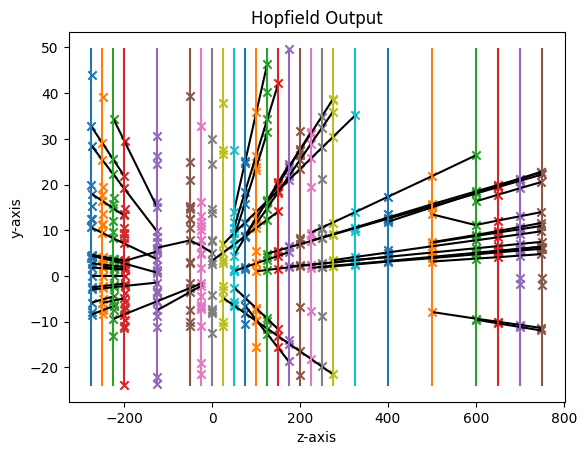

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_485

starting instance 48 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.64 seconds
energy: -140.8274186007544
energy: -139.0047043860131
energy: -141.87421909077727
energy: -147.88137498843832
energy: -153.3014614523904
energy: -140.9369887494314
energy: -144.386403372014
energy: -145.59306340414338
energy: -136.96540762525277
energy: -146.73180945286384
[HOPFIELD] converged network by below_mean after 0 mins 4.55 seconds; (energy: -143.75)
energy: -180.61326592565027
energy: -184.05856818499112
energy: -181.42269939591858
energy: -206.86880750967453
energy: -192.61841698621126
energy: -191.53386483542306
energy: -198.19803750319224
energy: -192.16472136604145
energy: -180.6303444817488
energy: -175.02111644090144
[HOPFIELD] converged network by below_mean after 0 mins 20.18 seconds; (energy: -188.31)
[INFO] tracks extracted in 0 mins 0.03 seconds


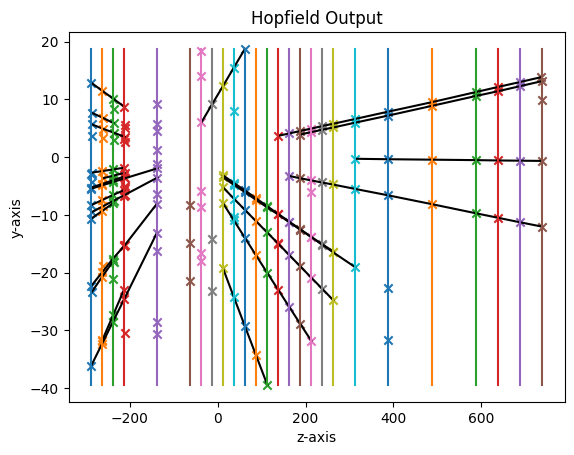

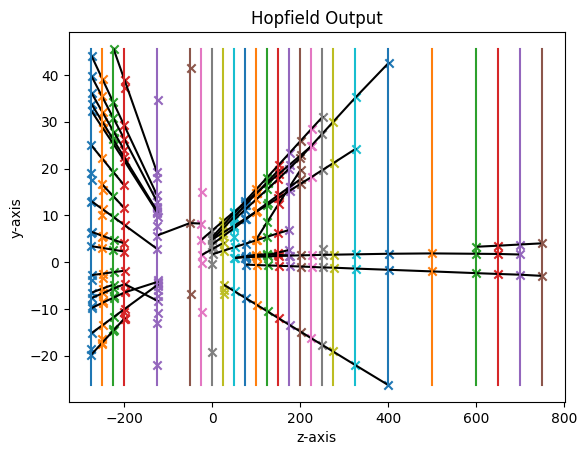

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_85
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_331
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_368
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_592

starting instance 49 out of 100

[INFO] Hopfield Networks initialized in 0 mins 7.63 seconds
energy: -387.29884222119
energy: -416.1334476908991
energy: -435.87130234574306
energy: -389.4408618490254
energy: -466.94388206166366
energy: -414.6369741420415
energy: -419.3415907429901
energy: -431.81173697157055
energy: -436.0524838981578
energy: -407.55025137155604
[HOPFIELD] converged network by below_mean after 5 mins 40.05 seconds; (energy: -420.51)
energy: -467.1231577671624
energy: -471.25

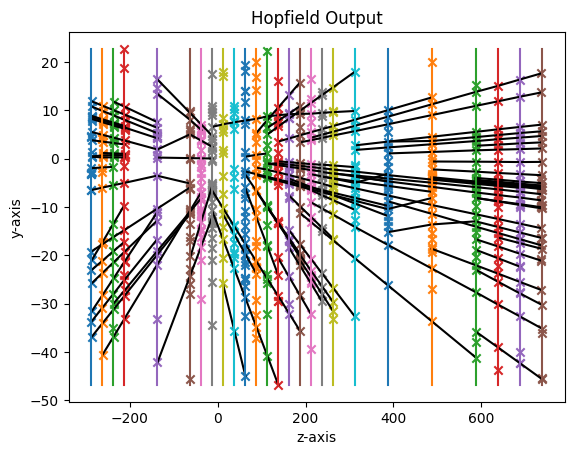

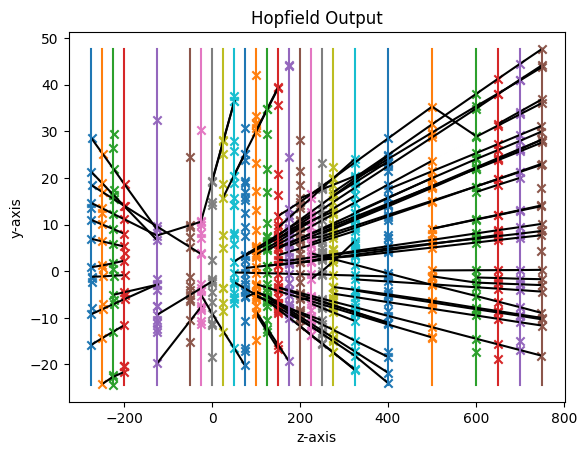

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_981
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_177

starting instance 50 out of 100

[INFO] Hopfield Networks initialized in 0 mins 1.05 seconds
energy: -284.6632379912635
energy: -332.24389070896336
energy: -327.2914490158345
energy: -291.44502600923875
energy: -329.294916294331
energy: -348.79495937160766
energy: -341.4893728412515
energy: -334.16277630333644
energy: -302.22482621151914
energy: -323.21068653160717
[HOPFIELD] converged network by below_mean after 0 mins 35.33 seconds; (energy: -321.48)
energy: -297.15078895019883
energy: -279.9796381160463
energy: -298.2768663848661
energy: -306.88749616392283
energy: -285.3429074832832
energy: -325.13533948448855
energy: -310.13172413316966
energy: -285.6413101744415
energy: -303.86326675980035
energy: -294.9635952113276
[HOPFIELD] conv

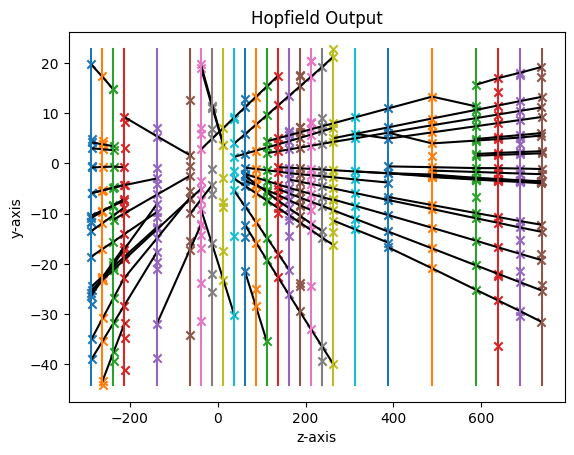

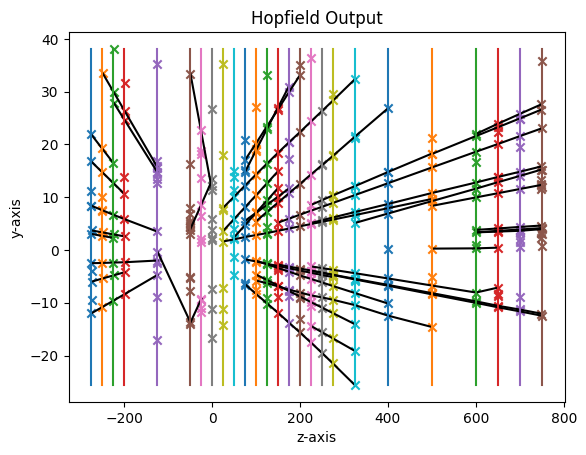

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_853

starting instance 51 out of 100

[INFO] Hopfield Networks initialized in 0 mins 1.09 seconds
energy: -229.40921925841988
energy: -251.02876711599268
energy: -254.42283659929186
energy: -240.44573093369434
energy: -241.46633905332638
energy: -241.62513081505477
energy: -247.92039625300063
energy: -236.45373102601044
energy: -243.2974326266011
energy: -254.5735192520157
[HOPFIELD] converged network by below_mean after 0 mins 14.87 seconds; (energy: -244.06)
energy: -324.0761064808061
energy: -298.5337508022215
energy: -326.5630086621142
energy: -283.2859138310663
energy: -310.5509903039296
energy: -332.063411202691
energy: -394.02978864830294
energy: -309.6531019649651
energy: -306.32694833130256
energy: -331.216711325699
[HOPFIELD] converged network by below_mean after 1 mins 8.84 seconds; (energy: -321.63)
[INFO] tracks extracted in 0 mins 0.04 seconds


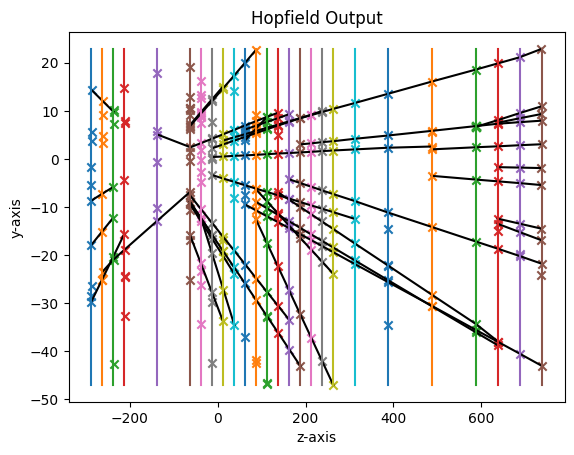

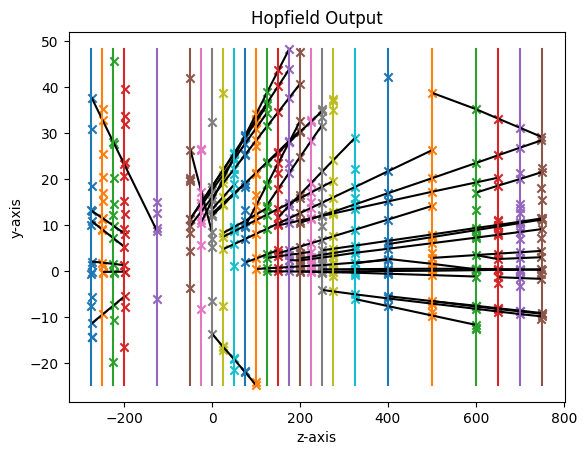

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_391

starting instance 52 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.13 seconds
energy: -113.40112063286492
energy: -122.3153888090611
energy: -120.47331583635186
energy: -124.54549812694417
energy: -121.44144543097548
energy: -121.28805338526699
energy: -125.19516198801368
energy: -125.52036899635
energy: -120.99114784447202
energy: -121.87911931960933
[HOPFIELD] converged network by below_mean after 0 mins 1.75 seconds; (energy: -121.71)
energy: -110.54595446995859
energy: -108.07881659854218
energy: -113.22772203864324
energy: -112.14315042575754
energy: -97.05446004265919
energy: -109.3016233961884
energy: -107.3468055243249
energy: -111.70980014115813
energy: -112.7651404463397
energy: -106.22541120033947
[HOPFIELD] converged network by below_mean after 0 mins 2.69 seconds; (energy: -108.84)
[INFO] tracks extracted in 0 mins 0.01 seconds


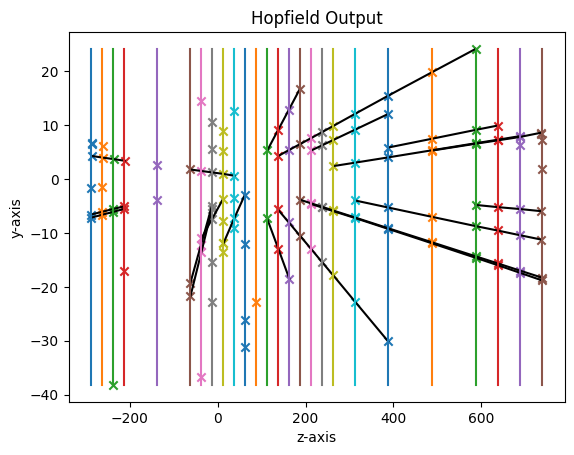

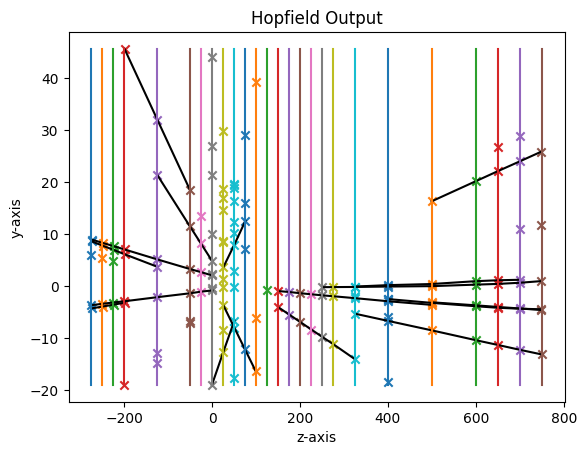

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_666

starting instance 53 out of 100

[INFO] Hopfield Networks initialized in 0 mins 5.79 seconds
energy: -326.15595058842615
energy: -298.99421308096936
energy: -341.1990964924045
energy: -329.7259748919224
energy: -383.02369056998396
energy: -297.9976323242875
energy: -332.58494167630175
energy: -374.8799804987708
energy: -333.9173200646823
energy: -280.1835779421198
[HOPFIELD] converged network by below_mean after 3 mins 42.05 seconds; (energy: -329.87)
energy: -465.7689321169026
energy: -476.9710632175017
energy: -435.80409612094627
energy: -404.41278295686334
energy: -513.5499751040991
energy: -487.12348184478367
energy: -476.43694625409427
energy: -470.3663821098563
energy: -552.6956403396724
energy: -496.34509589052254
[HOPFIELD] converged network by below_mean after 5 mins 42.31 seconds; (energy: -477.95)
[INFO] tracks extracted in 0 mins 0.13 seconds


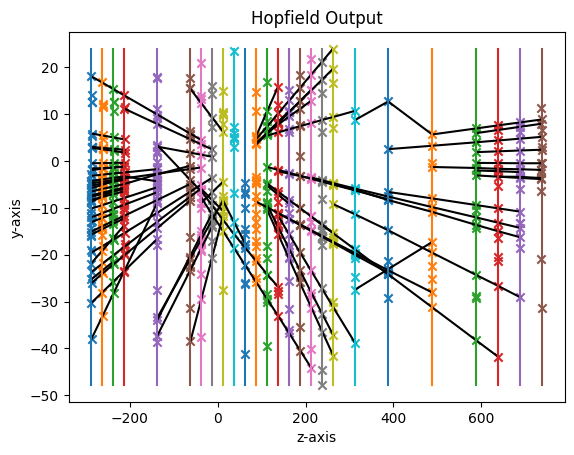

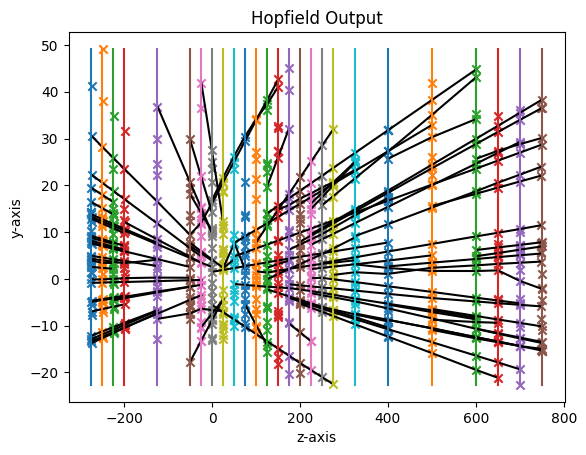

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_548

starting instance 54 out of 100

[INFO] Hopfield Networks initialized in 0 mins 1.79 seconds
energy: -306.4705092126193
energy: -308.91837705969704
energy: -312.85454496196706
energy: -304.04513321528907
energy: -279.9842218813199
energy: -294.9812529008487
energy: -291.6713391113334
energy: -312.92627280916236
energy: -295.6563351438282
energy: -316.92048787418565
[HOPFIELD] converged network by below_mean after 0 mins 49.31 seconds; (energy: -302.44)
energy: -323.9426148414279
energy: -287.17805443412544
energy: -278.0857290119124
energy: -247.9286037916011
energy: -297.6184017921281
energy: -313.56831948208537
energy: -322.2866755346018
energy: -307.8880821889716
energy: -361.4114661974516
energy: -308.16024129488443
[HOPFIELD] converged network by below_mean after 0 mins 51.63 seconds; (energy: -304.81)
[INFO] tracks extracted in 0 mins 0.06 seconds


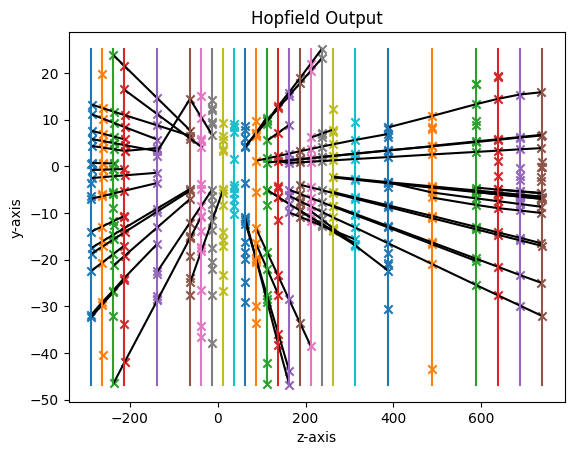

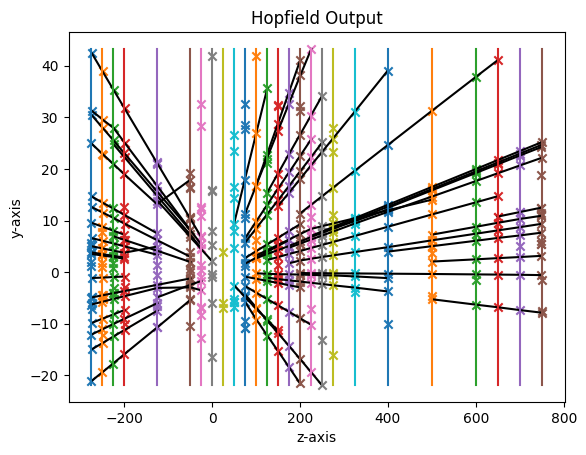

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_242
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_952
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_703
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_413
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_585

starting instance 55 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.10 seconds
energy: -111.06878328732029
energy: -112.44761470653303
energy: -125.01899977938359
energy: -117.27338154723594
energy: -115.70244107370578
energy: -118.13418587661755
energy: -112.15600140378089
energy: -115.04911232251189
energy: -112.84677081254546
energy: -109.68025313250

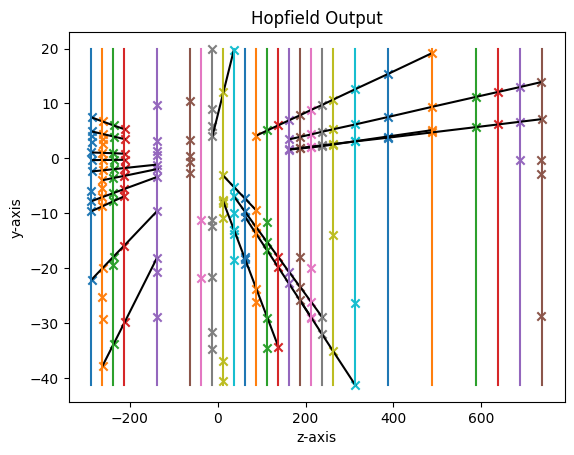

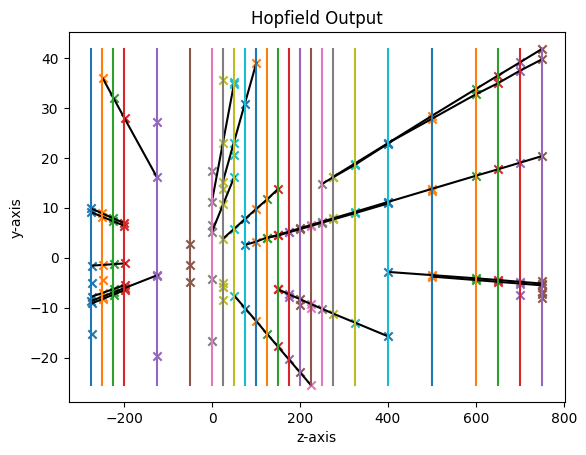

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_493
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_108
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_387
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_381
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_125

starting instance 56 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.23 seconds
energy: -146.1254965261932
energy: -134.16147509759617
energy: -138.26232583352666
energy: -139.03690439466186
energy: -142.40719501446114
energy: -140.17774491659165
energy: -141.42347713577988
energy: -131.0438011675874
energy: -134.92774218188856
energy: -143.8378598661622

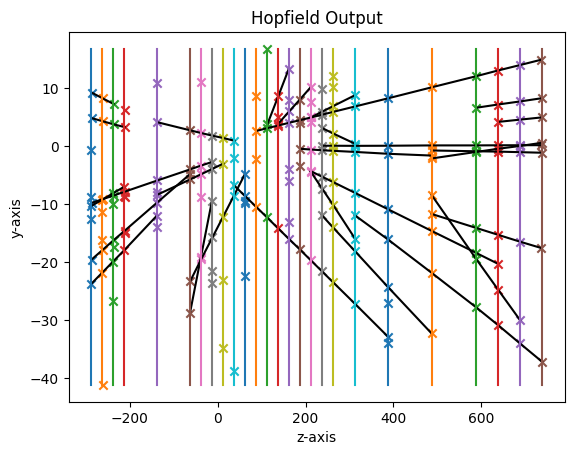

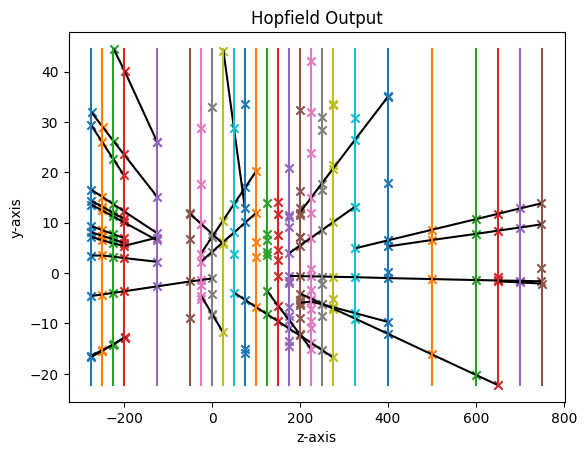

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_834
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_891

starting instance 57 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.41 seconds
energy: -237.11510639462156
energy: -222.14204410291728
energy: -212.75574778294435
energy: -228.1003429454002
energy: -227.88260327494598
energy: -220.33214750839787
energy: -233.69441143726527
energy: -231.41829679281506
energy: -231.87232544737665
energy: -231.23385566641525
[HOPFIELD] converged network by below_mean after 0 mins 24.56 seconds; (energy: -227.65)
energy: -135.47581406524932
energy: -123.91480099225059
energy: -135.99669576663683
energy: -132.09583911662187
energy: -129.33882994895123
energy: -129.8412592545879
energy: -134.88487924074002
energy: -134.30925184266283
energy: -134.9141219912418
energy: -140.79348210024574
[HOPFIEL

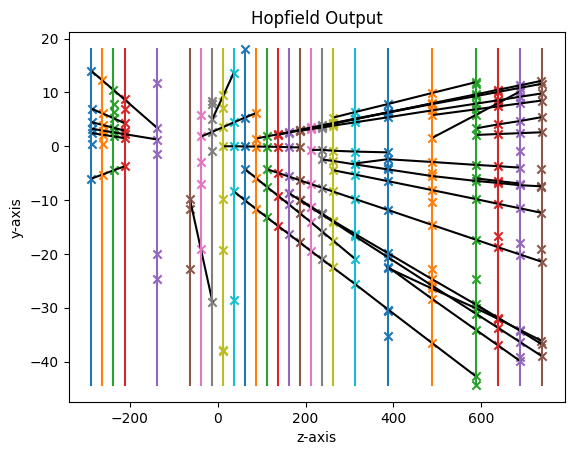

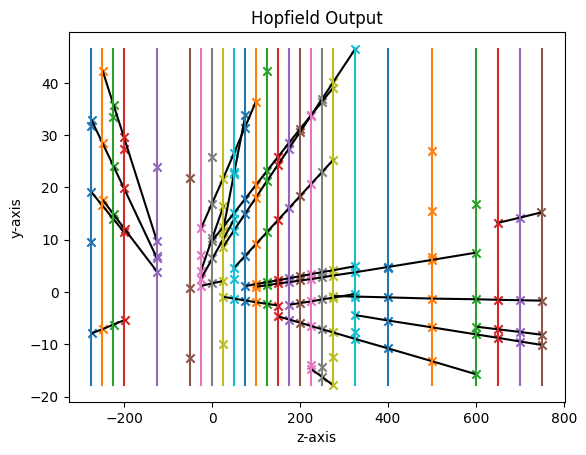

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_849
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_704
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_103
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_632
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_271
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_563

starting instance 58 out of 100

[INFO] Hopfield Networks initialized in 0 mins 12.58 seconds
energy: -491.0432872598297
energy: -459.7170598220988
energy: -464.2634131977594
energy: -510.6645652582298
energy: -522.080333248435
energy: -482.45

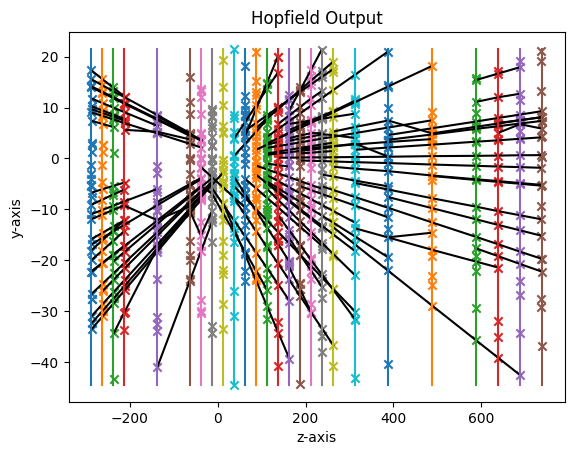

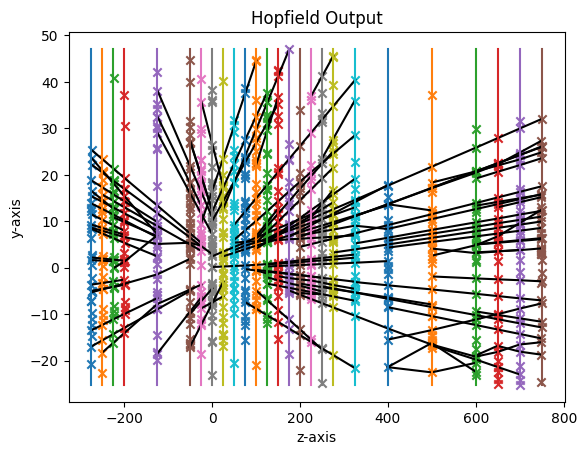

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_362

starting instance 59 out of 100

[INFO] Hopfield Networks initialized in 0 mins 3.16 seconds
energy: -447.34794624510573
energy: -384.2937562865602
energy: -442.90910897605136
energy: -408.93100143549077
energy: -523.4846241037941
energy: -525.345473158624
energy: -548.3745378478841
energy: -387.0721440683978
energy: -398.6679190155852
energy: -402.85002135265313
[HOPFIELD] converged network by below_mean after 2 mins 45.17 seconds; (energy: -446.93)
energy: -435.8192770555182
energy: -455.26982268669485
energy: -359.43628904034705
energy: -470.9970737414184
energy: -451.64484450218407
energy: -443.5678573510786
energy: -397.0638796091705
energy: -410.3089647079354
energy: -393.15248626043245
energy: -382.3046251809492
[HOPFIELD] converged network by below_mean after 1 mins 52.03 seconds; (energy: -419.96)
[INFO] tracks extracted in 0 mins 0.10 seconds


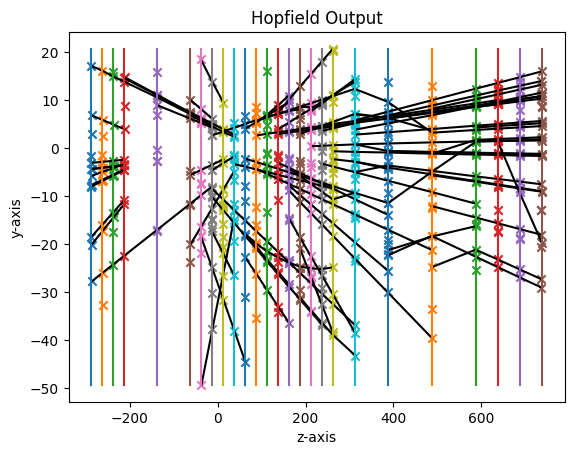

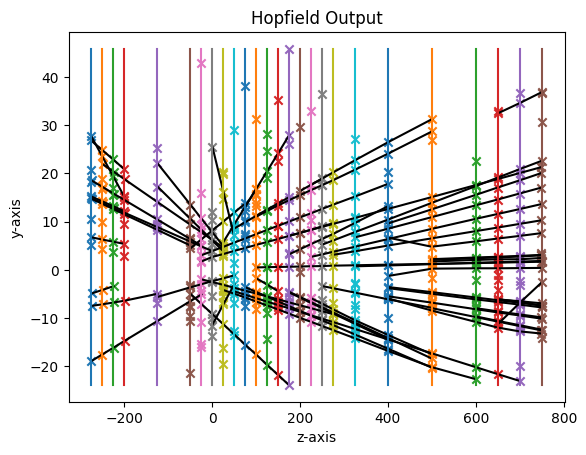

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_603
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_400
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_355

starting instance 60 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.48 seconds
energy: -235.59228262944598
energy: -193.50216616054647
energy: -246.2770223273701
energy: -244.86140874163328
energy: -230.76085320245537
energy: -236.19287414688586
energy: -224.74908763987773
energy: -222.61910289177357
energy: -238.07736990884752
energy: -223.33311085865566
[HOPFIELD] converged network by below_mean after 0 mins 20.30 seconds; (energy: -229.60)
energy: -246.34637843557397
energy: -244.9845131075832
energy: -249.9829853130624
energy: -260.5474603715285
energy: -249.6395056384056
energy: -258.71621461699

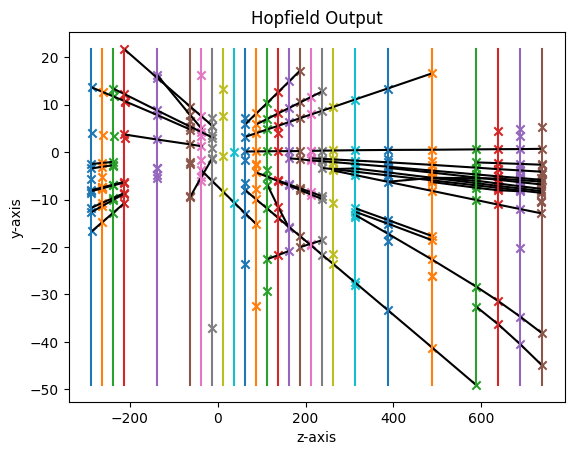

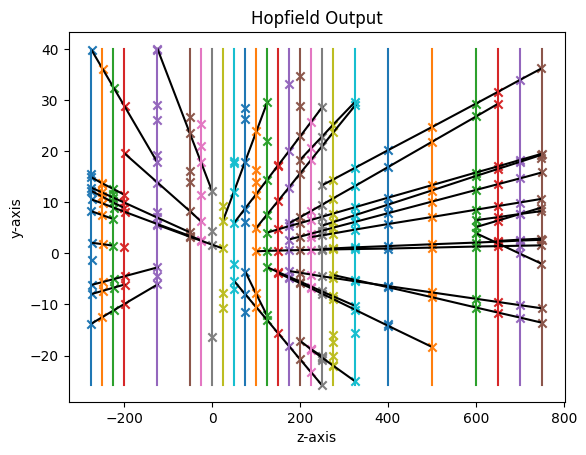

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_504
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_461

starting instance 61 out of 100

[INFO] Hopfield Networks initialized in 0 mins 6.19 seconds
energy: -464.3576326988157
energy: -549.21817571098
energy: -458.3108079341418
energy: -543.1498593470634
energy: -473.24110540656864
energy: -423.3179670371221
energy: -555.288221628085
energy: -394.5438073509293
energy: -530.6062273109667
energy: -567.0802177970434
[HOPFIELD] converged network by below_mean after 5 mins 26.84 seconds; (energy: -495.91)
energy: -447.4779639551311
energy: -403.63238410295884
energy: -467.12120784119287
energy: -436.2910338289755
energy: -457.507082124556
energy: -405.74443699687583
energy: -476.6164153078432
energy: -332.11541716095206
energy: -470.64104016806743
energy: -460.1777693129542
[HOPFIELD] converged ne

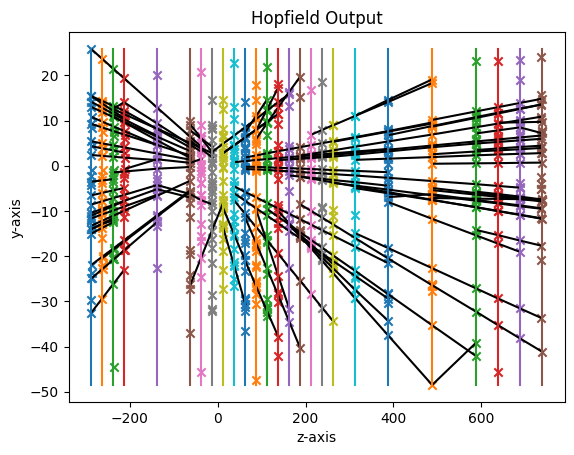

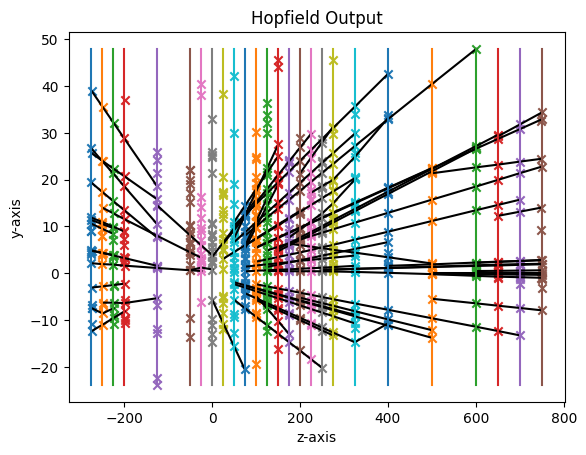

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_395
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_496
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_144

starting instance 62 out of 100

[INFO] Hopfield Networks initialized in 0 mins 8.33 seconds
energy: -544.1276990255996
energy: -539.2083572348051
energy: -648.6865323448066
energy: -589.0843899488756
energy: -547.1330291454075
energy: -550.61257512464
energy: -553.5866537187966
energy: -576.8789768259327
energy: -565.7985340312175
energy: -610.716997774587
[HOPFIELD] converged network by below_mean after 13 mins 5.74 seconds; (energy: -572.58)
energy: -460.3294150996529
energy: -509.39406092253
energy: -443.1236271398635
energy: -372.8882662509647
energy: -446.8252487764622
energy: -416.1130557857734
energy: -395

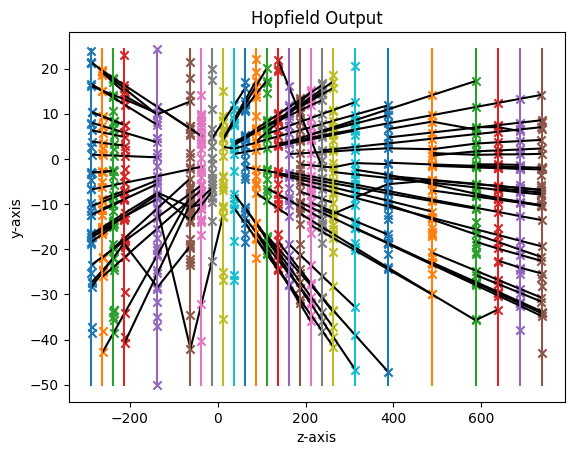

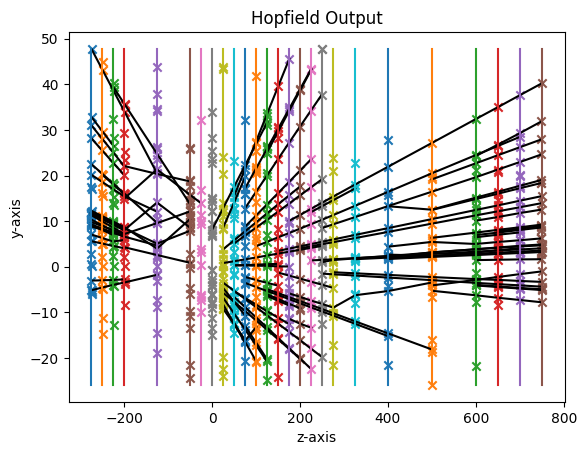

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_699

starting instance 63 out of 100

[INFO] Hopfield Networks initialized in 0 mins 7.52 seconds
energy: -413.3637458017254
energy: -427.6738097756372
energy: -440.91107493315604
energy: -429.4437143300525
energy: -505.8958268747544
energy: -510.2029862913188
energy: -396.6650408539307
energy: -467.71706520947885
energy: -434.05258957409865
energy: -464.1926254580595
[HOPFIELD] converged network by below_mean after 4 mins 26.33 seconds; (energy: -449.01)
energy: -556.6595963969119
energy: -543.072333977655
energy: -574.7651979595826
energy: -547.6080294706389
energy: -559.2512800490003
energy: -574.2682487529833
energy: -541.8670267706785
energy: -546.0495935379529
energy: -497.58207690829283
energy: -498.15978734604744
[HOPFIELD] converged network by below_mean after 8 mins 12.14 seconds; (energy: -543.93)
[INFO] tracks extracted in 0 mins 0.17 seconds


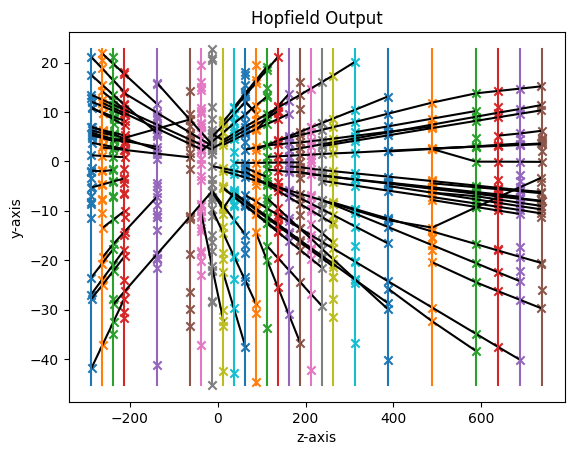

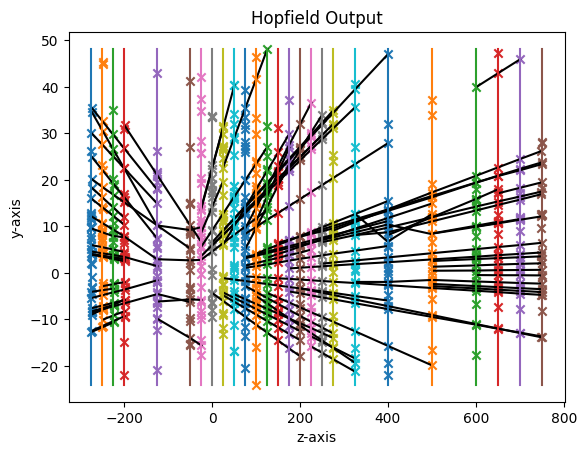

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_455
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_954

starting instance 64 out of 100

[INFO] Hopfield Networks initialized in 0 mins 1.44 seconds
energy: -278.25625425612225
energy: -260.07223597338464
energy: -327.0749457313616
energy: -292.0495004350809
energy: -334.9186916988074
energy: -267.7079829960445
energy: -263.2399358319226
energy: -314.34750721672
energy: -284.1475595323649
energy: -281.2282151612015
[HOPFIELD] converged network by below_mean after 1 mins 8.38 seconds; (energy: -290.30)
energy: -228.61541875858015
energy: -266.2950407141742
energy: -269.5720274929573
energy: -287.2165135150497
energy: -281.87807673865797
energy: -261.1167660066609
energy: -277.53581283125675
energy: -255.84853799978708
energy: -269.3983002449619
energy: -274.1505356105376
[HOPFIELD] converged n

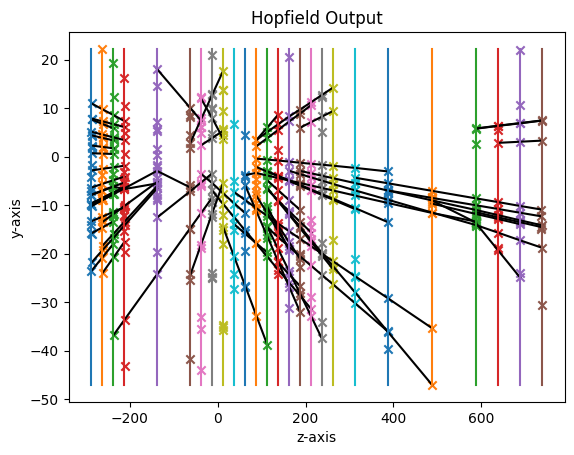

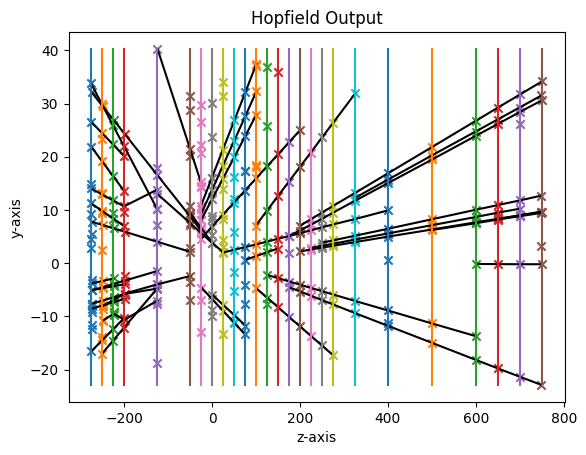

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_143

starting instance 65 out of 100

[INFO] Hopfield Networks initialized in 0 mins 2.55 seconds
energy: -292.97677356662814
energy: -316.44518189720725
energy: -298.3304201367339
energy: -308.8473020928795
energy: -276.6825971958729
energy: -291.5763627573635
energy: -275.46985499751486
energy: -303.5332688855949
energy: -285.6618306192262
energy: -301.5032929301347
[HOPFIELD] converged network by below_mean after 0 mins 56.76 seconds; (energy: -295.10)
energy: -346.9465509704997
energy: -284.6907516812457
energy: -292.36880594991607
energy: -354.4076027358882
energy: -274.13684931460784
energy: -264.8027567499132
energy: -351.2246243122737
energy: -339.09371551518365
energy: -410.1826910094169
energy: -303.8059463975035
[HOPFIELD] converged network by below_mean after 1 mins 25.25 seconds; (energy: -322.17)
[INFO] tracks extracted in 0 mins 0.07 seconds


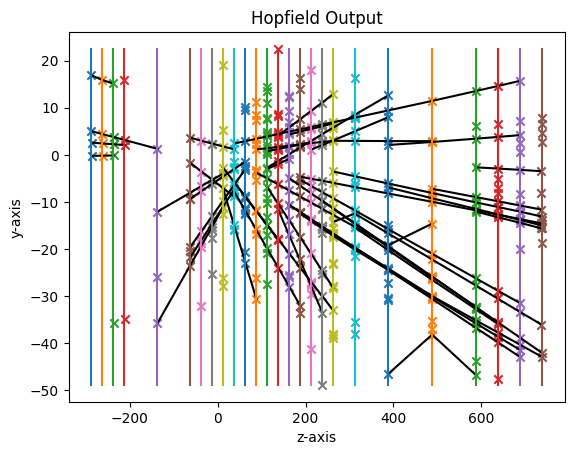

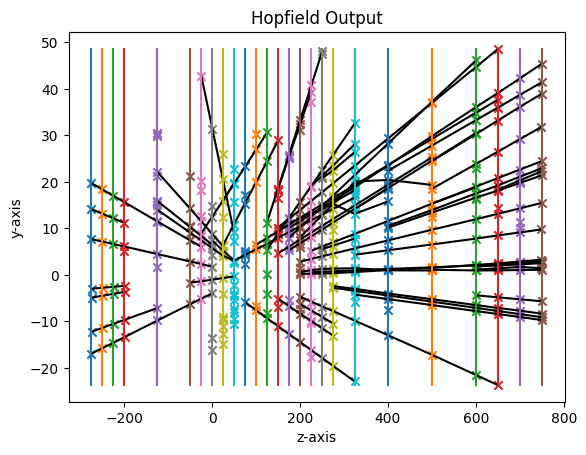

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_614
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_189
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_547
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_716
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_506
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_649

starting instance 66 out of 100

[INFO] Hopfield Networks initialized in 0 mins 5.48 seconds
energy: -417.5089401245738
energy: -388.80032679609565
energy: -530.1687658669649
energy: -537.2254245392267
energy: -437.7986525421816
energy: -445.0

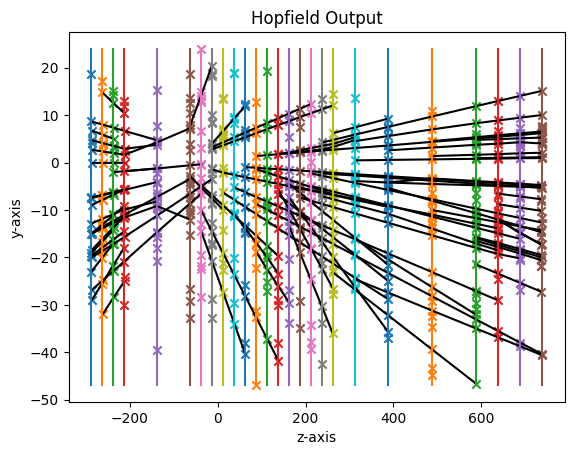

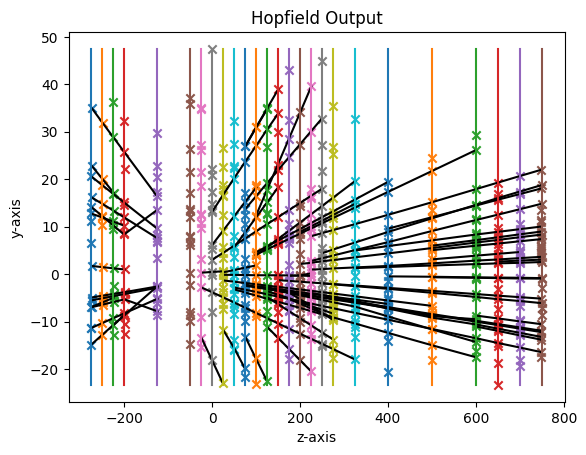

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_886
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_804

starting instance 67 out of 100

[INFO] Hopfield Networks initialized in 0 mins 5.83 seconds
energy: -409.9799527259914
energy: -405.38640005150734
energy: -477.5278918482068
energy: -389.3038530791341
energy: -373.96482557400157
energy: -379.0182059481752
energy: -361.2445761034867
energy: -410.8042717934615
energy: -413.11216863521713
energy: -394.5317957485864
[HOPFIELD] converged network by below_mean after 6 mins 21.27 seconds; (energy: -401.49)
energy: -393.32380580232063
energy: -472.54227748914496
energy: -439.1343061753321
energy: -347.7213561048739
energy: -448.67548757733135
energy: -493.77594101019946
energy: -403.12690347864753
energy: -444.4760509617058
energy: -425.64122824825586
energy: -420.71278406128306
[HOPFIELD] conv

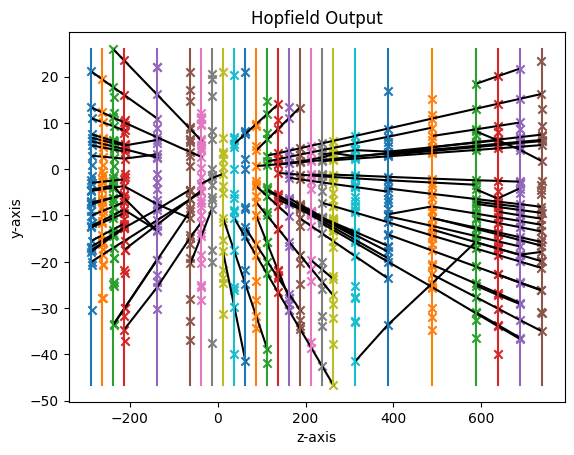

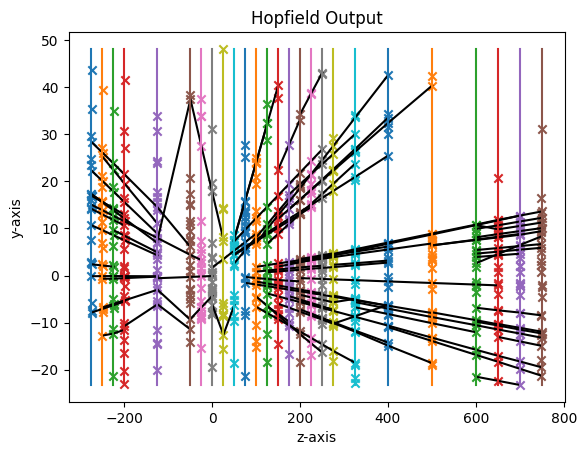

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_554

starting instance 68 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.73 seconds
energy: -300.35402494274086
energy: -324.71159150009004
energy: -314.4214684905716
energy: -324.7942089941385
energy: -291.80790763484424
energy: -283.1282187816082
energy: -324.6569072651012
energy: -308.80829164759183
energy: -318.22057502724977
energy: -303.169783066127
[HOPFIELD] converged network by below_mean after 0 mins 31.66 seconds; (energy: -309.41)
energy: -174.48960653897828
energy: -169.53508822905633
energy: -155.99720508231283
energy: -162.12897845519987
energy: -171.80890997074022
energy: -158.7645335857431
energy: -171.6466488662275
energy: -172.59747299422125
energy: -165.9558592979654
energy: -170.01634222619867
[HOPFIELD] converged network by below_mean after 0 mins 4.39 seconds; (energy: -167.29)
[INFO] tracks extracted in 0 mins 0.03 seconds


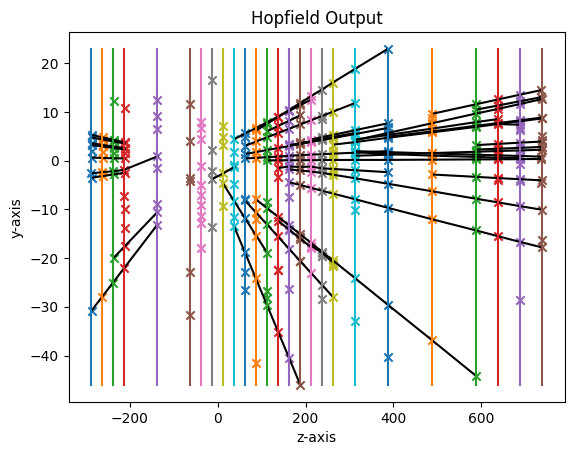

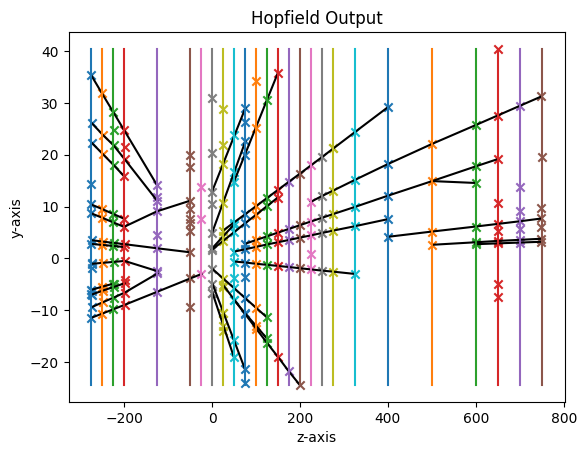

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_771
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_438
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_941

starting instance 69 out of 100

[INFO] Hopfield Networks initialized in 0 mins 2.34 seconds
energy: -376.65971845056924
energy: -361.3945398294604
energy: -404.87151068962606
energy: -358.6781848704741
energy: -402.02134116469244
energy: -362.5611193703784
energy: -345.94141146854423
energy: -328.6972600683791
energy: -343.54064542118215
energy: -318.78255941020126
[HOPFIELD] converged network by below_mean after 1 mins 30.44 seconds; (energy: -360.31)
energy: -285.3424721174784
energy: -282.73849107558556
energy: -255.14695532479774
energy: -282.37845842954596
energy: -308.2589610704714
energy: -258.508594193194

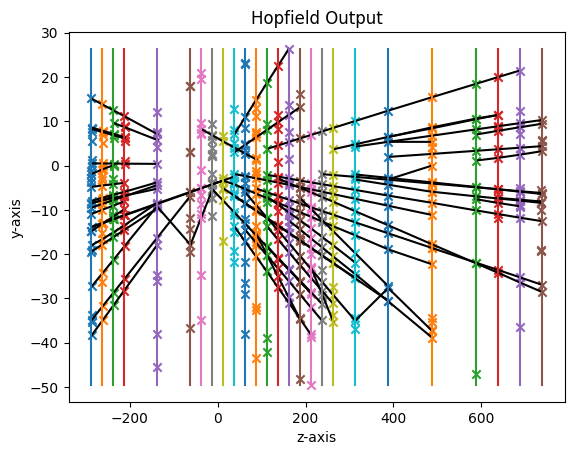

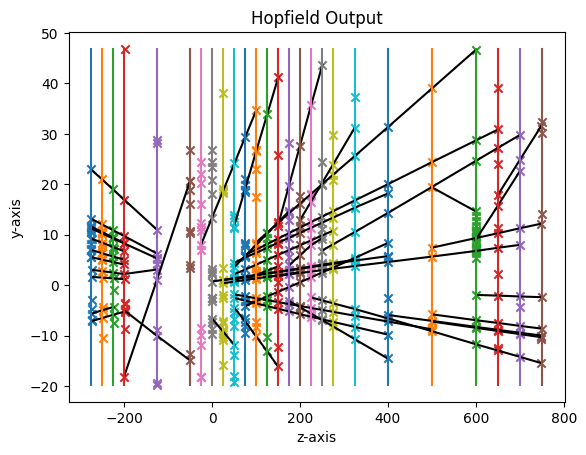

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_100

starting instance 70 out of 100

[INFO] Hopfield Networks initialized in 0 mins 3.90 seconds
energy: -377.79743715955107
energy: -361.5993527081197
energy: -375.98167362784653
energy: -299.9551843265944
energy: -361.90064857403587
energy: -344.1182222535026
energy: -343.19342938148384
energy: -305.3026285836024
energy: -342.3279155011816
energy: -359.203977512725
[HOPFIELD] converged network by below_mean after 1 mins 54.92 seconds; (energy: -347.14)
energy: -331.23033952200433
energy: -300.87335310965585
energy: -320.8998831519402
energy: -352.7800341355658
energy: -326.49771477961536
energy: -343.2115605483455
energy: -343.31014842851863
energy: -349.61383415897427
energy: -390.81623922158224
energy: -306.24781668131914
[HOPFIELD] converged network by below_mean after 2 mins 31.38 seconds; (energy: -336.55)
[INFO] tracks extracted in 0 mins 0.08 seconds


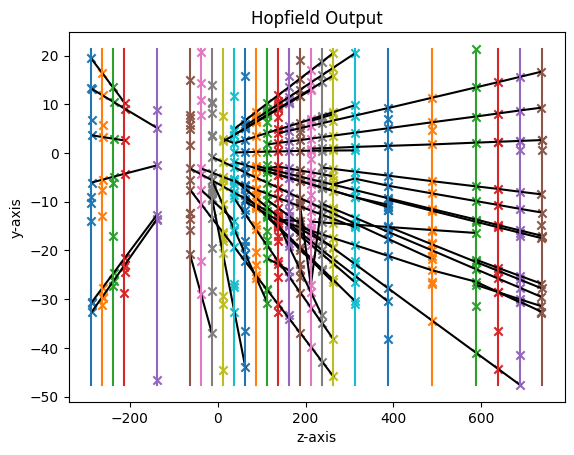

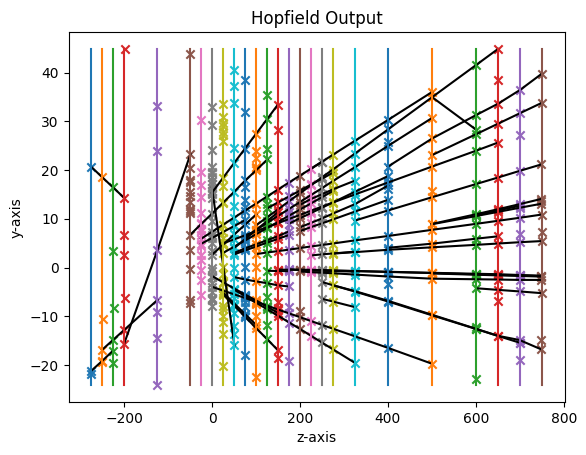

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_510
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_854
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_770
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_909

starting instance 71 out of 100

[INFO] Hopfield Networks initialized in 0 mins 1.24 seconds
energy: -301.8130034628495
energy: -308.2510339897904
energy: -318.1938372218333
energy: -311.683732936654
energy: -317.0051096591251
energy: -298.92127438896694
energy: -309.0030922588453
energy: -270.61563055865264
energy: -311.88356499593647
energy: -318.20086344124735
[HOPFIELD] converged network by below_mean after 0 mins 58.36 seconds; (energy: -306.56)
energy: -271.3243303648781
energy: -298.

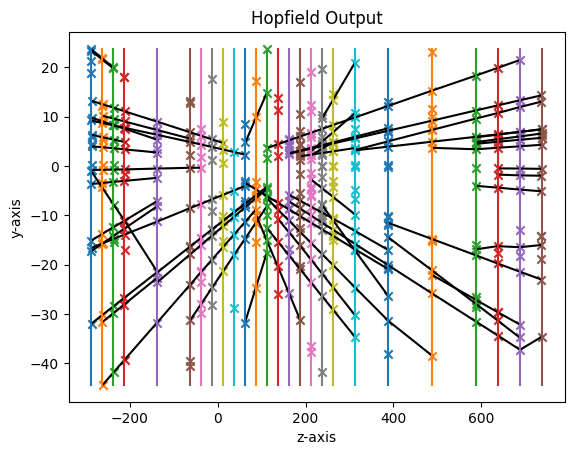

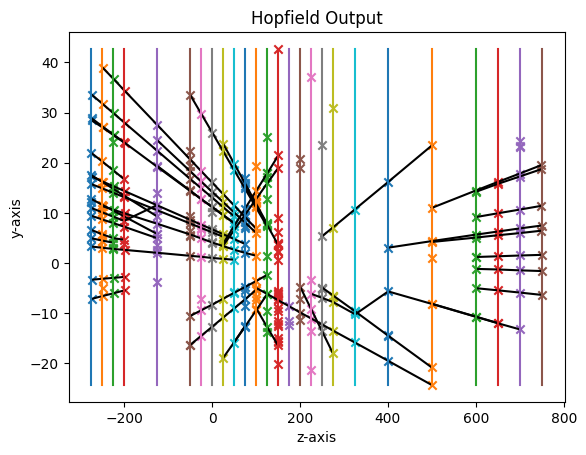

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_851

starting instance 72 out of 100

[INFO] Hopfield Networks initialized in 0 mins 4.48 seconds
energy: -374.3149103263579
energy: -371.002532490375
energy: -403.7053548274856
energy: -412.97879959611674
energy: -363.4261045410994
energy: -369.31604091001435
energy: -363.1073499044538
energy: -367.0818685050939
energy: -411.29116248131646
energy: -383.2669339312013
[HOPFIELD] converged network by below_mean after 2 mins 21.48 seconds; (energy: -381.95)
energy: -337.2800187756932
energy: -344.107033443834
energy: -399.8838840867954
energy: -349.2018843905941
energy: -360.0205568994351
energy: -365.24414336750726
energy: -426.9260733149773
energy: -333.97495510424983
energy: -385.2935340662059
energy: -329.2300110641674
[HOPFIELD] converged network by below_mean after 2 mins 50.15 seconds; (energy: -363.12)
[INFO] tracks extracted in 0 mins 0.11 seconds


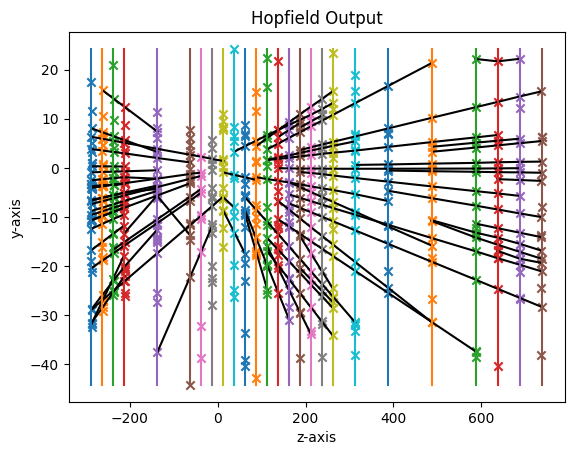

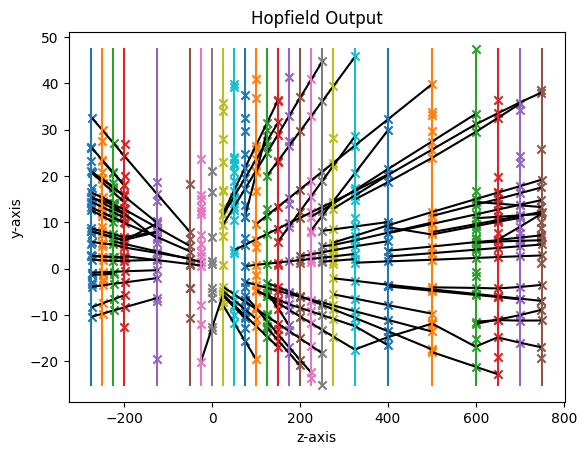

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_196

starting instance 73 out of 100

[INFO] Hopfield Networks initialized in 0 mins 3.36 seconds
energy: -286.78887379983354
energy: -299.91270628648874
energy: -324.2155251646248
energy: -292.6024863955252
energy: -296.9408409502275
energy: -300.7221997571283
energy: -292.4008496699324
energy: -274.4801366674023
energy: -310.2355081181046
energy: -288.1352080753897
[HOPFIELD] converged network by below_mean after 1 mins 2.10 seconds; (energy: -296.64)
energy: -354.0933313037167
energy: -325.0511794948078
energy: -333.4807157859593
energy: -286.1261764980914
energy: -292.54877057678266
energy: -334.5540552243134
energy: -347.0016335975759
energy: -294.9959478845374
energy: -334.62984267473223
energy: -340.3432947947896
[HOPFIELD] converged network by below_mean after 2 mins 18.90 seconds; (energy: -324.28)
[INFO] tracks extracted in 0 mins 0.08 seconds


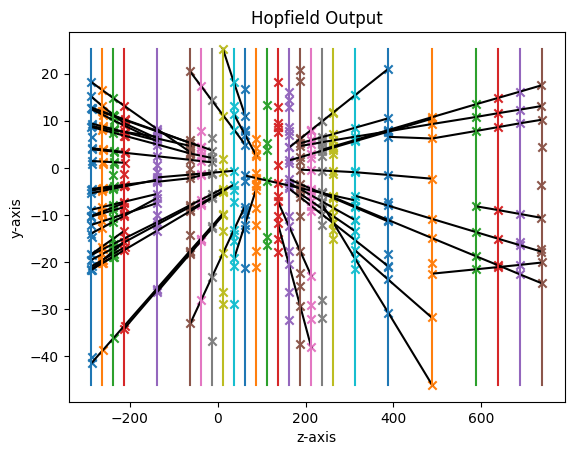

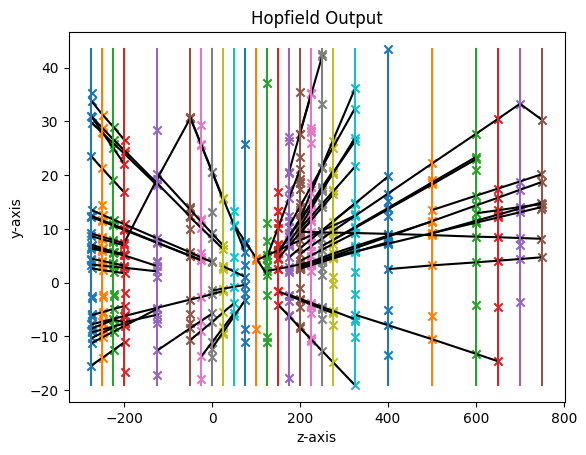

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_673

starting instance 74 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.49 seconds
energy: -144.50470505757335
energy: -149.27889706004535
energy: -137.8233685433985
energy: -132.65770416937522
energy: -138.2351015355148
energy: -139.2579040445458
energy: -133.8249907163051
energy: -138.0256588656519
energy: -153.89422514747602
energy: -149.7255842762791
[HOPFIELD] converged network by below_mean after 0 mins 6.17 seconds; (energy: -141.72)
energy: -202.70739001860937
energy: -202.81173356090707
energy: -193.58462116460817
energy: -207.0526944161924
energy: -207.5765013014341
energy: -184.9457245440864
energy: -203.15752356846474
energy: -196.6638352976578
energy: -201.91243106729002
energy: -185.6053264905196
[HOPFIELD] converged network by below_mean after 0 mins 16.71 seconds; (energy: -198.60)
[INFO] tracks extracted in 0 mins 0.02 seconds


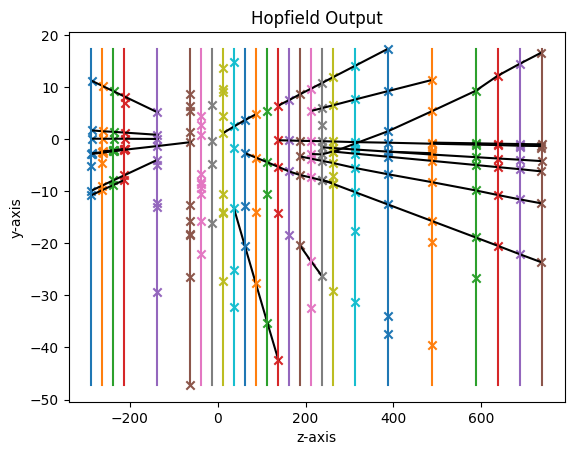

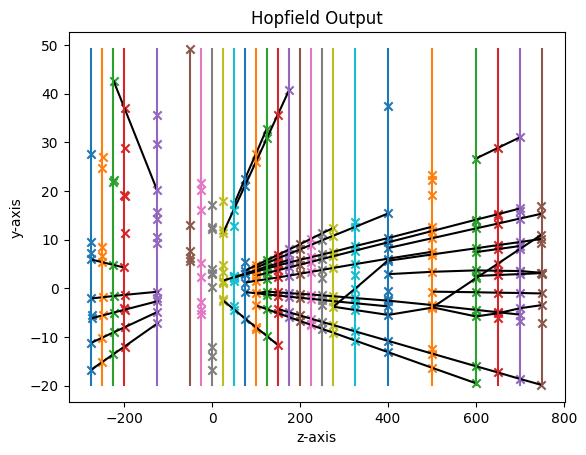

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_23

starting instance 75 out of 100

[INFO] Hopfield Networks initialized in 0 mins 7.87 seconds
energy: -541.9278855654294
energy: -446.8954041753484
energy: -432.9066160777604
energy: -506.91700972048494
energy: -475.05203137844535
energy: -449.7277378078608
energy: -472.8185363464111
energy: -492.18173230993136
energy: -494.1073470367352
energy: -424.8414594976391
[HOPFIELD] converged network by below_mean after 8 mins 7.87 seconds; (energy: -473.74)
energy: -471.9003175949397
energy: -436.3157061187157
energy: -399.9916333462976
energy: -383.14052034878483
energy: -418.4835289296127
energy: -413.43032515612003
energy: -369.7295792530596
energy: -409.31521376933614
energy: -388.1760450294171
energy: -490.8183309256272
[HOPFIELD] converged network by below_mean after 10 mins 11.88 seconds; (energy: -418.13)
[INFO] tracks extracted in 0 mins 0.18 seconds


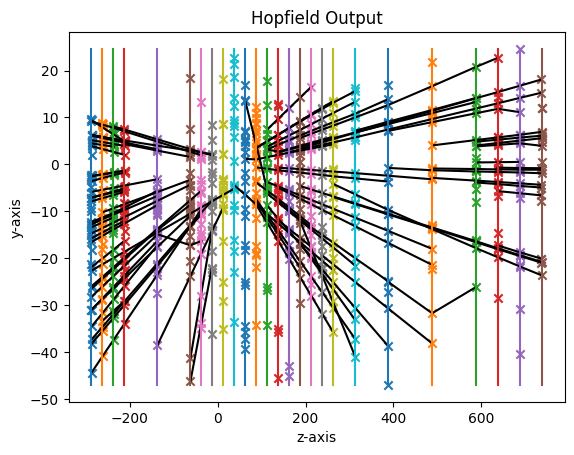

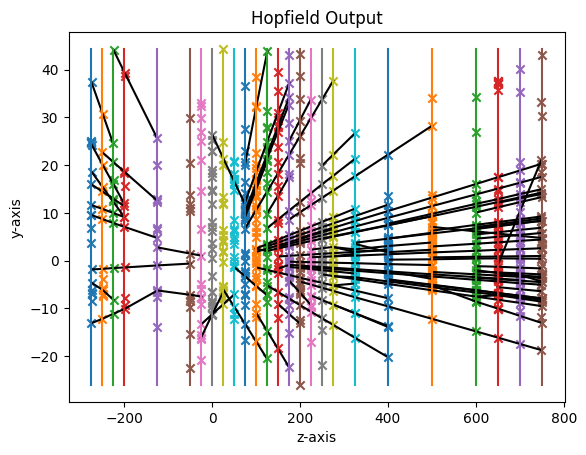

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_753
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_899
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_104

starting instance 76 out of 100

[INFO] Hopfield Networks initialized in 0 mins 4.96 seconds
energy: -502.44589368085695
energy: -479.7921211093349
energy: -556.052168900301
energy: -576.4622542626671
energy: -507.5007496492222
energy: -541.185766910713
energy: -513.2923996024866
energy: -511.8286494745479
energy: -538.7326359993117
energy: -626.3050089646106
[HOPFIELD] converged network by below_mean after 6 mins 43.86 seconds; (energy: -535.36)
energy: -405.6151741088652
energy: -289.1130030633743
energy: -359.6458964161664
energy: -361.55642958529387
energy: -351.588115715803
energy: -343.9746220455695
energy: 

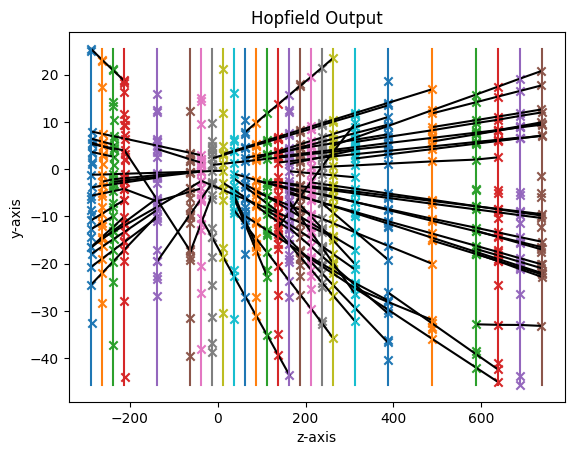

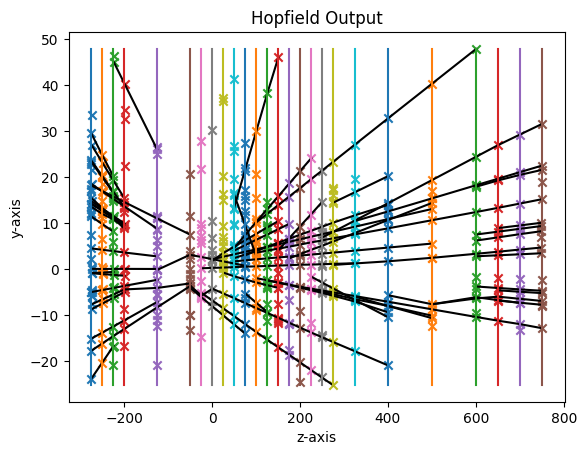

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_33
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_714

starting instance 77 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.16 seconds
energy: -129.9841892444802
energy: -138.04660037386628
energy: -133.23292725131424
energy: -133.44479697881889
energy: -133.47738052539918
energy: -128.9765296837981
energy: -130.01312395951254
energy: -126.6245021797388
energy: -127.5733164686617
energy: -132.01949058928534
[HOPFIELD] converged network by below_mean after 0 mins 1.86 seconds; (energy: -131.34)
energy: -57.82802951439566
energy: -59.62368511834878
energy: -58.81023552089436
energy: -58.6392564004748
energy: -59.62368511834878
energy: -59.90225732388026
energy: -59.62368511834878
energy: -59.62368511834878
energy: -59.62368511834878
energy: -58.5006144630354
[HOPFIELD] converged ne

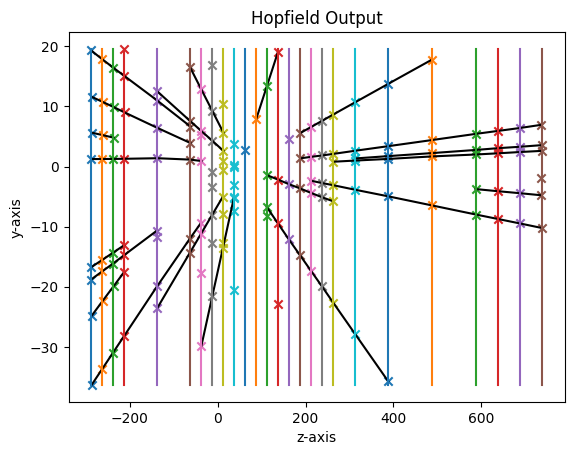

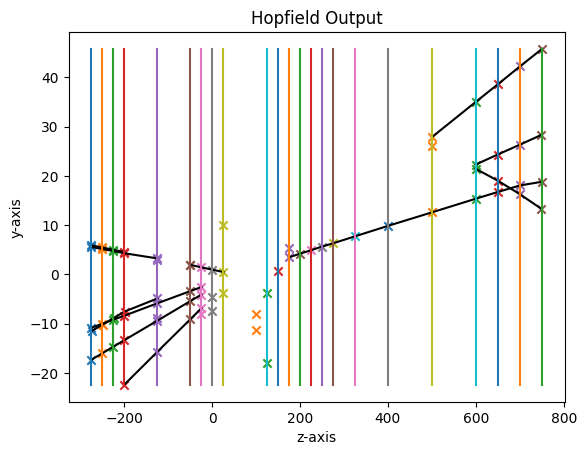

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_363
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_733

starting instance 78 out of 100

[INFO] Hopfield Networks initialized in 0 mins 1.83 seconds
energy: -333.59566060668806
energy: -315.6956995116084
energy: -341.00652720554876
energy: -330.7883561364996
energy: -330.9729451813604
energy: -325.5962764108457
energy: -272.3819224220093
energy: -341.18166109164827
energy: -347.03620161009104
energy: -325.15701660048643
[HOPFIELD] converged network by below_mean after 1 mins 1.88 seconds; (energy: -326.34)
energy: -360.99601118820885
energy: -272.0001478446412
energy: -314.3987758043357
energy: -350.24517787462594
energy: -236.72929970992817
energy: -343.67294480505245
energy: -338.39291689492353
energy: -322.0550128375547
energy: -305.36554187990896
energy: -302.88157133791077
[HOPFIELD] con

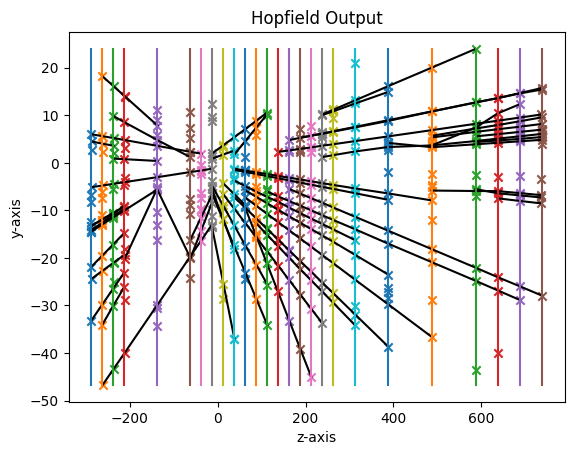

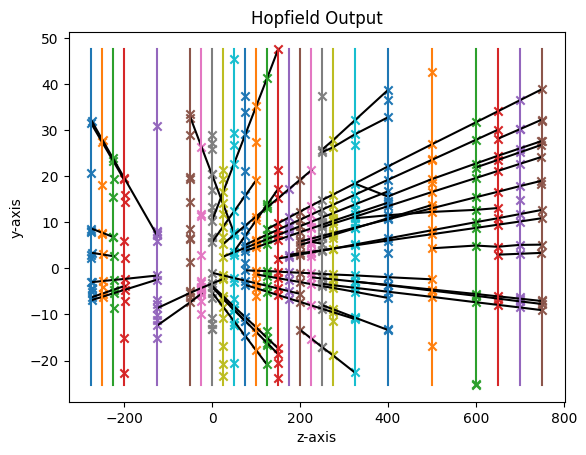

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_727
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_20

starting instance 79 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.98 seconds
energy: -223.9541642181165
energy: -247.3061449327532
energy: -216.23951449970434
energy: -226.41903923635186
energy: -215.16716347283676
energy: -239.19208413023975
energy: -239.2260552188854
energy: -227.04280528750053
energy: -243.9913689983632
energy: -228.74682847831838
[HOPFIELD] converged network by below_mean after 0 mins 43.51 seconds; (energy: -230.73)
energy: -250.12942819202667
energy: -242.78694985870516
energy: -250.92798345590086
energy: -256.99464906765195
energy: -257.0310415823455
energy: -260.78763607691167
energy: -247.89382291855827
energy: -253.7436918711998
energy: -249.9617057164343
energy: -271.94773496693415
[HOPFIELD] co

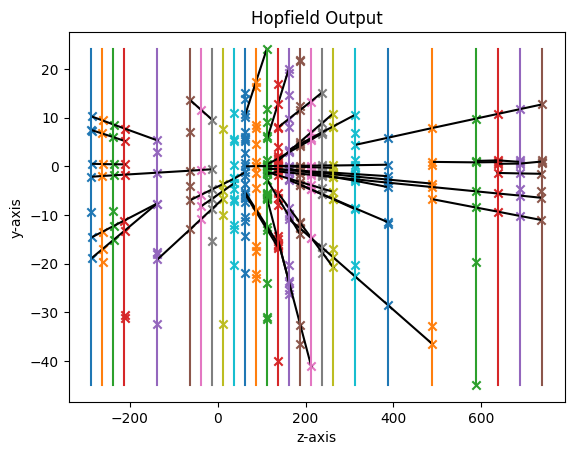

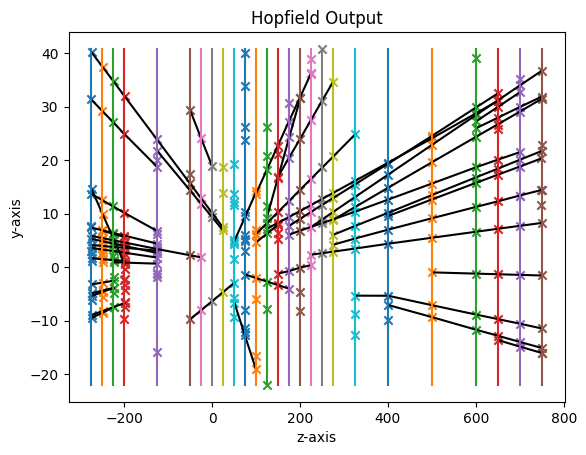

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_372
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_424
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_572

starting instance 80 out of 100

[INFO] Hopfield Networks initialized in 0 mins 4.49 seconds
energy: -405.57520522012624
energy: -432.4617728094031
energy: -389.2080527001648
energy: -461.88307101871675
energy: -425.5474878605455
energy: -388.7615869362466
energy: -369.0910167555429
energy: -380.61669459471574
energy: -381.7671916054495
energy: -380.5249990471509
[HOPFIELD] converged network by below_mean after 2 mins 7.85 seconds; (energy: -401.54)
energy: -411.61903496620397
energy: -361.47618353383274
energy: -399.6139887807119
energy: -398.9253647597733
energy: -398.54247300182146
energy: -368.381600045838
ene

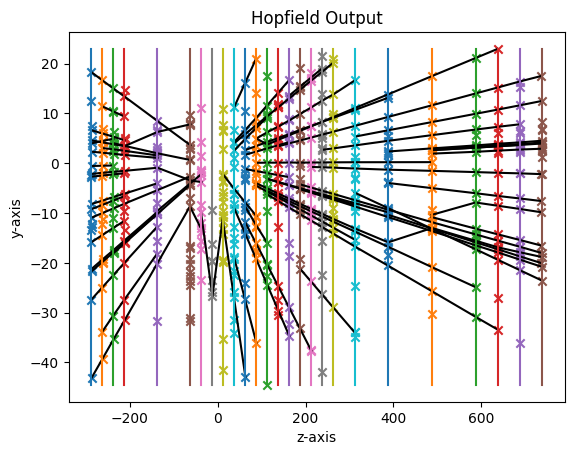

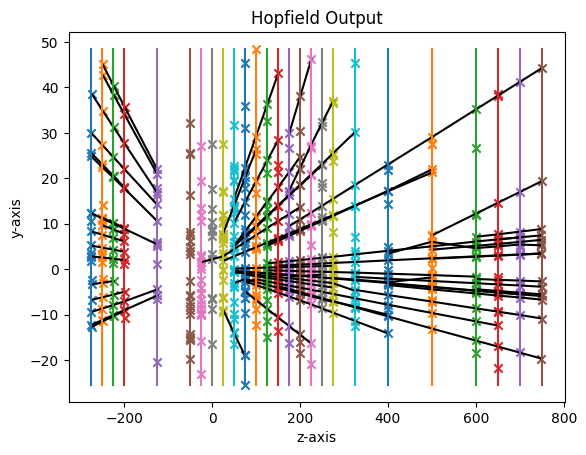

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_484
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_201

starting instance 81 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.53 seconds
energy: -192.85914611978498
energy: -187.04215929654643
energy: -189.22315963587764
energy: -202.1080333063548
energy: -207.7458673966782
energy: -193.7941351624055
energy: -169.9484344929212
energy: -197.11047866783207
energy: -195.67911299172403
energy: -185.31207077324166
[HOPFIELD] converged network by below_mean after 0 mins 16.14 seconds; (energy: -192.08)
energy: -188.01558729182304
energy: -194.0719908100308
energy: -189.37412190709554
energy: -196.79270416981683
energy: -179.4108686656528
energy: -203.42133664362188
energy: -202.6859545515513
energy: -196.81261880354072
energy: -185.26417286605013
energy: -196.20173586686727
[HOPFIELD] c

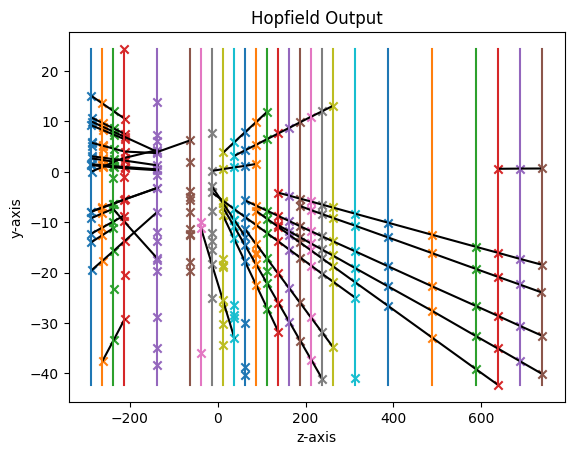

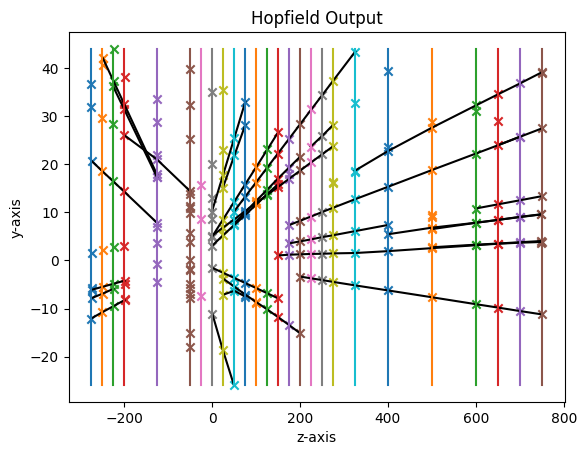

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_629
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_961
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_534
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_336
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_178
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_281
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_388
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_ev

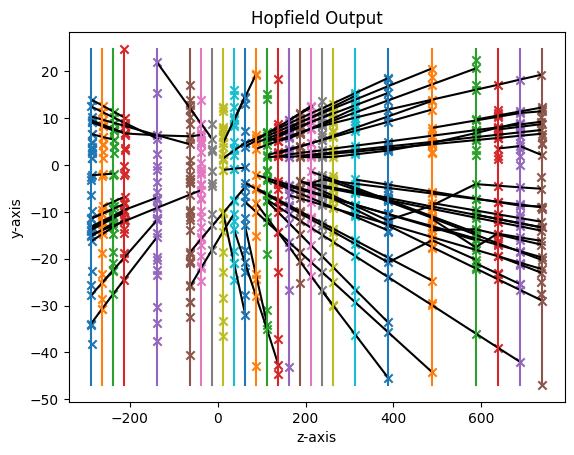

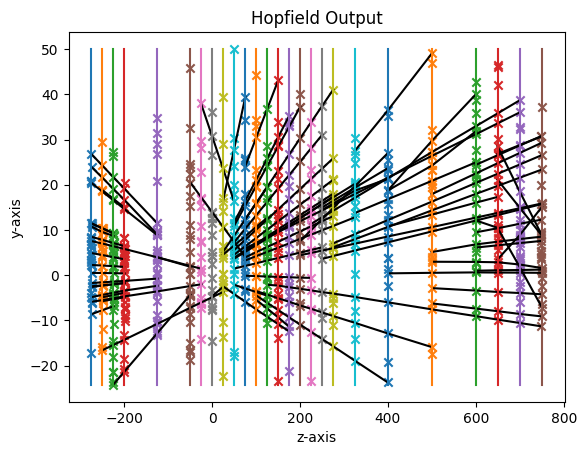

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_410
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_360
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_299
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_365
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_122
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_389

starting instance 83 out of 100

[INFO] Hopfield Networks initialized in 0 mins 7.17 seconds
energy: -420.208066168125
energy: -380.10247568849087
energy: -344.94157131503624
energy: -423.6385400542986
energy: -404.7295498493063
energy: -434.8

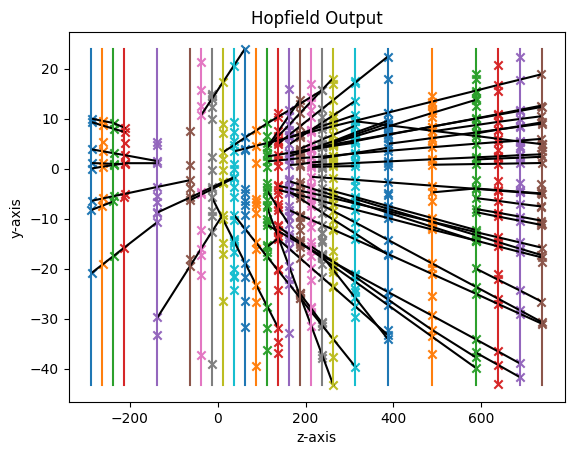

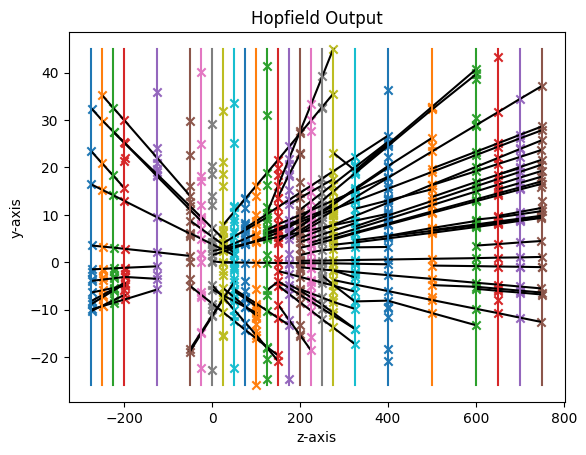

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_245

starting instance 84 out of 100

[INFO] Hopfield Networks initialized in 0 mins 6.18 seconds
energy: -553.4556662879122
energy: -521.2851676529107
energy: -530.4293232862233
energy: -471.4016050956834
energy: -587.8076299832078
energy: -495.2882481609587
energy: -520.9184802935808
energy: -463.12812872858507
energy: -464.38112510875226
energy: -544.311973889113
[HOPFIELD] converged network by below_mean after 8 mins 18.68 seconds; (energy: -515.24)
energy: -296.44624943386594
energy: -313.324127056371
energy: -326.23079041021924
energy: -323.4980411557149
energy: -344.60500631770543
energy: -344.64348710304694
energy: -329.99912916639926
energy: -289.3984535142731
energy: -357.697060273565
energy: -327.09224242368475
[HOPFIELD] converged network by below_mean after 1 mins 35.09 seconds; (energy: -325.29)
[INFO] tracks extracted in 0 mins 0.13 seconds


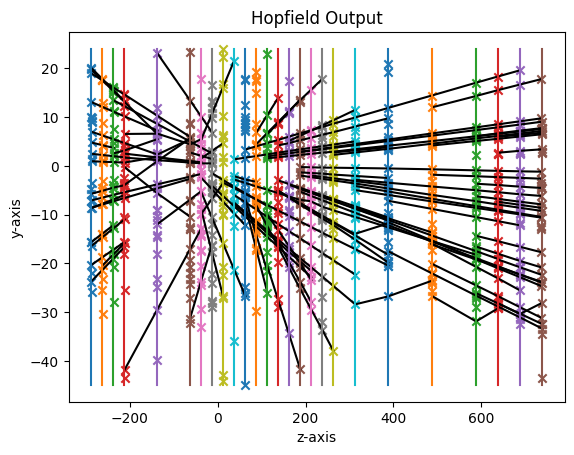

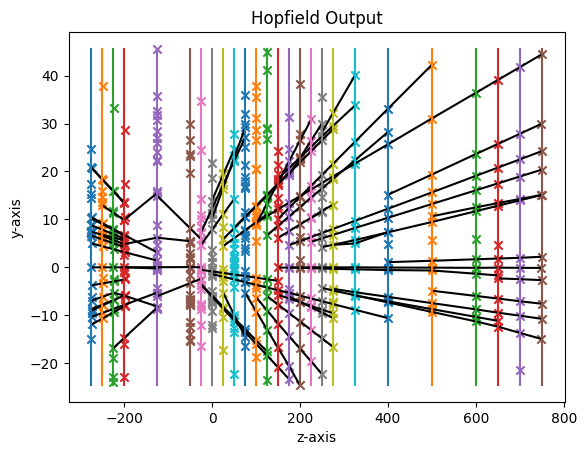

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_427

starting instance 85 out of 100

[INFO] Hopfield Networks initialized in 0 mins 3.39 seconds
energy: -358.82547901069825
energy: -343.87702026441
energy: -333.6303486579856
energy: -320.0538462252944
energy: -314.50035117386125
energy: -342.05745869993103
energy: -330.0462931393506
energy: -306.1131168209692
energy: -326.76669934516536
energy: -299.99409365303626
[HOPFIELD] converged network by below_mean after 0 mins 50.22 seconds; (energy: -327.59)
energy: -356.57856793890005
energy: -360.78065244376717
energy: -326.22485218531324
energy: -374.9678795724727
energy: -357.762091176782
energy: -362.48633342728044
energy: -315.0933775549102
energy: -373.9500681013464
energy: -353.2147690181283
energy: -380.91212025256806
[HOPFIELD] converged network by below_mean after 3 mins 35.91 seconds; (energy: -356.20)
[INFO] tracks extracted in 0 mins 0.08 seconds


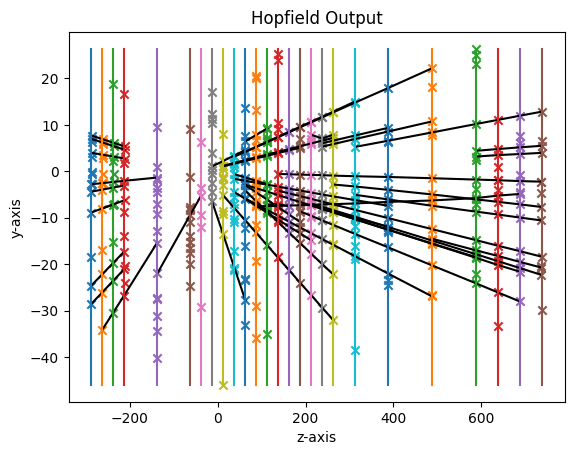

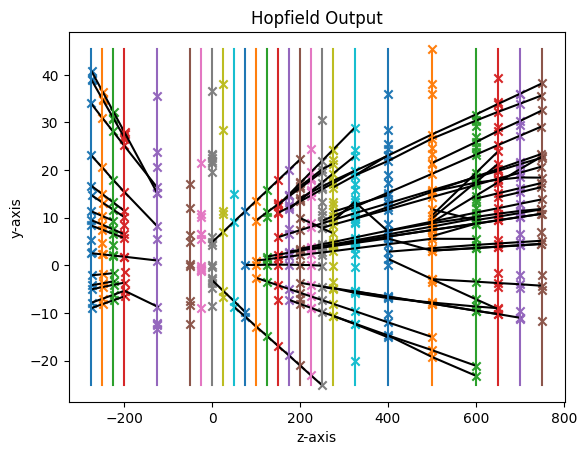

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_868
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_268

starting instance 86 out of 100

[INFO] Hopfield Networks initialized in 0 mins 11.17 seconds
energy: -485.28223804673473
energy: -517.2887039167753
energy: -451.67173018332375
energy: -455.48485618529844
energy: -613.0371190863318
energy: -490.29635719690964
energy: -635.2809073785787
energy: -487.15237191865845
energy: -493.7421817126754
energy: -483.5841197705391
[HOPFIELD] converged network by below_mean after 8 mins 7.88 seconds; (energy: -511.28)
energy: -511.303378758989
energy: -474.74375773955916
energy: -491.0472208571742
energy: -456.8052101920968
energy: -524.1285758006352
energy: -510.7064759965625
energy: -485.2807176089274
energy: -487.89502950325874
energy: -517.159595525201
energy: -534.7112647582785
[HOPFIELD] converged

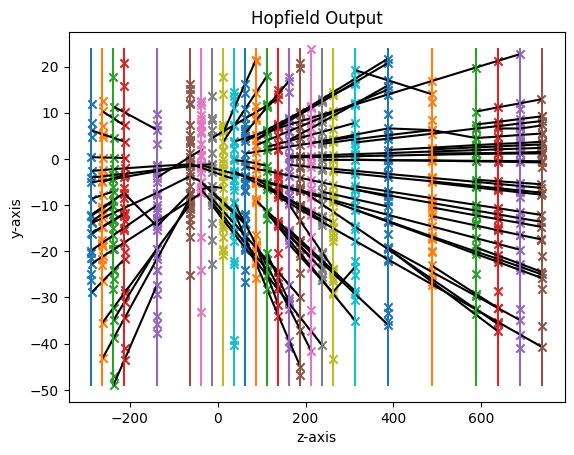

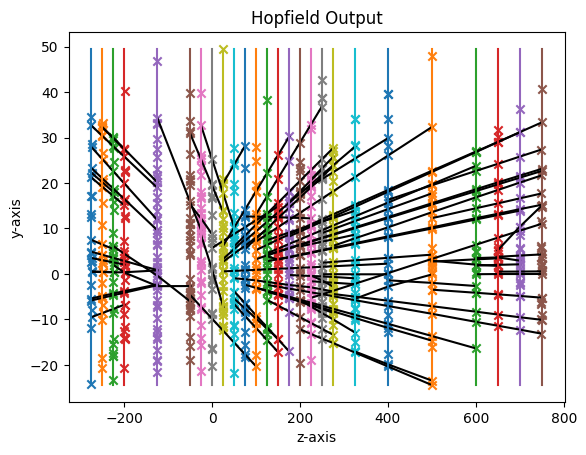

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_529
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_437

starting instance 87 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.68 seconds
energy: -249.70376037896992
energy: -266.34214800926327
energy: -262.152794489033
energy: -302.2961907904876
energy: -293.6293358982147
energy: -273.52545056403704
energy: -295.973496766276
energy: -270.60919454941416
energy: -294.3548001407152
energy: -256.8698889622709
[HOPFIELD] converged network by below_mean after 0 mins 30.57 seconds; (energy: -276.55)
energy: -244.80162796645251
energy: -307.7459140273661
energy: -300.9405715490755
energy: -298.03718019222845
energy: -282.8591334611993
energy: -270.71358747375575
energy: -299.96892757466367
energy: -302.6505148170192
energy: -309.71831441243216
energy: -293.87656793783117
[HOPFIELD] conver

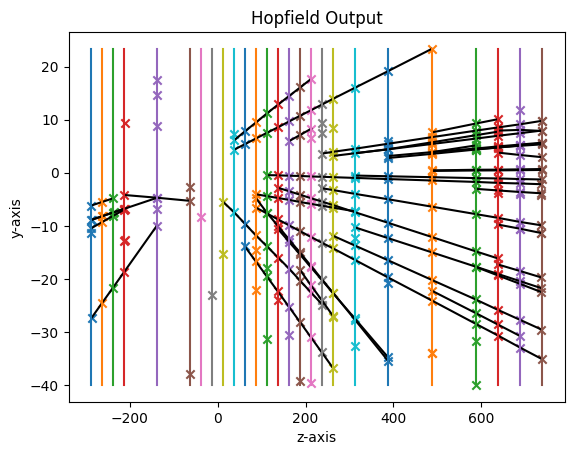

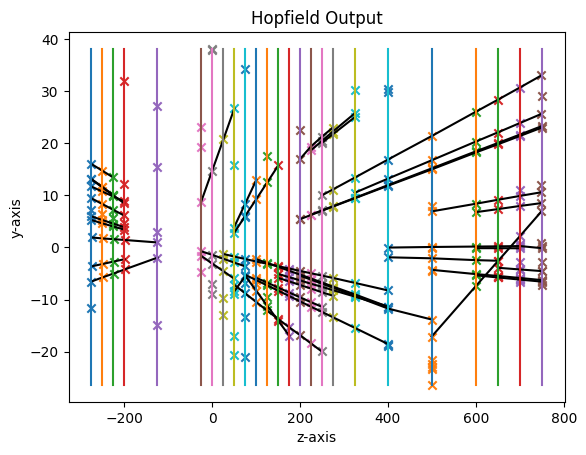

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_718

starting instance 88 out of 100

[INFO] Hopfield Networks initialized in 0 mins 7.90 seconds
energy: -547.4001871834921
energy: -608.7337499216911
energy: -463.9773083112105
energy: -539.1290488022506
energy: -494.73867629217875
energy: -514.3832213275767
energy: -608.3190897181058
energy: -585.782319750943
energy: -430.0250568246742
energy: -503.4632753711623
[HOPFIELD] converged network by below_mean after 6 mins 17.25 seconds; (energy: -529.60)
energy: -405.48286516250164
energy: -433.7398484678632
energy: -428.8374478894545
energy: -420.9594800702801
energy: -394.16416919721604
energy: -453.4261021917076
energy: -463.83253148344437
energy: -391.04528361843126
energy: -442.5774840855262
energy: -391.9121307756882
[HOPFIELD] converged network by below_mean after 4 mins 16.03 seconds; (energy: -422.60)
[INFO] tracks extracted in 0 mins 0.15 seconds


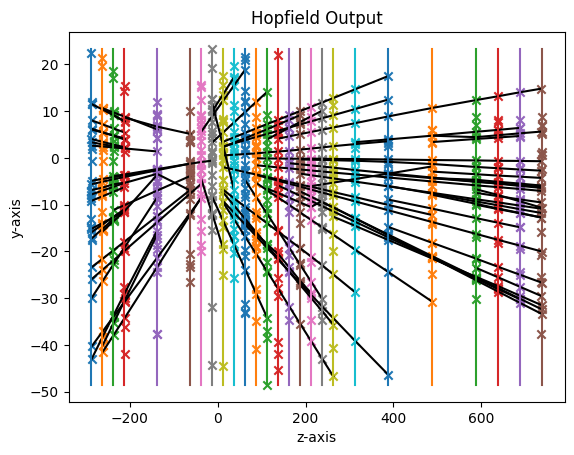

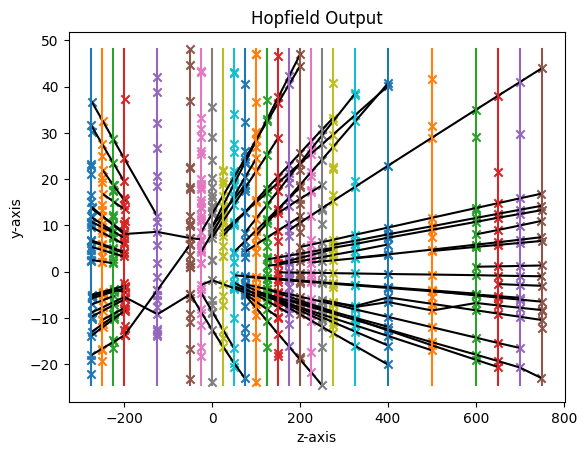

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_795
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_303
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_217
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_869
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_744

starting instance 89 out of 100

[INFO] Hopfield Networks initialized in 0 mins 4.66 seconds
energy: -310.8976758223293
energy: -336.28275801916453
energy: -379.8038858909478
energy: -356.32806433166763
energy: -483.13651775546845
energy: -340.3142381435695
energy: -328.52953373003703
energy: -461.37775790453003
energy: -350.72474922459776
energy: -386.8315939417718


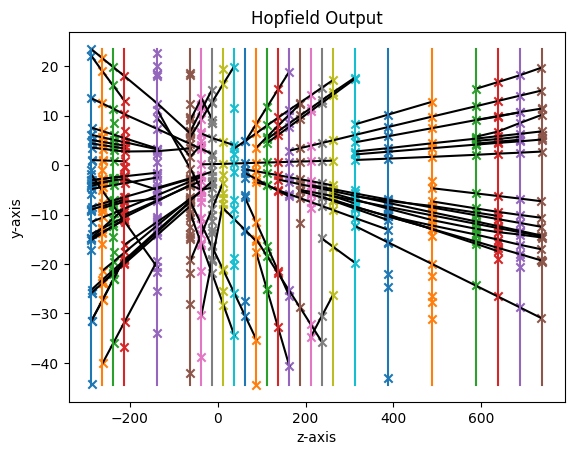

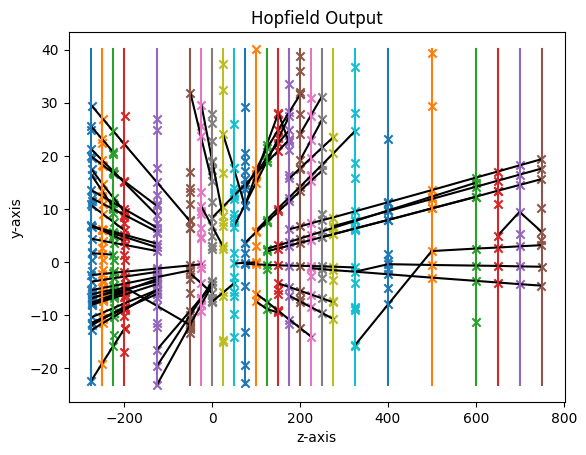

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_434
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_670
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_522
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_823
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_326
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_732
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_300
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_ev

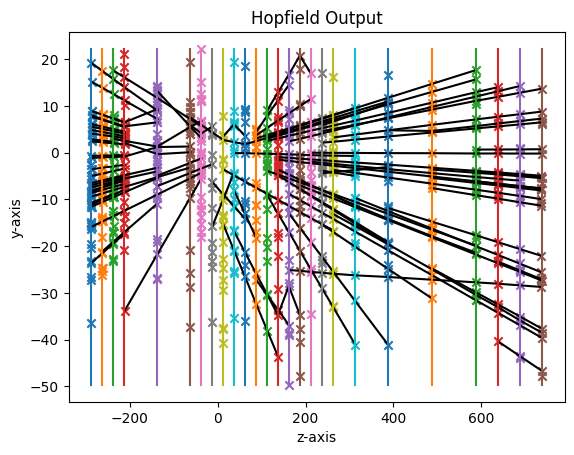

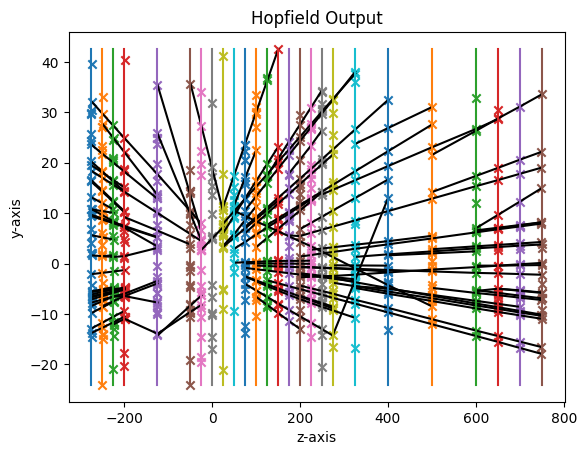

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_384

starting instance 91 out of 100

[INFO] Hopfield Networks initialized in 0 mins 2.78 seconds
energy: -374.62495453377096
energy: -413.5923150616533
energy: -401.11348544258647
energy: -367.336781380431
energy: -387.7057793221885
energy: -409.86490783526614
energy: -401.31840927370325
energy: -318.3690571896927
energy: -343.56887986230845
energy: -382.13230091674075
[HOPFIELD] converged network by below_mean after 1 mins 45.79 seconds; (energy: -379.96)
energy: -324.85028697308445
energy: -359.8158234577454
energy: -316.94217389769636
energy: -360.2034981726132
energy: -356.6746661047499
energy: -383.26633881461
energy: -397.6682777261166
energy: -281.2495243617911
energy: -366.026271154862
energy: -311.24183154099194
[HOPFIELD] converged network by below_mean after 1 mins 19.52 seconds; (energy: -345.79)
[INFO] tracks extracted in 0 mins 0.08 seconds


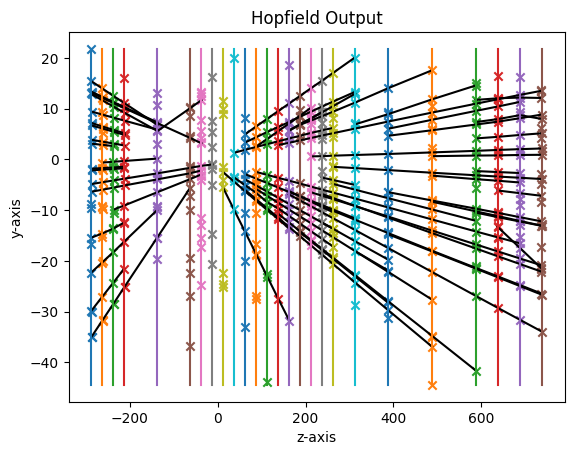

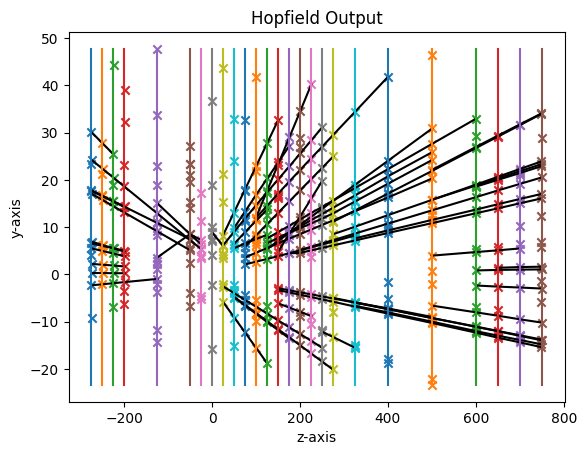

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_611

starting instance 92 out of 100

[INFO] Hopfield Networks initialized in 0 mins 8.14 seconds
energy: -482.4824097189946
energy: -482.76588522062207
energy: -495.0513719238894
energy: -439.5377520956547
energy: -480.99479771811906
energy: -456.70448299530665
energy: -502.0144993539867
energy: -431.3022896765016
energy: -468.6928178515441
energy: -471.13564075437273
[HOPFIELD] converged network by below_mean after 5 mins 52.61 seconds; (energy: -471.07)
energy: -475.78322069802084
energy: -442.21319250670086
energy: -510.7945330903977
energy: -457.4228576550232
energy: -375.38841676669733
energy: -447.49635561074325
energy: -433.38160656940033
energy: -465.9030769279916
energy: -470.9376038956463
energy: -399.1870557743135
[HOPFIELD] converged network by below_mean after 6 mins 17.34 seconds; (energy: -447.85)
[INFO] tracks extracted in 0 mins 0.20 seconds


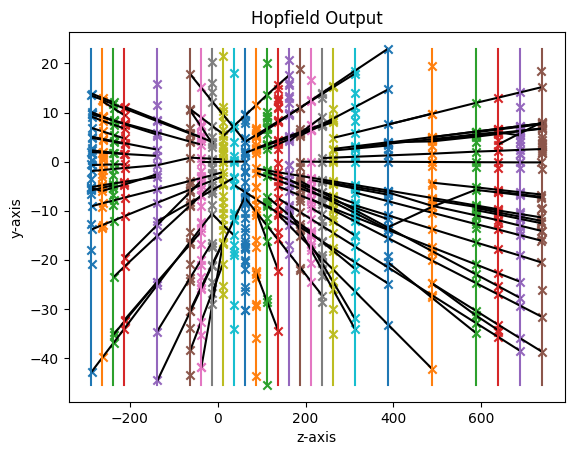

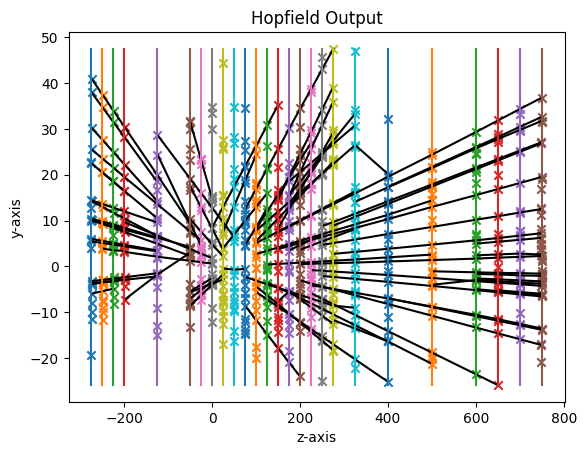

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_562
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_514

starting instance 93 out of 100

[INFO] Hopfield Networks initialized in 0 mins 1.77 seconds
energy: -309.6480333479775
energy: -276.17872294834535
energy: -304.2894939707984
energy: -315.2783870904112
energy: -305.3071869880585
energy: -326.4623725391686
energy: -290.87641345529863
energy: -285.1917153003273
energy: -295.6483349608733
energy: -280.79746413307555
[HOPFIELD] converged network by below_mean after 0 mins 49.05 seconds; (energy: -298.97)
energy: -335.3691978500501
energy: -367.2159815693599
energy: -377.5725585362047
energy: -318.6706249018742
energy: -410.7975308798529
energy: -328.3543405559955
energy: -416.8795065885828
energy: -410.11979438720346
energy: -343.91535869750163
energy: -426.88866834929837
[HOPFIELD] converge

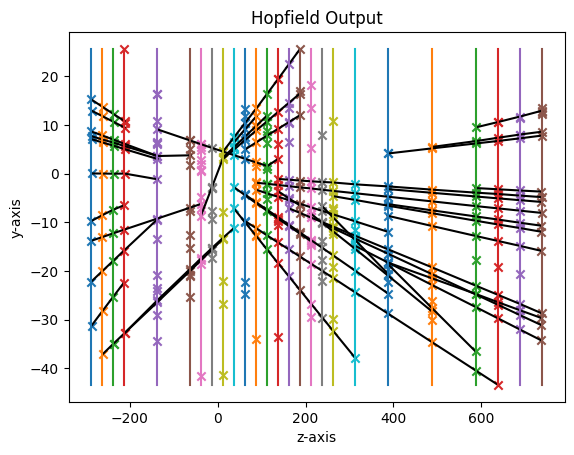

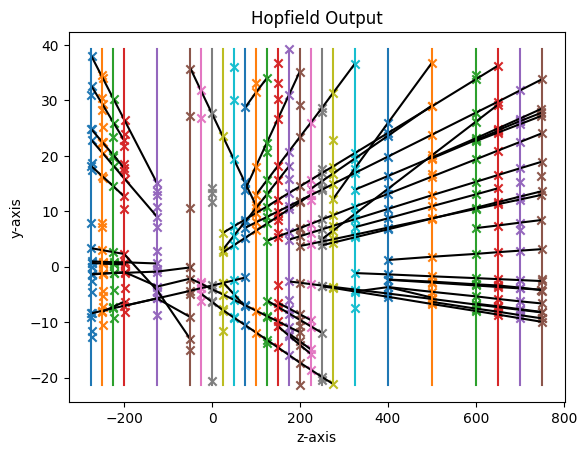

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_480
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_921
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_867
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_462
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_383
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_750
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_855
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_ev

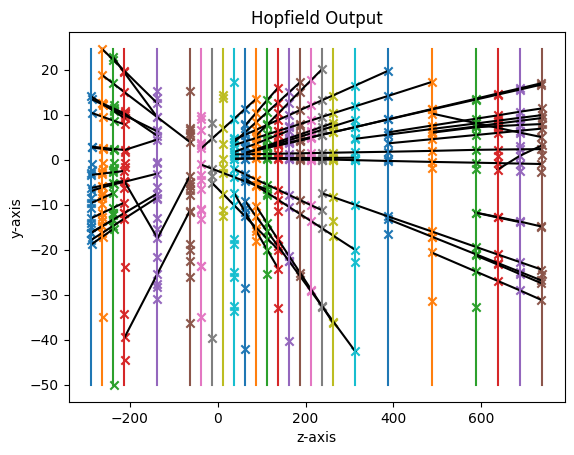

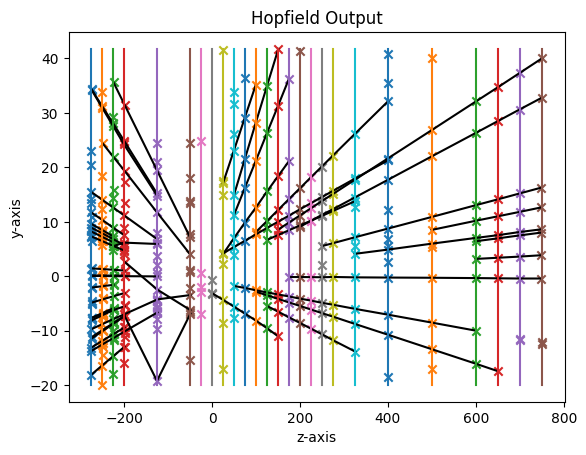

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_14

starting instance 95 out of 100

[INFO] Hopfield Networks initialized in 0 mins 3.64 seconds
energy: -297.52717098574874
energy: -318.6361196674331
energy: -316.79738725409806
energy: -289.63469310148537
energy: -285.13805209126997
energy: -283.67637371923644
energy: -323.28194796558233
energy: -285.44766521355047
energy: -317.9956693310494
energy: -354.1478122686074
[HOPFIELD] converged network by below_mean after 1 mins 8.78 seconds; (energy: -307.23)
energy: -397.89260234777186
energy: -376.3525210033263
energy: -311.86256987760567
energy: -317.6866471580385
energy: -312.7317250096032
energy: -351.7320901809507
energy: -298.38592015506606
energy: -375.20367677215455
energy: -322.2486347033001
energy: -372.25670158316956
[HOPFIELD] converged network by below_mean after 2 mins 12.88 seconds; (energy: -343.64)
[INFO] tracks extracted in 0 mins 0.09 seconds


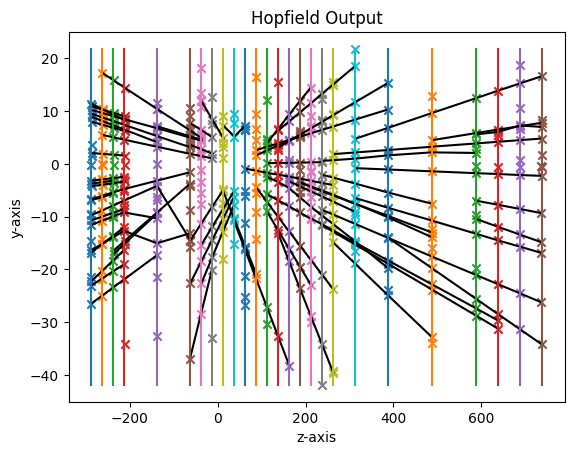

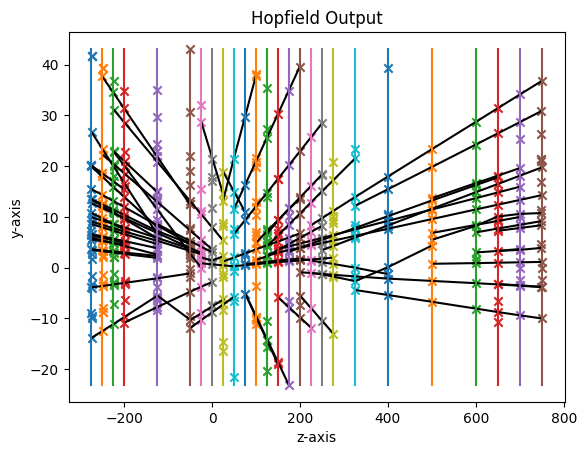

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_149
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_683

starting instance 96 out of 100

[INFO] Hopfield Networks initialized in 0 mins 9.97 seconds
energy: -514.7239055630537
energy: -513.7072485896214
energy: -552.6159624375902
energy: -457.36560098645117
energy: -566.9163344985249
energy: -532.3049417349566
energy: -484.5887804814188
energy: -566.2461345472459
energy: -530.6400600411763
energy: -508.872049086427
[HOPFIELD] converged network by below_mean after 9 mins 53.03 seconds; (energy: -522.80)
energy: -482.3150713107654
energy: -434.42526968101885
energy: -467.11739936886175
energy: -441.8357730817595
energy: -480.6690036838031
energy: -499.91144308204605
energy: -475.3673946903239
energy: -446.79323675987064
energy: -510.89117770071243
energy: -501.97851309163906
[HOPFIELD] converge

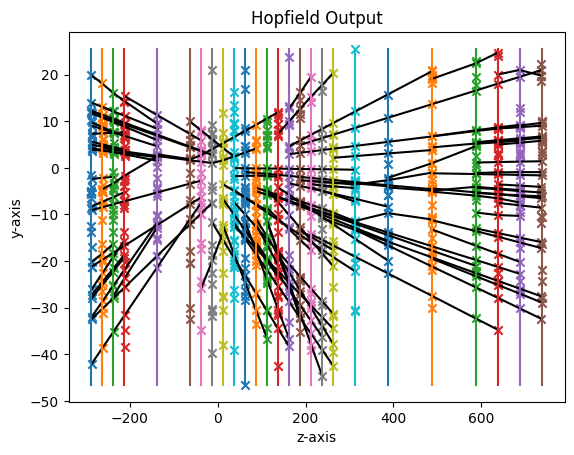

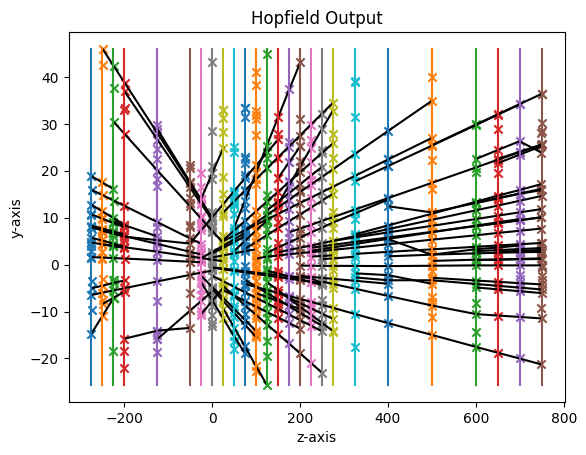

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_292

starting instance 97 out of 100

[INFO] Hopfield Networks initialized in 0 mins 2.96 seconds
energy: -251.39289378025617
energy: -234.22671187471315
energy: -219.1571507812037
energy: -237.2497965142709
energy: -241.00737719880257
energy: -242.10782226160342
energy: -227.06040747578183
energy: -243.77628476659052
energy: -238.17609446458954
energy: -258.7553611472113
[HOPFIELD] converged network by below_mean after 0 mins 29.31 seconds; (energy: -239.29)
energy: -382.09823664437323
energy: -398.21416105133807
energy: -366.4212134029923
energy: -415.67907600993425
energy: -398.06687619260526
energy: -398.8488156317168
energy: -405.5884139380354
energy: -376.2618453819256
energy: -426.83787983157936
energy: -386.93828924771356
[HOPFIELD] converged network by below_mean after 4 mins 16.94 seconds; (energy: -395.50)
[INFO] tracks extracted in 0 mins 0.08 seconds


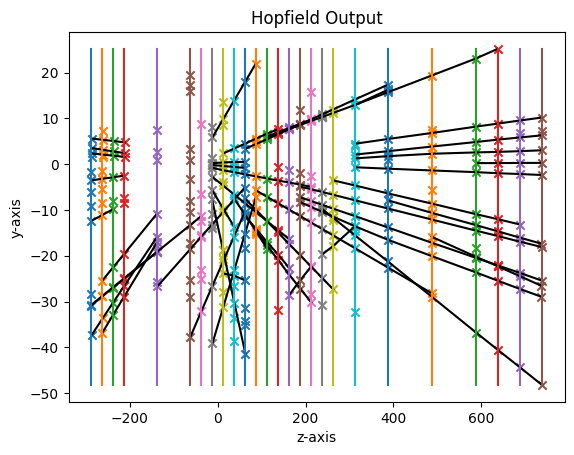

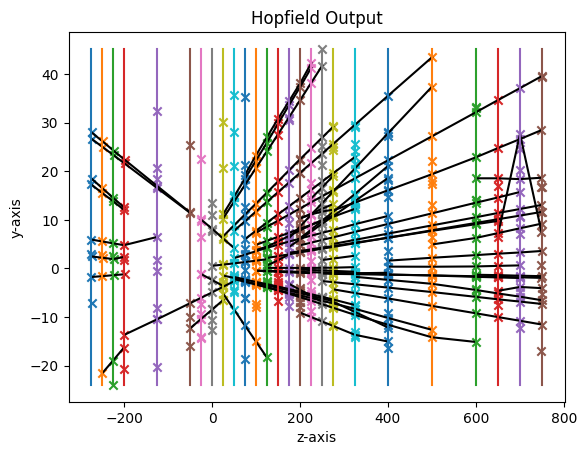

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_386
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_591
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_664

starting instance 98 out of 100

[INFO] Hopfield Networks initialized in 0 mins 7.88 seconds
energy: -441.3670192221357
energy: -488.3632216475946
energy: -447.31355278097806
energy: -454.7023115170005
energy: -452.02138409480875
energy: -413.0541801219868
energy: -425.30229007394036
energy: -442.5176199854527
energy: -457.87343688810404
energy: -448.02667094214274
[HOPFIELD] converged network by below_mean after 3 mins 27.84 seconds; (energy: -447.05)
energy: -525.8168072375677
energy: -460.57305161873603
energy: -427.5247591410453
energy: -436.92002508140536
energy: -554.8588769832611
energy: -533.2195568472287


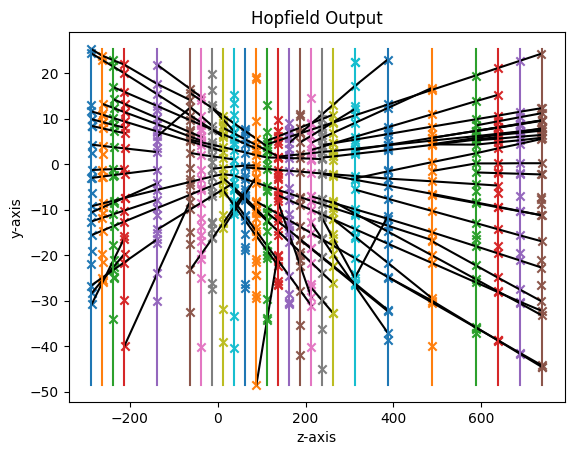

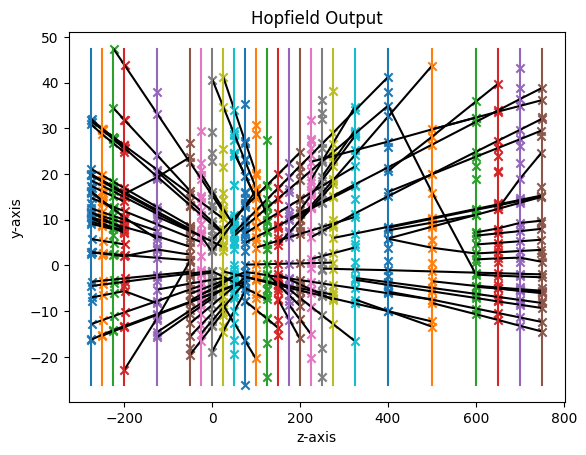

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_905

starting instance 99 out of 100

[INFO] Hopfield Networks initialized in 0 mins 4.34 seconds
energy: -391.7913905383044
energy: -349.99848966731577
energy: -435.77991442377174
energy: -504.02303436501
energy: -411.7397571739512
energy: -382.28859398012014
energy: -442.74321374431236
energy: -489.5267295531725
energy: -441.41645958645614
energy: -415.07180593303957
[HOPFIELD] converged network by below_mean after 3 mins 39.49 seconds; (energy: -426.44)
energy: -362.87493024814177
energy: -389.4409584354771
energy: -326.2566676795784
energy: -352.2761711923903
energy: -293.84516648709314
energy: -350.58995379671484
energy: -297.0907320919964
energy: -337.5855384912542
energy: -347.04141202287417
energy: -313.7020507581824
[HOPFIELD] converged network by below_mean after 3 mins 6.56 seconds; (energy: -337.07)
[INFO] tracks extracted in 0 mins 0.11 seconds


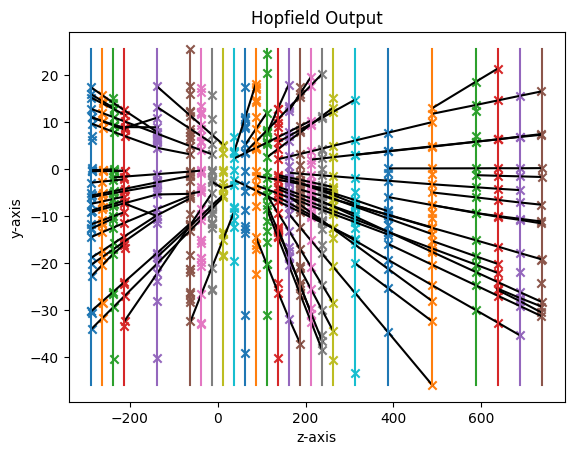

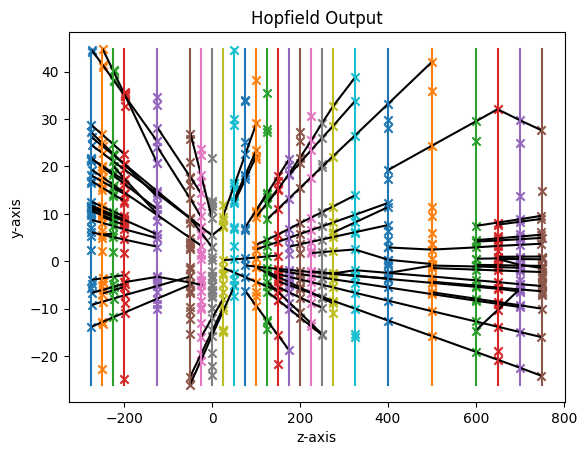

c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/algorithms/experiments/aurelie_experiments_01_02.txt


In [16]:
  
    ###################################################################
save_experiment(
        "aurelie_experiments_01_02",
        "B equal 100*T",
        "Best Configuration Large 100 event Test with 0.05 Pruning Threshold",
        parameters,
        "/datasets/minibias/velo_event_",
        100,
    )
exit()

> What is running here is the "save_experiment" fct, 
which runs the "evaluate_events, 
which runs the Hopfield class

In [17]:
#    modules, tracks = load_instance(r"C:\Users\aurel\Documents\Maastricht University\Thesis\Code_Thesis\algorithms\test.txt", plot_events=True)
#    modules, tracks = prepare_instance(
#        num_modules=10, plot_events=True, num_tracks=20, save_to_file="test.txt")
#    evaluate_events(
#         project_root + "/events/minibias/velo_event_",
#         parameters,
#         nr_events=1,
#         plot_event=True,
#     )

#    my_instance = Hopfield(modules=modules, parameters=parameters)
    # for i in range(len(my_instance.W)):
    #     sns.heatmap(my_instance.W[i])
    #     plt.show()
    # for i in range(3):
    #     print(my_instance.N_info[:,:,i])

    # print(np.round(my_instance.N, 2))
#    np.random.seed(20)
#    my_instance.converge()

    # plt.plot(my_instance.energies)
    # plt.show()

#    my_instance.bootstrap_converge(bootstraps=5, method="mean")
#    print("Converged:", my_instance.energies[-1])
#    my_instance.tracks()
#    my_instance.plot_network_results(show_states=True)

#    my_instance.mark_bifurcation()
#    my_instance.full_tracks()
#    my_instance.plot_network_results(show_states=False)
    # my_instance.tracks()
    # my_instance.plot_network_results(show_states=True)

    # true_instance = Hopfield(modules=modules, parameters=parameters, tracks=tracks)
    # print("True:", true_instance.energy())
    # true_instance.tracks()
    # true_instance.plot_network_results()

    # THIS CODE IS FOR COMPUTING THE MSES FOR DIFFERENT BOOTSTRAPS

    # total_mse = []
    # for i in range(50):
    #     mses = []
    #     for j in range(ceil(50/(i+1))):
    #         instance = Hopfield(modules=modules, parameters=parameters)
    #         instance.bootstrap_converge(bootstraps=i+1)
    #         mses.append(mse(instance, tracks))
    #     total_mse.append(sum(mses)/len(mses))
    #
    # plt.plot(total_mse)
    # plt.show()

: 